In [1]:
# import packages
import os, sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
from collections import Counter
import warnings
warnings.filterwarnings("ignore")
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.metrics import f1_score, roc_auc_score, confusion_matrix, plot_confusion_matrix, accuracy_score
from simpletransformers.classification import ClassificationModel

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
## Read dataframe
df = pd.read_excel("Training_Data_Set_for_Data_Science_Case_Study.xlsx")
df.head()

,Company Name,Business Description,Industry Classification Tag
0,"ADSOUTH PARTNERS, INC.","Adsouth Partners, Inc. provides advertising ag...",Advertising
1,"Artec Global Media, Inc.","Artec Global Media, Inc., formerly Artec Consu...",Advertising
2,Betawave Corp.,Betawave Corporation provides online marketing...,Advertising
3,BOSTON OMAHA Corp,Boston Omaha Corporation is engaged in the bus...,Advertising
4,Bright Mountain Media Inc,"Bright Mountain Media, Inc. is a digital media...",Advertising


In [3]:
print("Shape is:")
print(df.shape)

print("Missing values:")
print(df.isnull().sum())

Shape is:
(6045, 3)
Missing values:
Company Name                    0
Business Description           23
Industry Classification Tag     0
dtype: int64


In [4]:
## Drop rows with missing values
df.dropna(inplace=True)
print(df.shape)

## Unique company names
print(df["Company Name"].nunique())

(6022, 3)
5970


**NOTE**: Since number of rows isn't equal to the number of unique Company Names, there are duplicate entries of company names. We need to check what are the names of these companies and whether their Business Description and Industry Classification Tag columns match.

In [5]:
## List of companies with duplicate entries
pivot = df.pivot_table(index=['Company Name'], aggfunc='size')
print(pivot[pivot > 1])

## Duplicate companies
duplicate_cos = (pivot[pivot > 1]).index
print(duplicate_cos)

Company Name
AMERICAN EXPRESS CO                  2
ANADARKO PETROLEUM CORP              2
ANTERO RESOURCES Corp                2
Academy Metals Inc                   2
Adept Technology Group PLC           2
Aimia Inc                            3
Atex Resources Inc                   2
Bonava AB (publ)                     2
Brattle Street Investment Corp       2
Cimarex Resolute LLC                 2
Deutsche Telekom AG                  2
Eezy Plc                             2
Elixxer Ltd                          2
Epiroc AB                            2
Fng NV                               2
GMP Capital Inc.                     2
GRACO INC                            2
Gaming Innovation Group Inc          2
Global Tech Industries Group Inc     2
Gold Terra Resource Corp             2
Golden Sky Minerals Corp             2
Guardian Capital Group Ltd.          2
Jaguar Financial Corp                2
Madison Pacific Properties Inc.      2
Miller Industries, Inc.              2
Newmont Corp

In [6]:
## Drop duplicate rows
df.drop_duplicates(inplace=True)

## New shape
print(df.shape)

## Check if "Business Description" & "Industry Classification Tag" matches for duplicate companies
for company in duplicate_cos:
    business_desc = df[df["Company Name"]==company]["Business Description"].values
    tags = df[df["Company Name"]==company]["Industry Classification Tag"].values
    if len(set(business_desc)) != 1:
        print("Business Descriptions don't match for", company)
        print("="*100)
    if len(set(tags)) != 1:
        print("Tags don't match for", company)
        print("="*100)

(5972, 3)
Business Descriptions don't match for Aimia Inc
Business Descriptions don't match for Miller Industries, Inc.
Tags don't match for Miller Industries, Inc.


**NOTE**: Only two companies have duplicate entries now. Out of them, Aimia Inc has different Business Description but Industry Classification Tag is the same. But both these column values are different for Miller Industries, Inc.. Lets keep them intact and proceed to EDA. 

In [7]:
## Number of unique "Industry Classification Tag" values
print(df["Industry Classification Tag"].nunique())

62


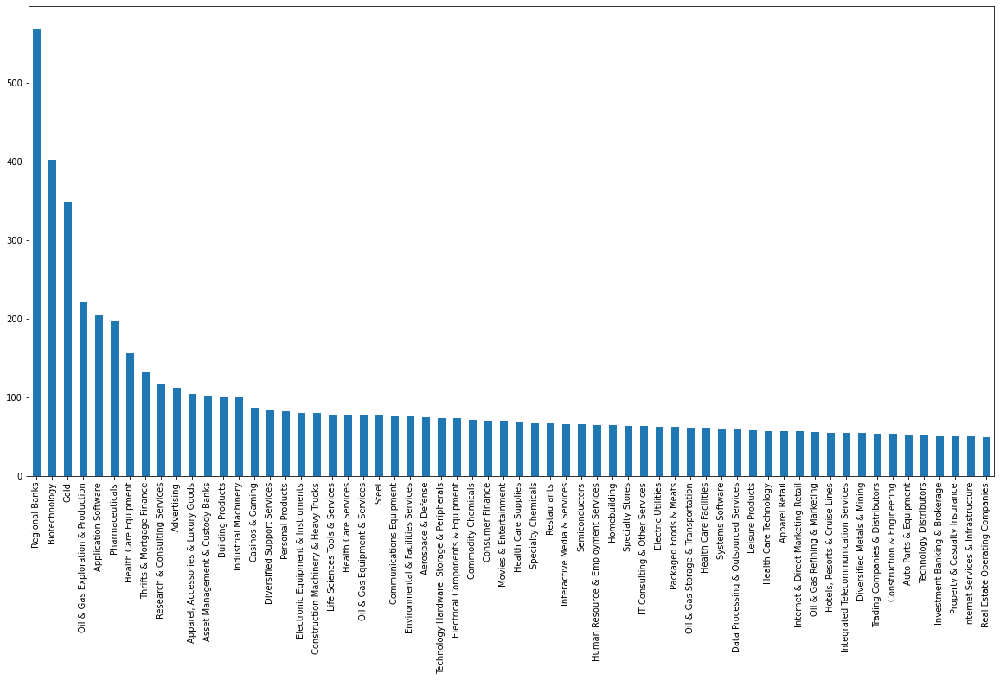

In [8]:
## Bar chart of tag distribution
plt.figure(figsize=(20,10))
df["Industry Classification Tag"].value_counts().plot(kind="bar")
plt.show()

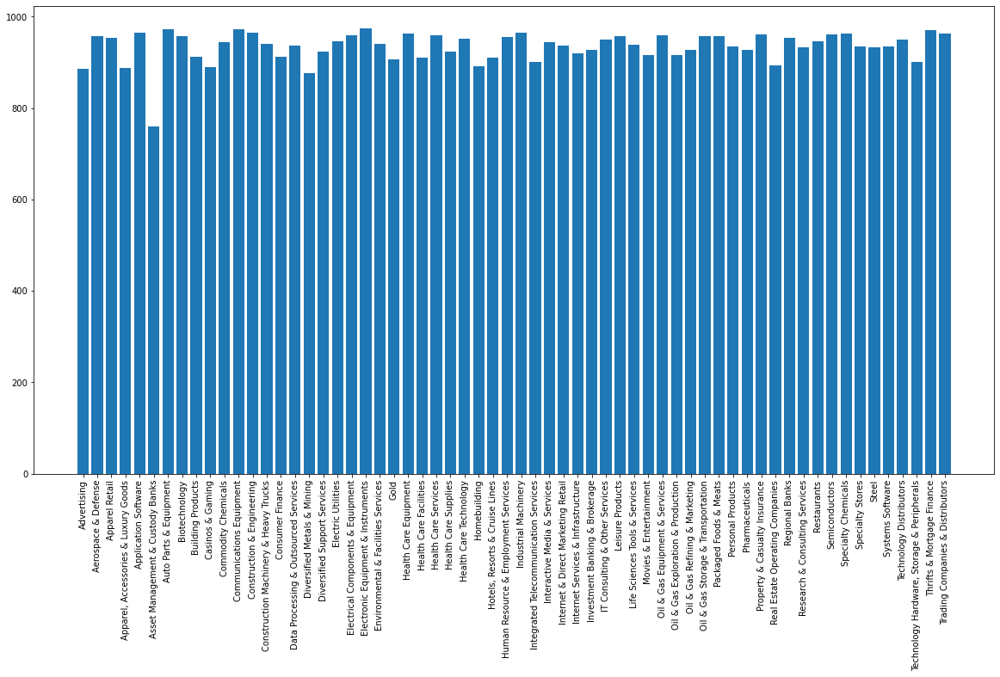

In [9]:
## Median number of words in "Business Description" for every category

median_words = {}
tags = df["Industry Classification Tag"].unique()
for tag in tags:
    business_desc = df[df["Industry Classification Tag"]==tag]["Business Description"].values
    median_len = np.median([len(desc) for desc in business_desc])
    median_words[tag] = median_len
    
plt.figure(figsize=(20,10))
plt.bar(*zip(*median_words.items()))
plt.xticks(rotation=90)
plt.show()

There are 5101738 words in the combination of all Business Descriptions.


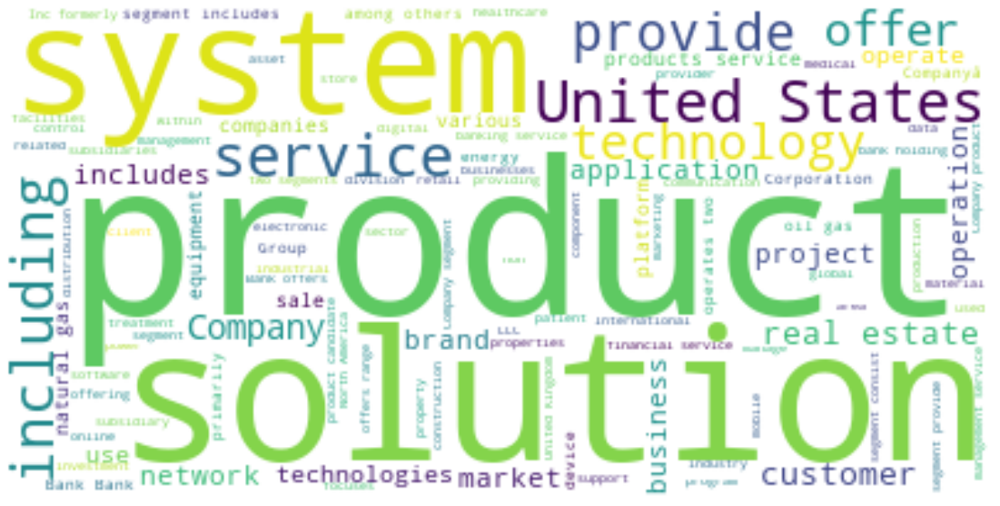

In [10]:
## Words occuring across the whole column of "Business Description"

text = " ".join(desc for desc in df["Business Description"].values)
print ("There are {} words in the combination of all Business Descriptions.".format(len(text)))

# Create stopword list:
stopwords = set(STOPWORDS)
stopwords.update(["As", "as", "and", "And", "The", "the", "include", "of", "Of", "company", "Company",
                 "in", "In", "to", "To", "it", "It", "well", "Well", "Include", "has", "Has", "Located",
                 "is", "Is", "which", "Which", "through", "on", "On", "based", "it", "It", "located",
                 "engaged", "also"])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(text)

# Display the generated image
plt.figure(figsize=(20,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

WORDCLOUD for Advertising


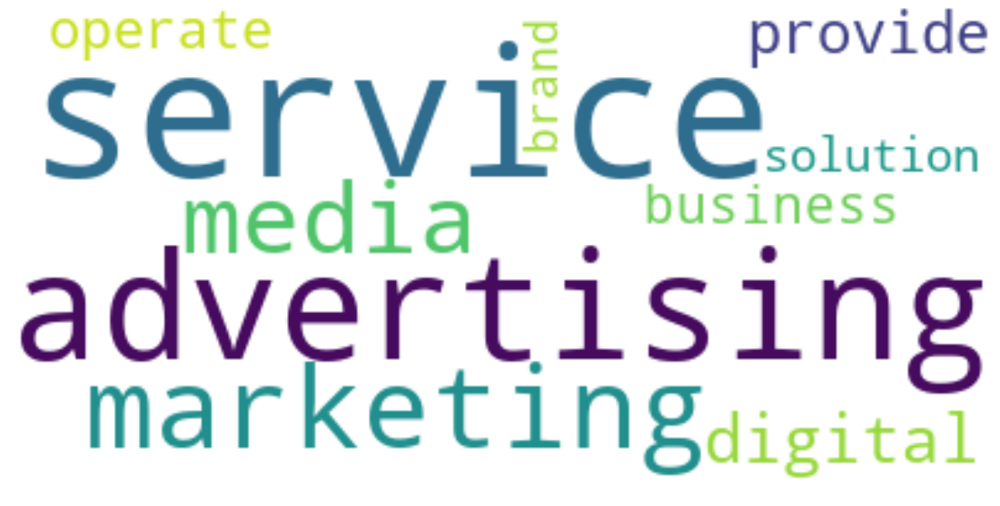

WORDCLOUD for Aerospace & Defense


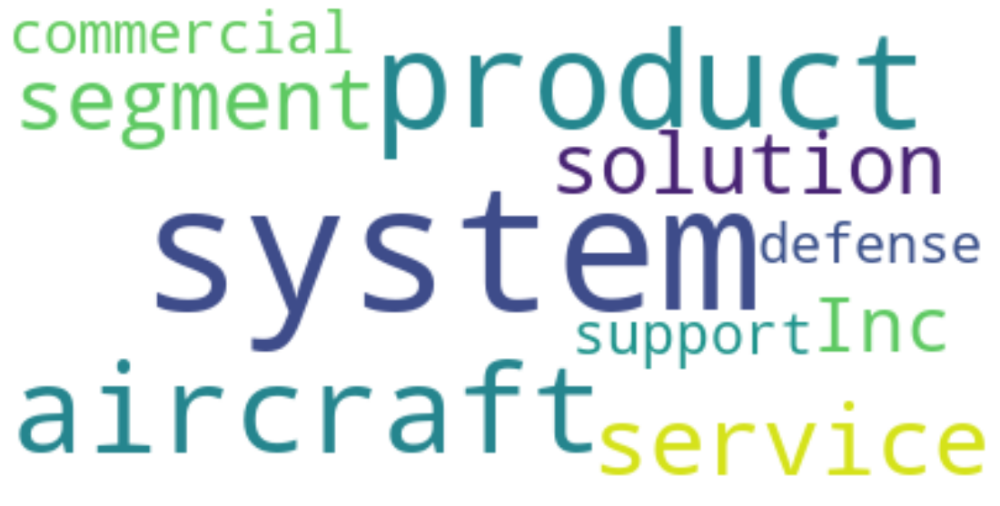

WORDCLOUD for Apparel Retail


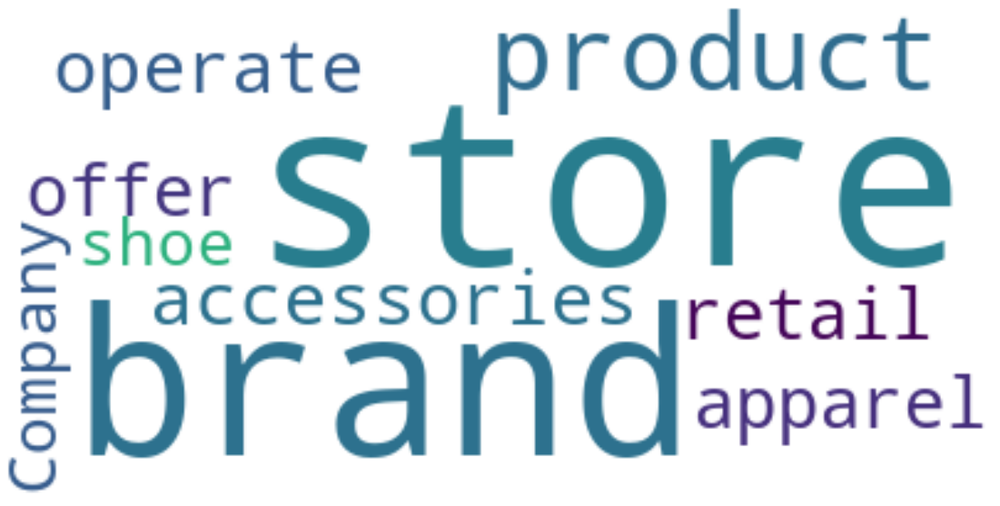

WORDCLOUD for Apparel, Accessories & Luxury Goods


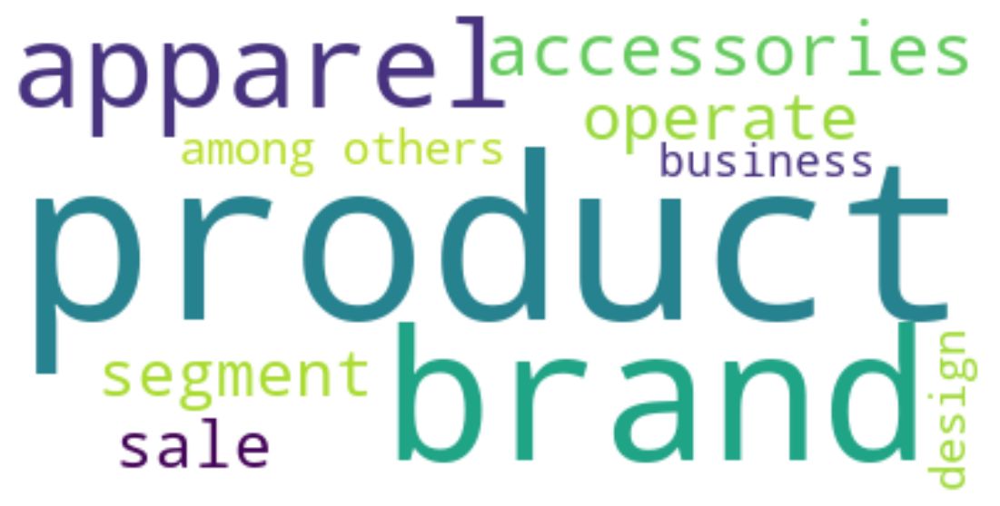

WORDCLOUD for Application Software


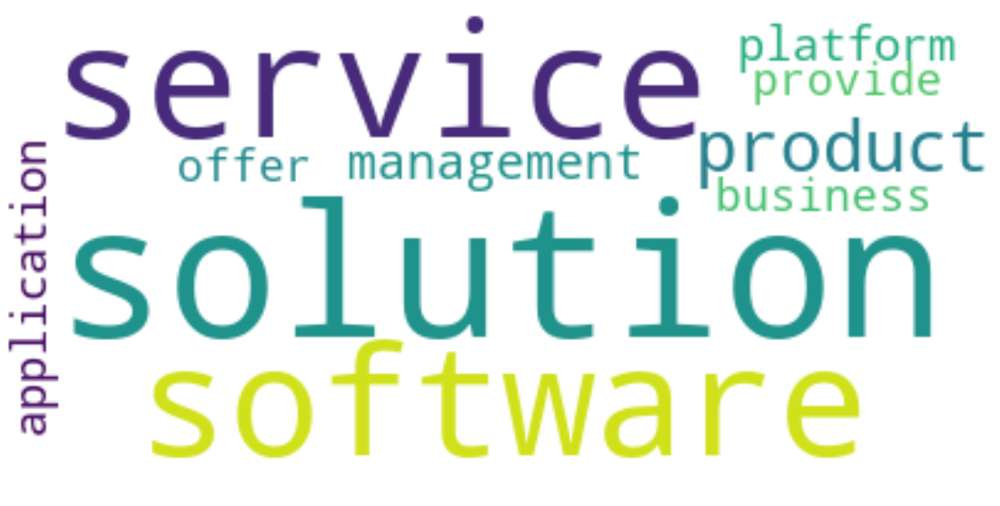

WORDCLOUD for Asset Management & Custody Banks


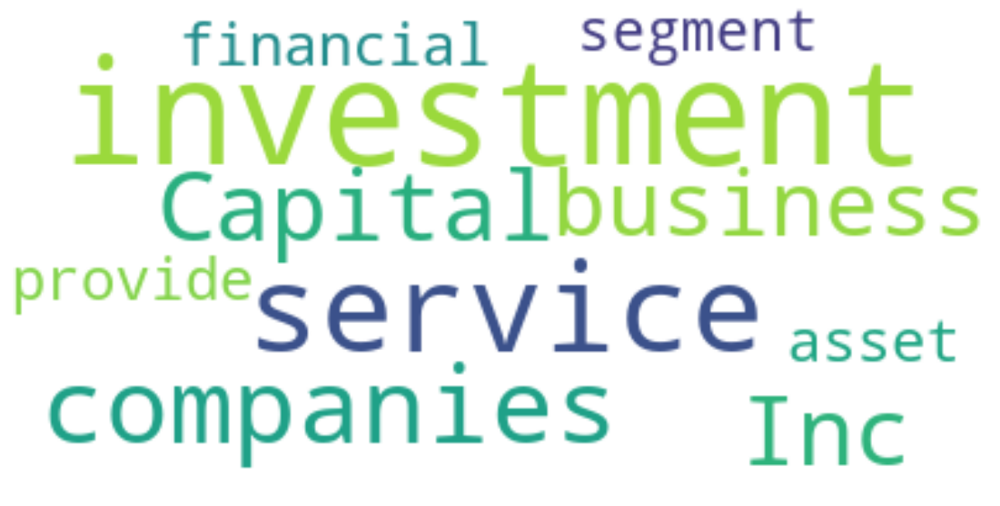

WORDCLOUD for Auto Parts & Equipment


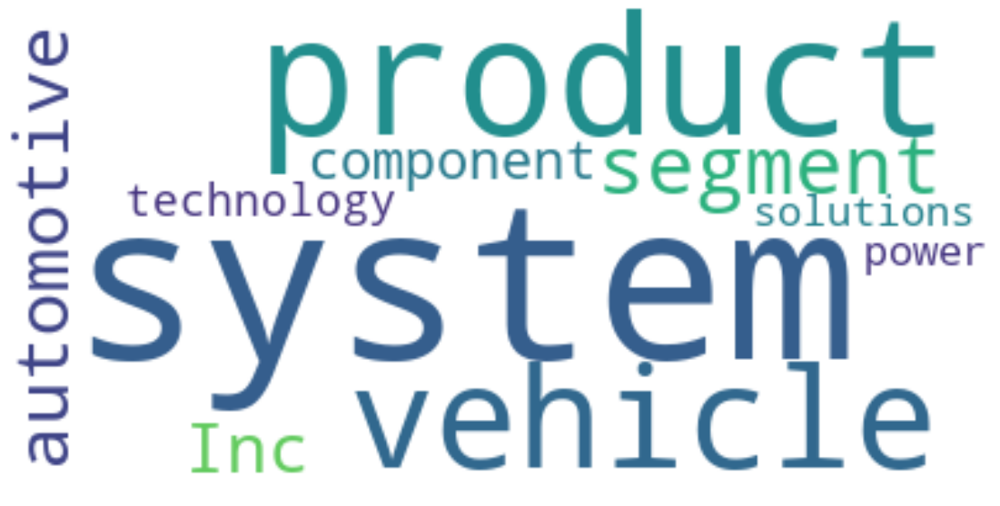

WORDCLOUD for Biotechnology


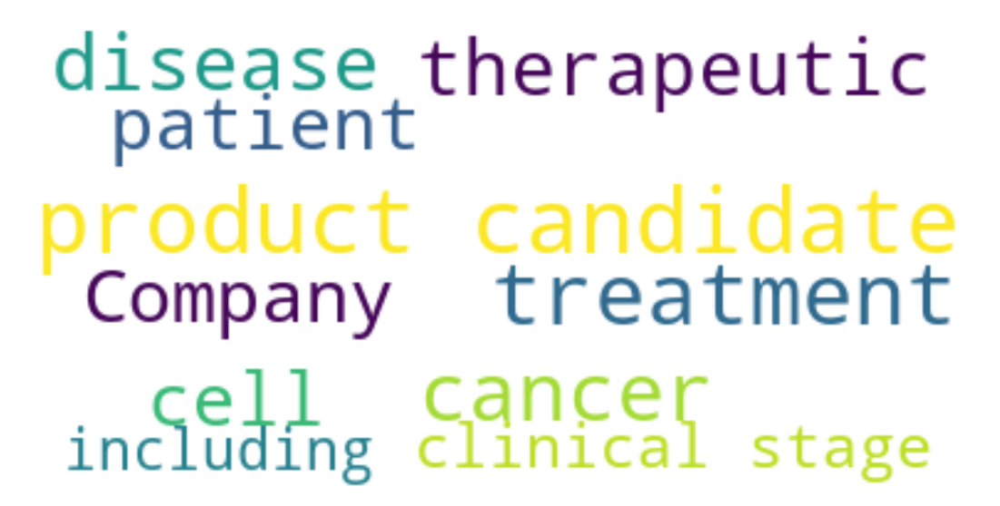

WORDCLOUD for Building Products


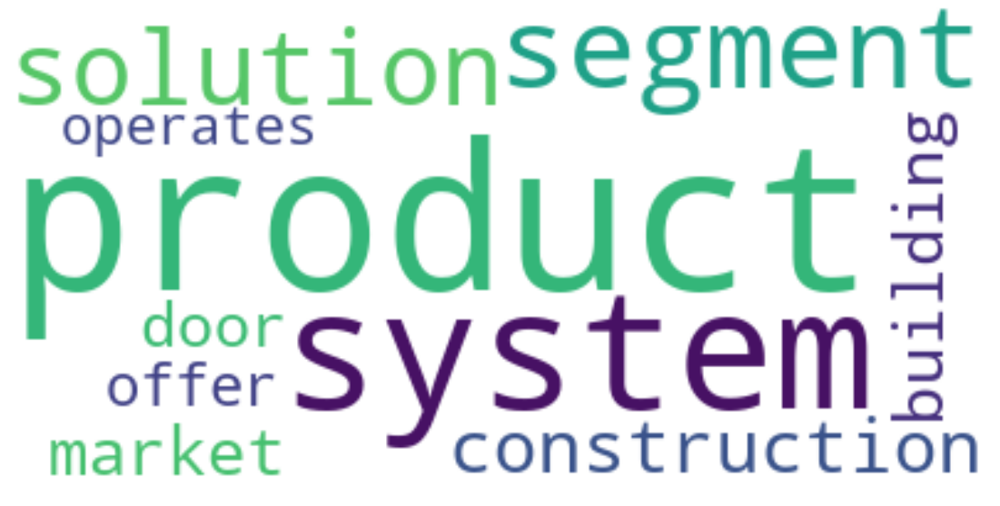

WORDCLOUD for Casinos & Gaming


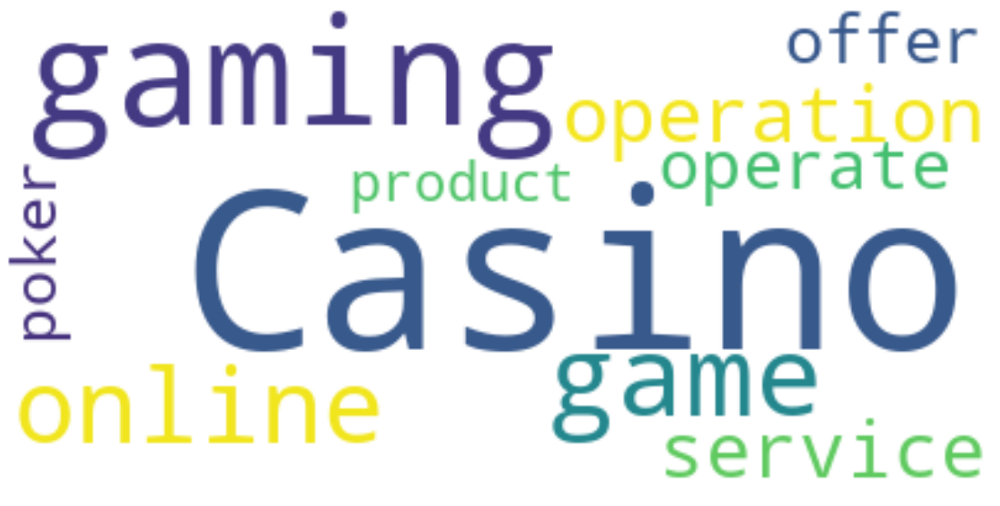

WORDCLOUD for Commodity Chemicals


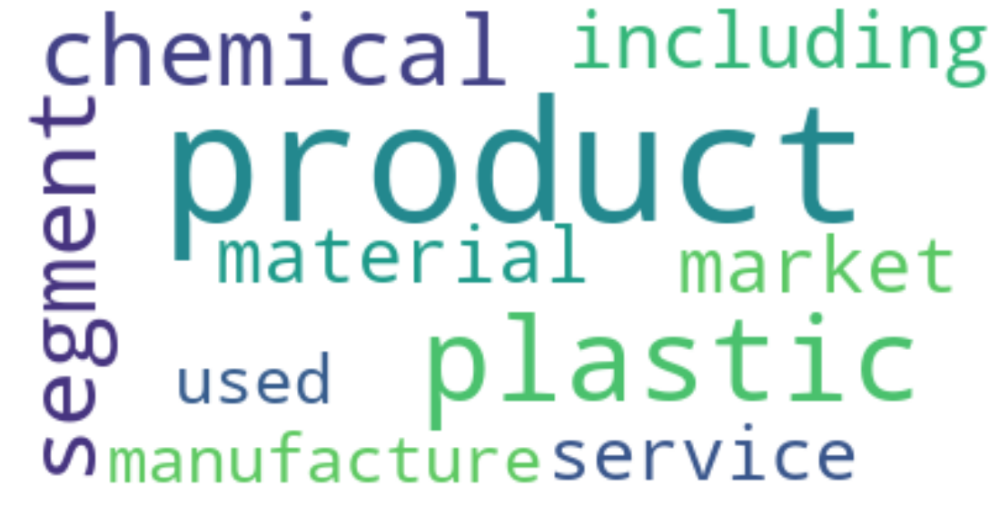

WORDCLOUD for Communications Equipment


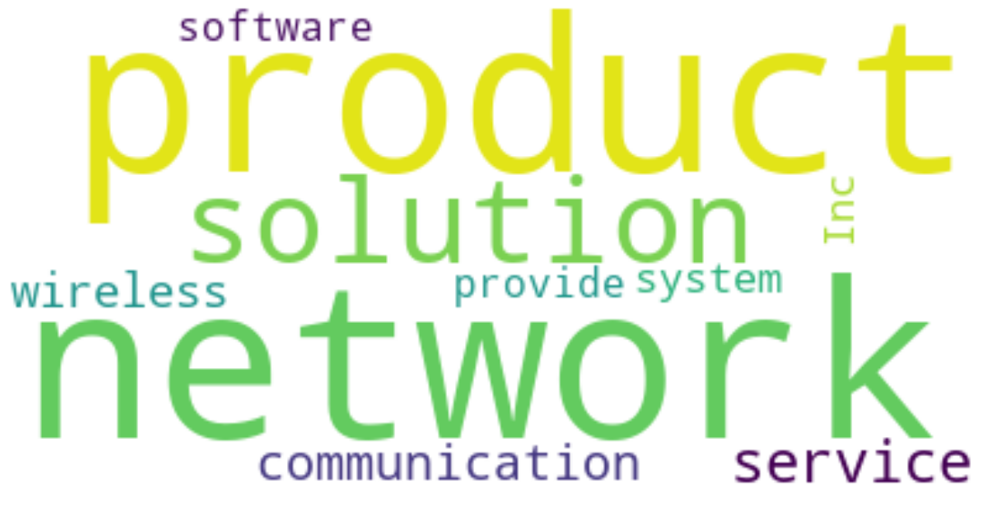

WORDCLOUD for Construction & Engineering


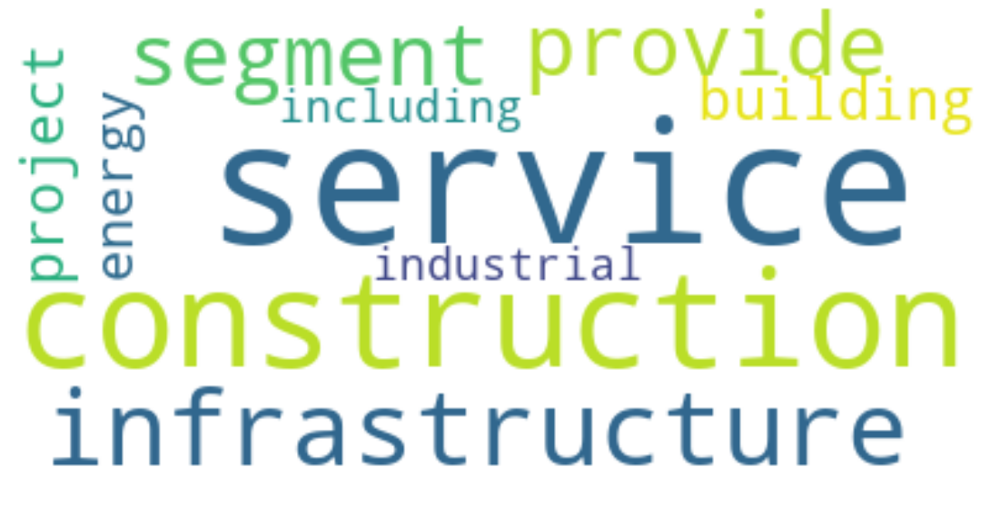

WORDCLOUD for Construction Machinery & Heavy Trucks


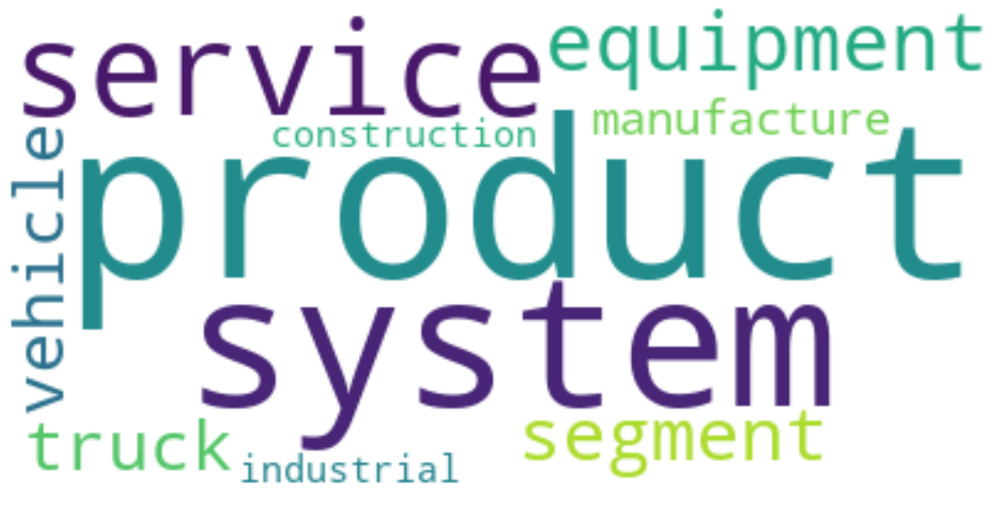

WORDCLOUD for Consumer Finance


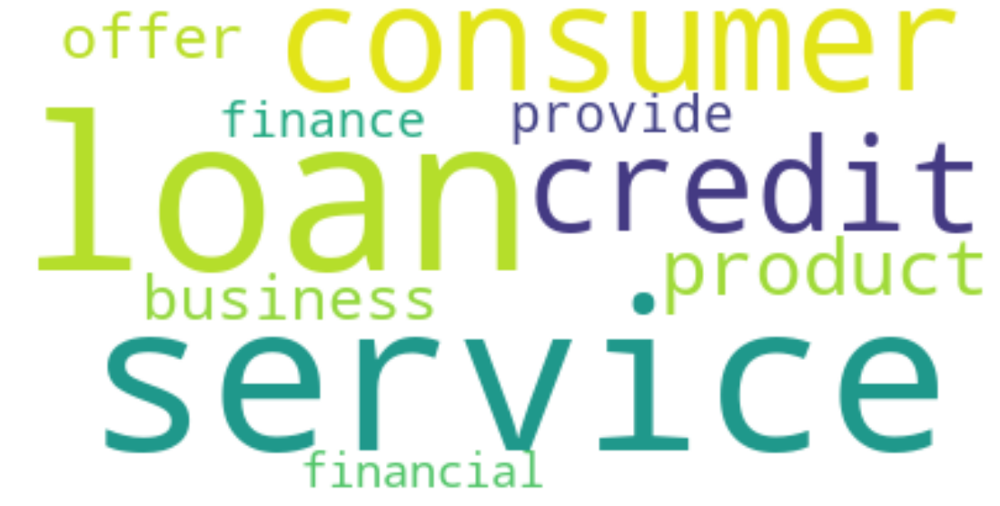

WORDCLOUD for Data Processing & Outsourced Services


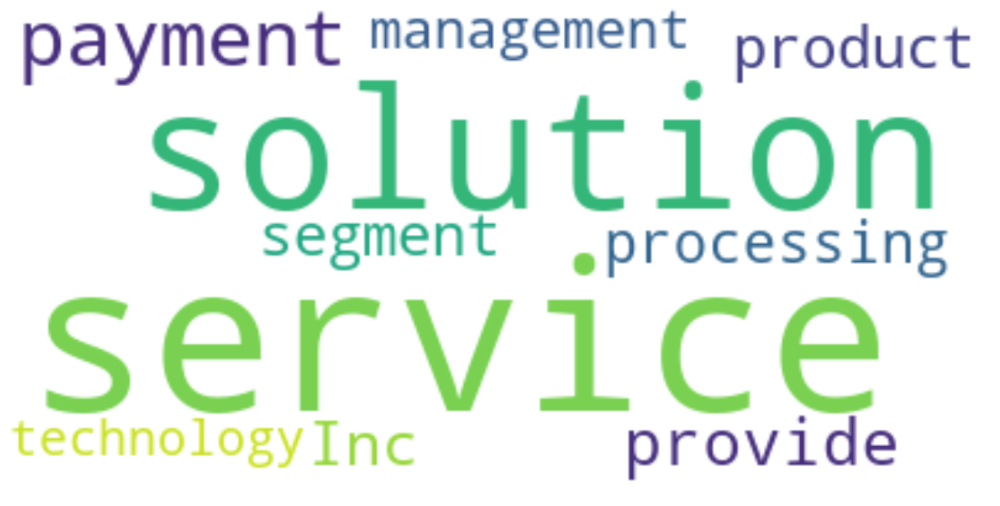

WORDCLOUD for Diversified Metals & Mining


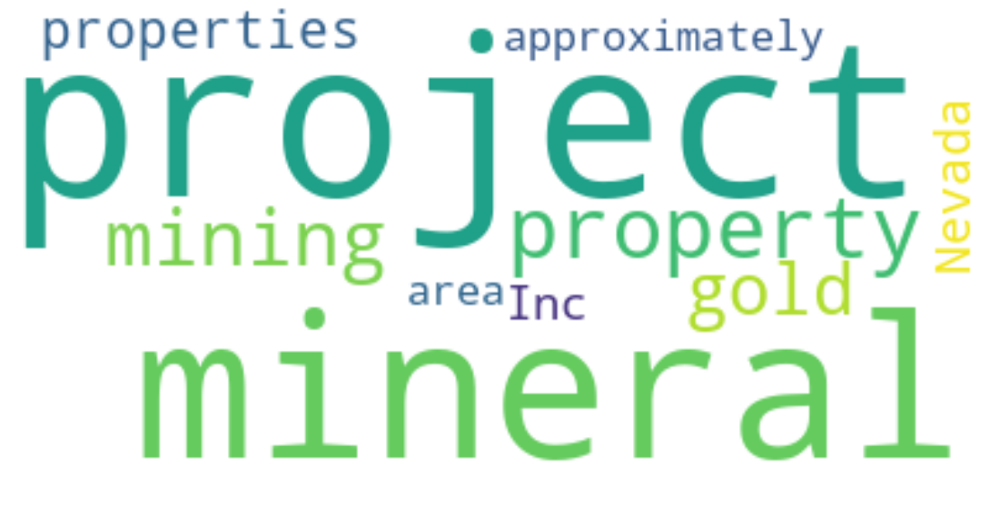

WORDCLOUD for Diversified Support Services


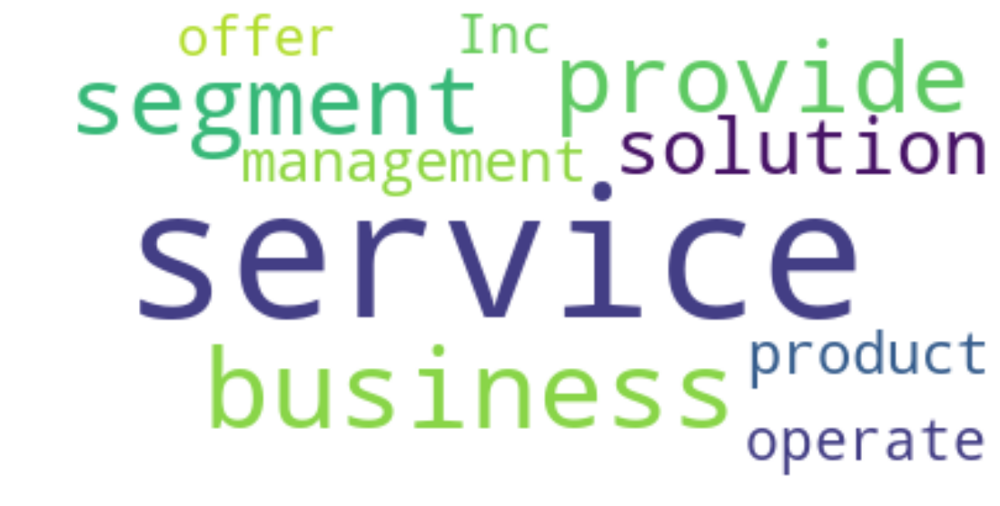

WORDCLOUD for Electric Utilities


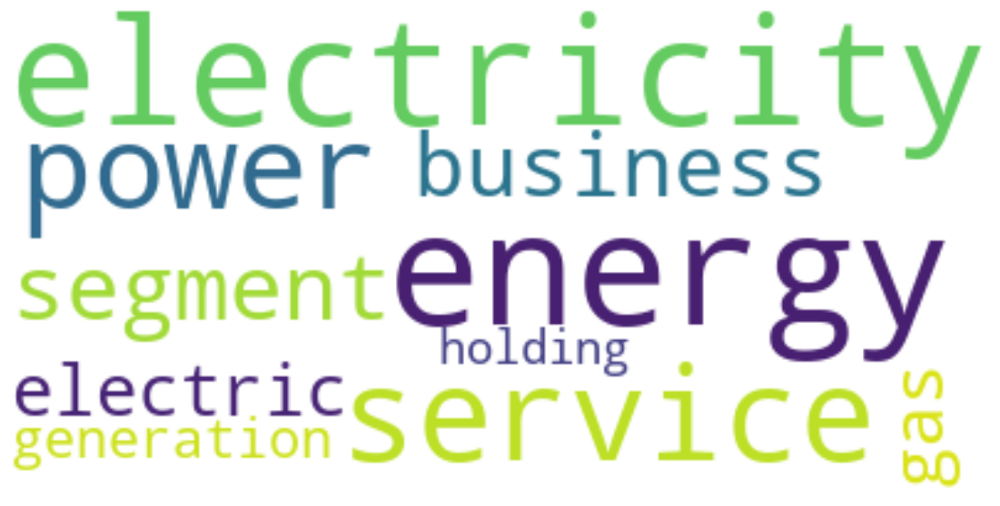

WORDCLOUD for Electrical Components & Equipment


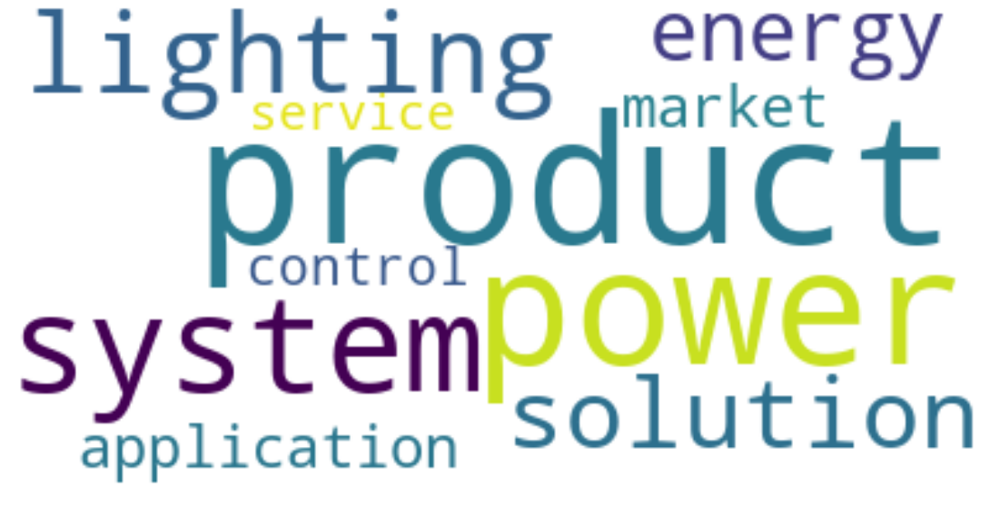

WORDCLOUD for Electronic Equipment & Instruments


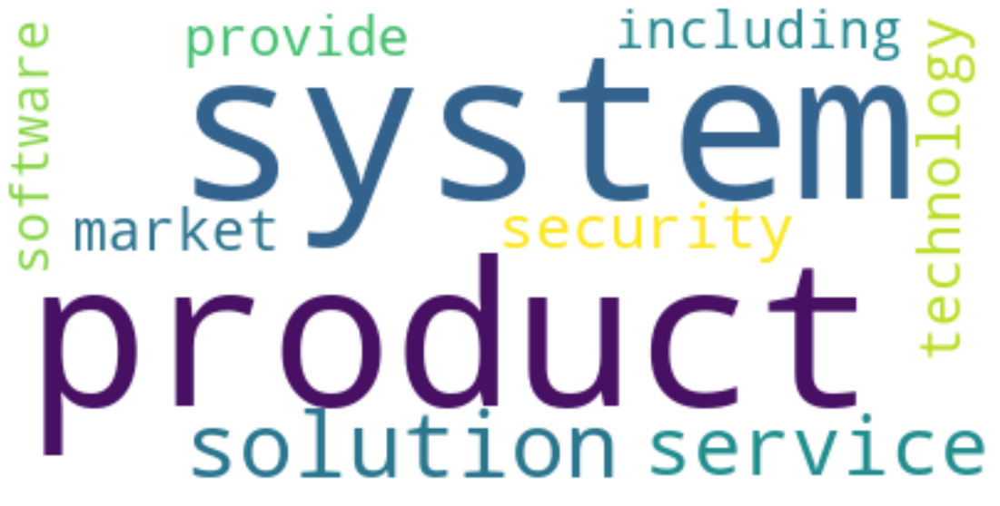

WORDCLOUD for Environmental & Facilities Services


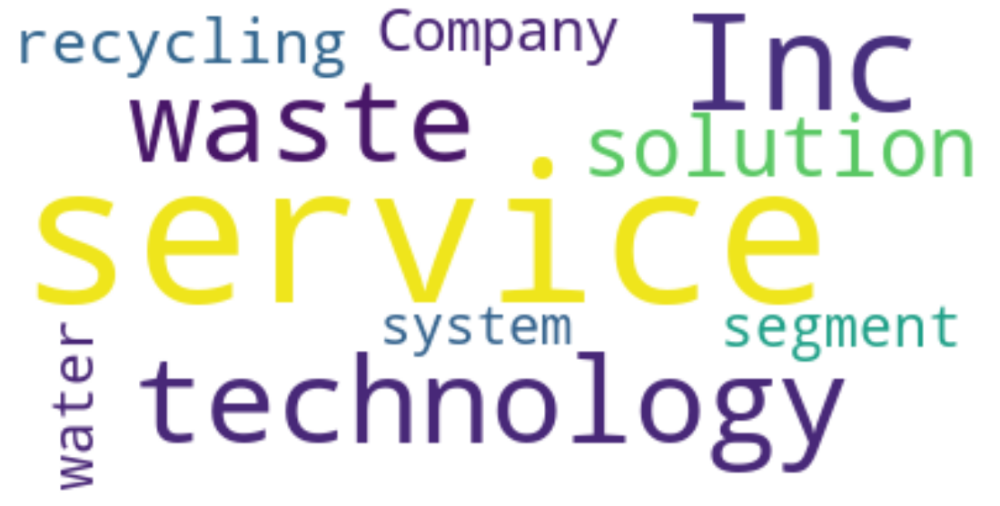

WORDCLOUD for Gold


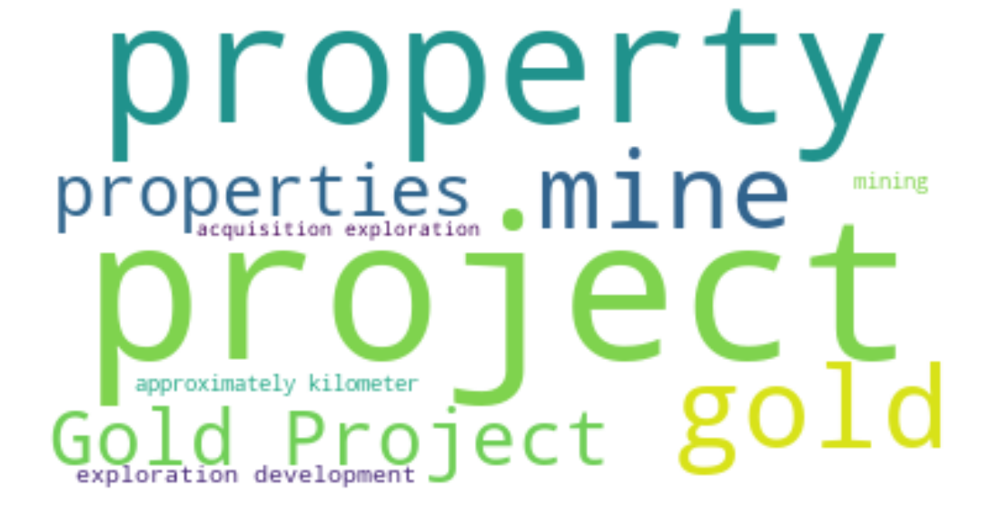

WORDCLOUD for Health Care Equipment


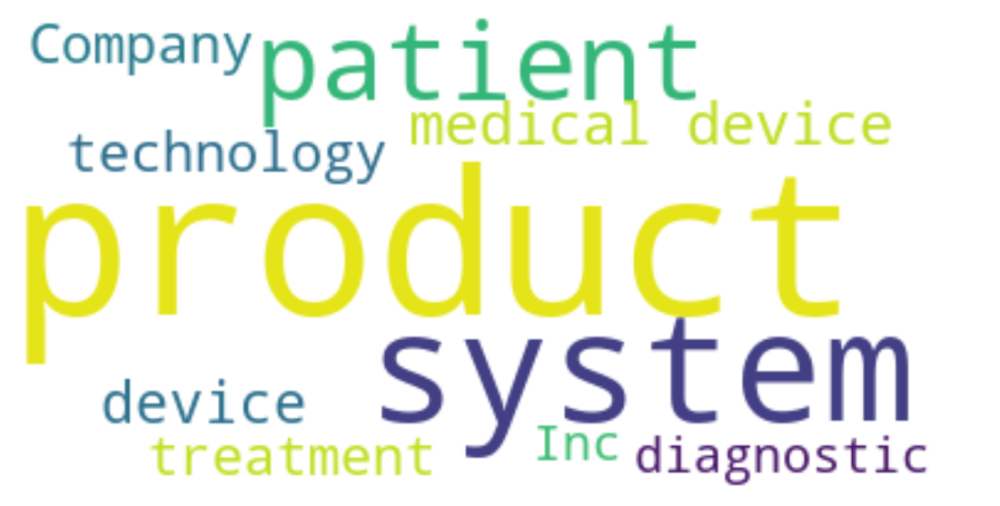

WORDCLOUD for Health Care Facilities


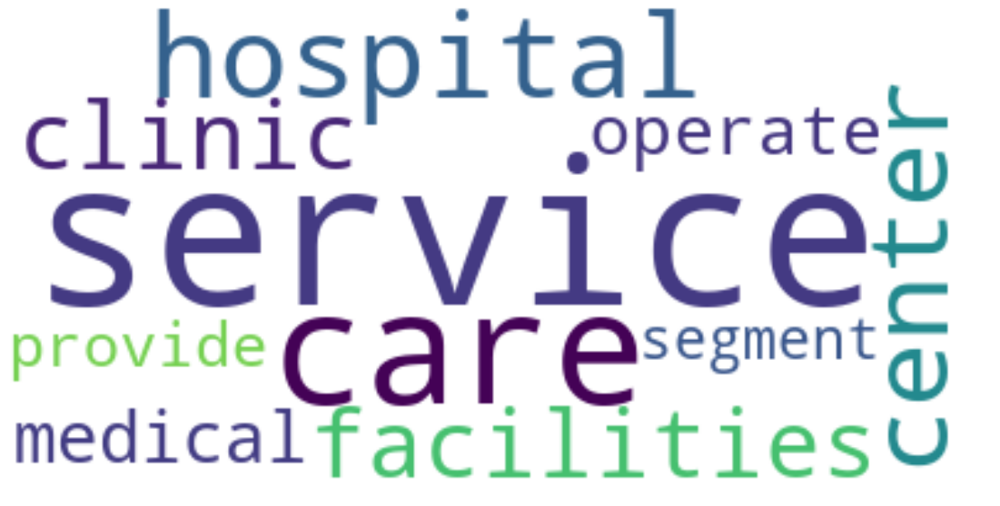

WORDCLOUD for Health Care Services


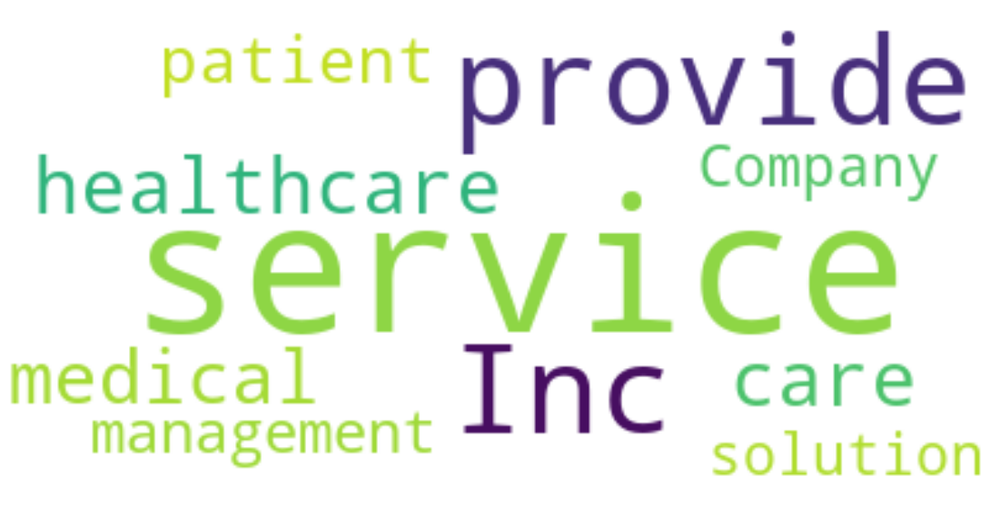

WORDCLOUD for Health Care Supplies


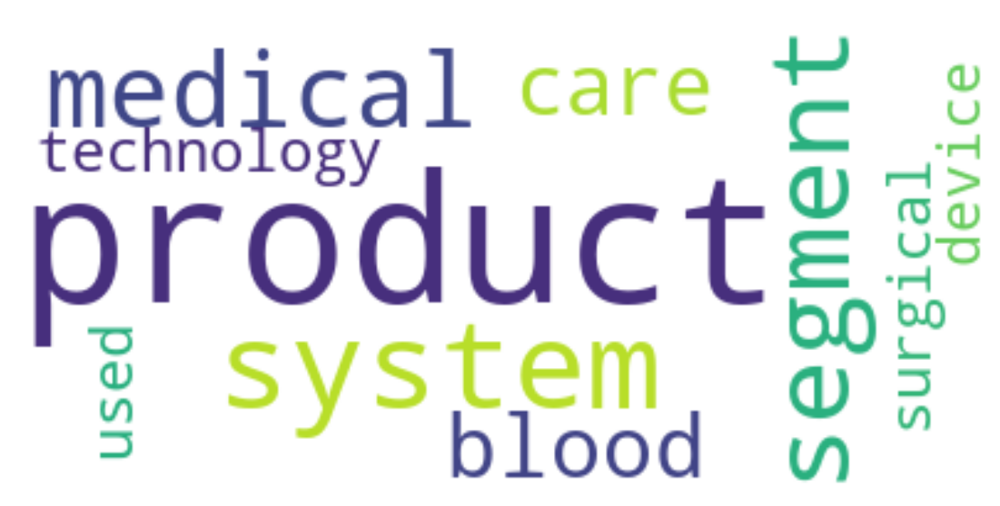

WORDCLOUD for Health Care Technology


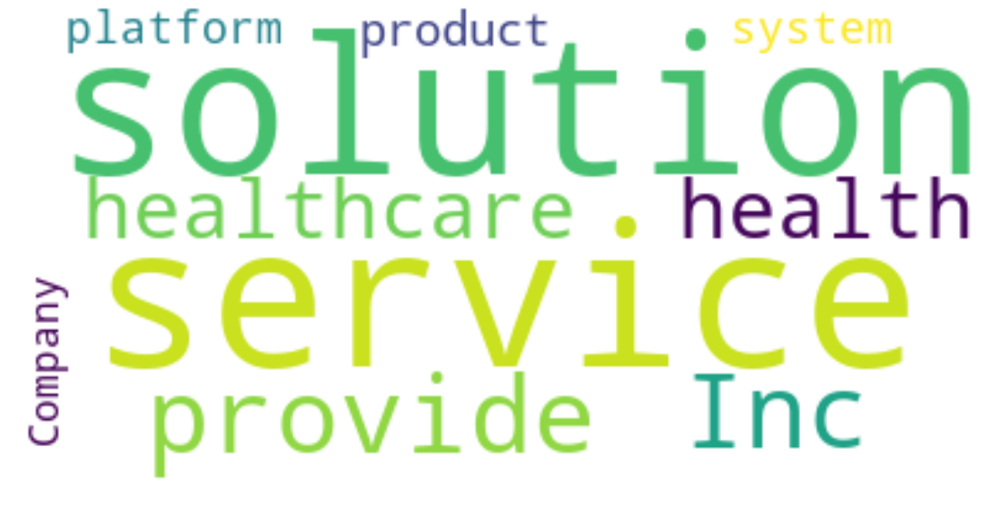

WORDCLOUD for Homebuilding


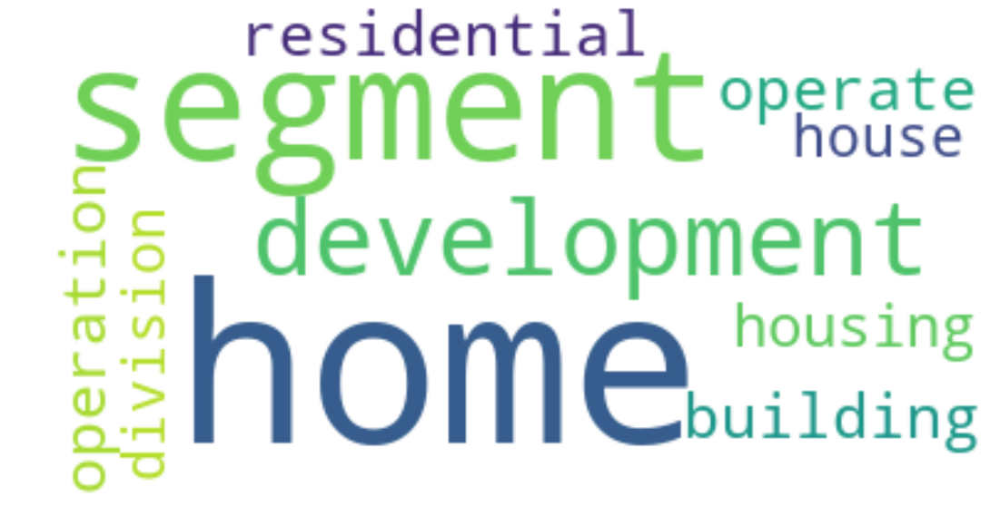

WORDCLOUD for Hotels, Resorts & Cruise Lines


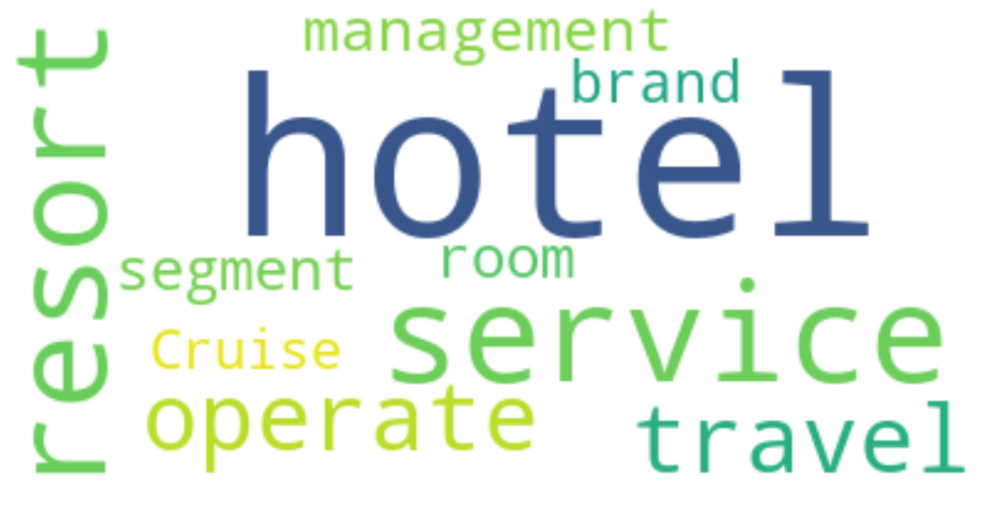

WORDCLOUD for Human Resource & Employment Services


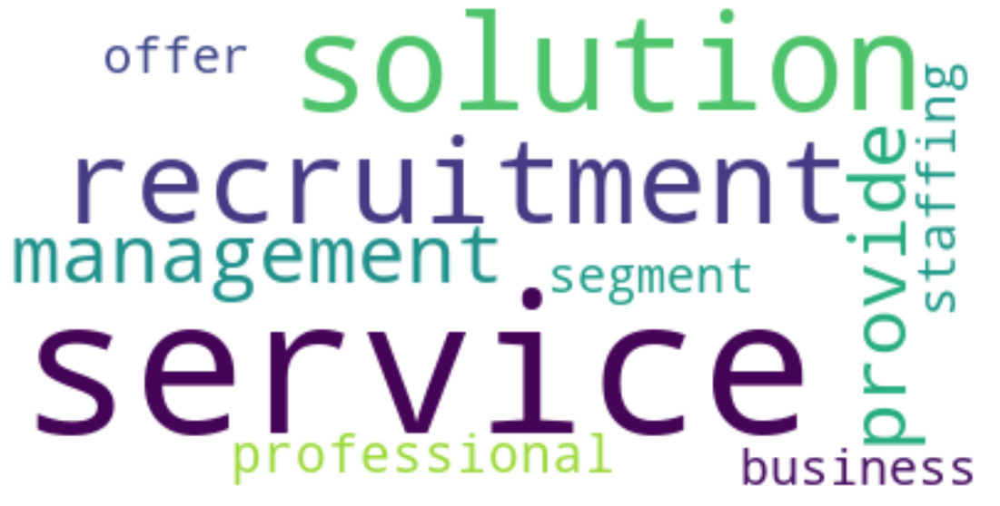

WORDCLOUD for Industrial Machinery


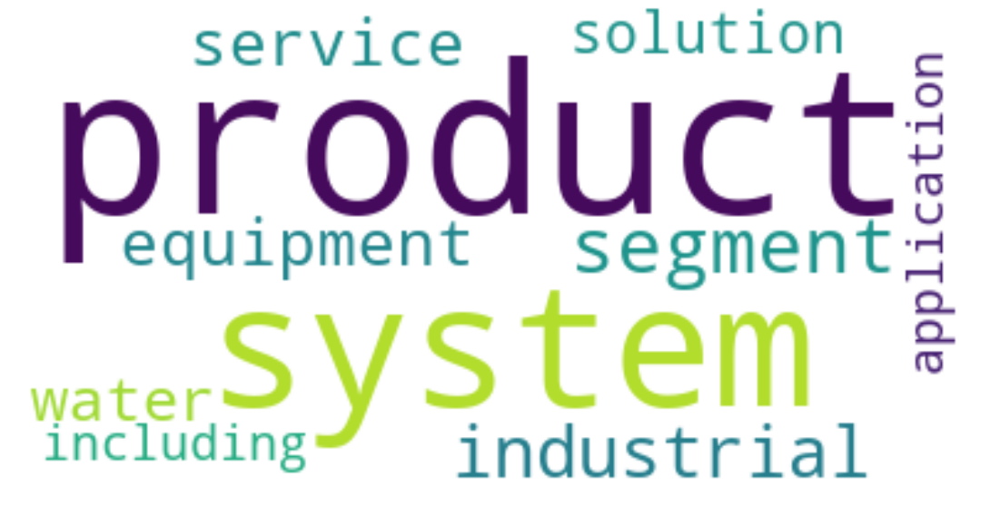

WORDCLOUD for Integrated Telecommunication Services


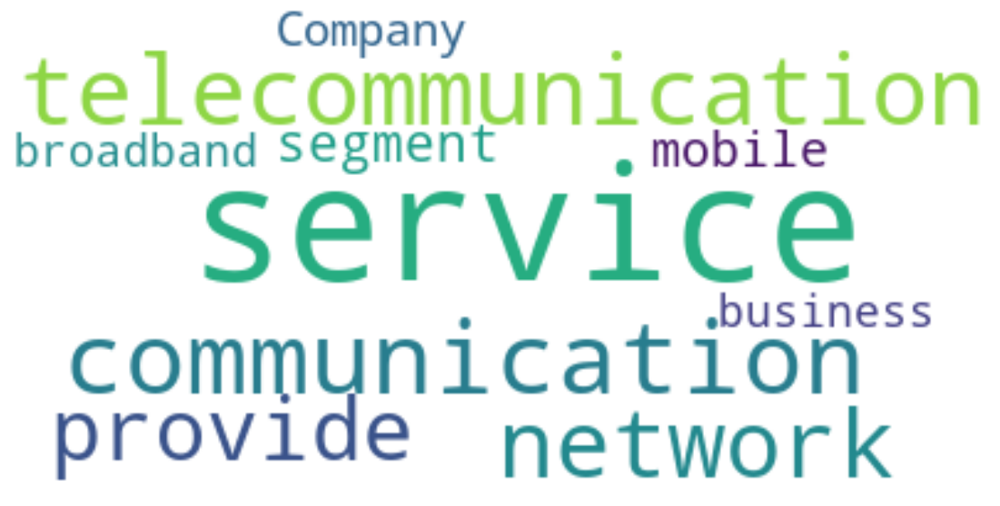

WORDCLOUD for Interactive Media & Services


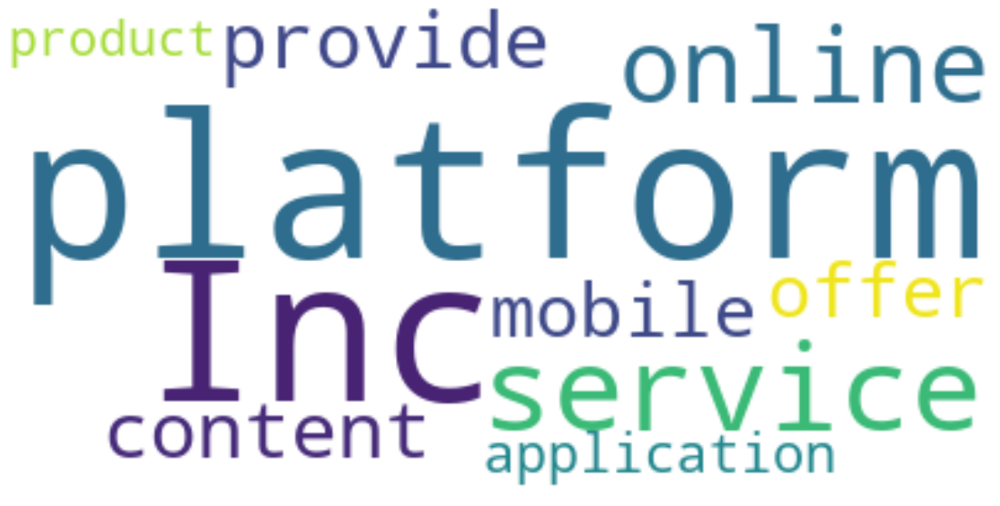

WORDCLOUD for Internet & Direct Marketing Retail


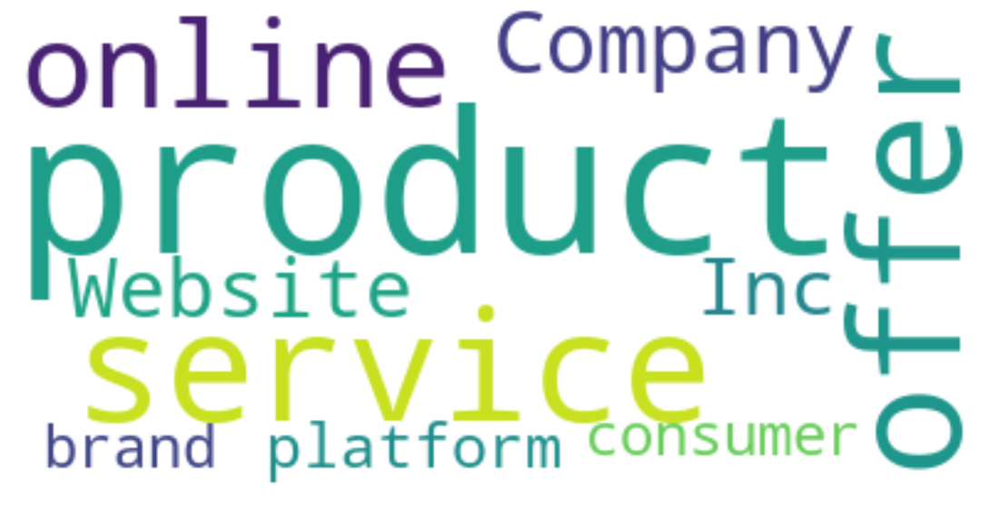

WORDCLOUD for Internet Services & Infrastructure


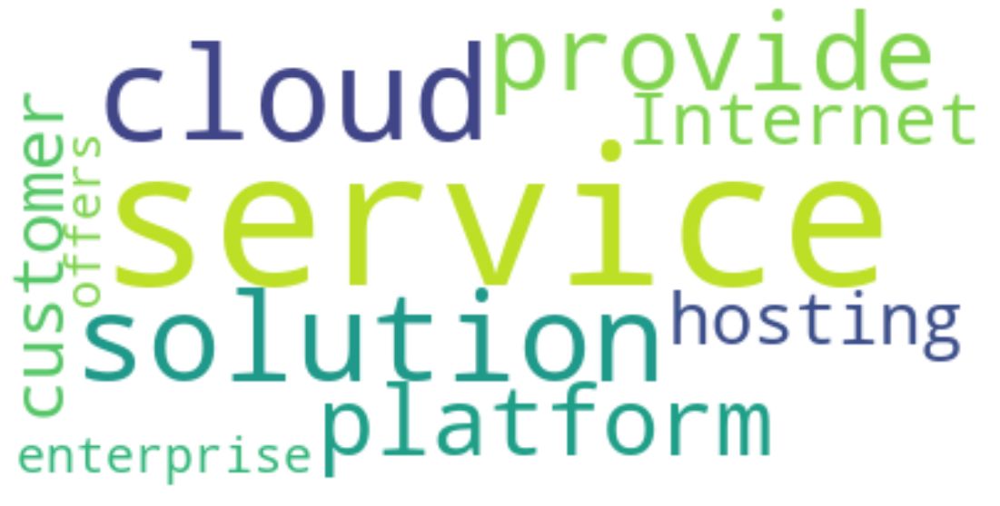

WORDCLOUD for Investment Banking & Brokerage


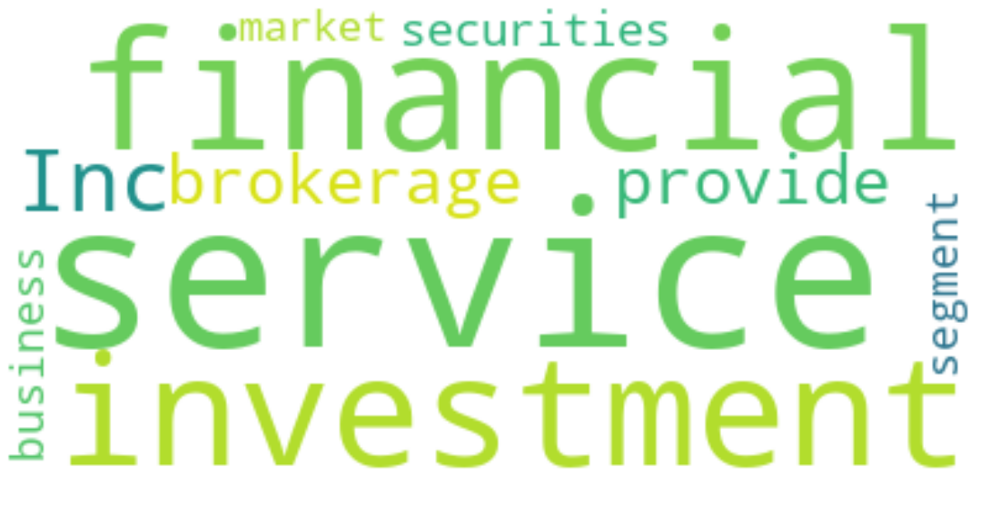

WORDCLOUD for IT Consulting & Other Services


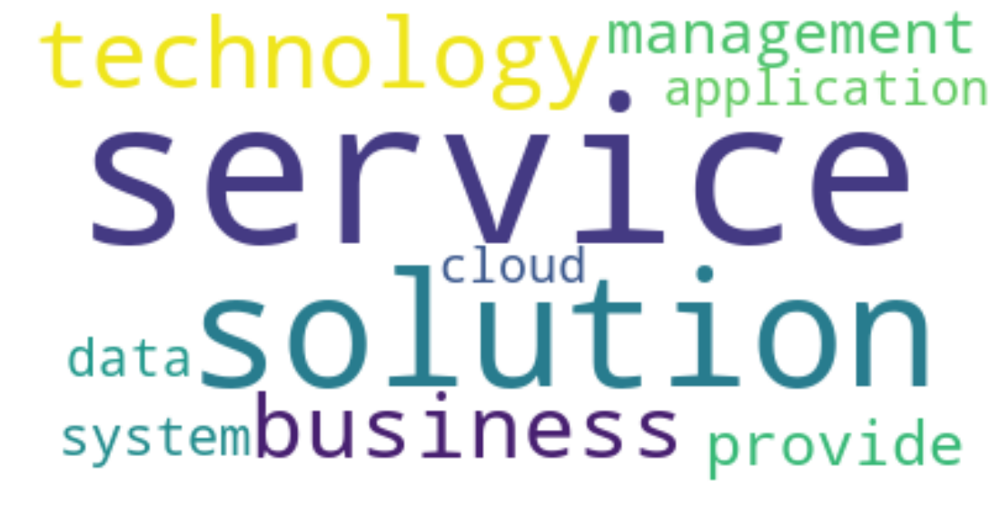

WORDCLOUD for Leisure Products


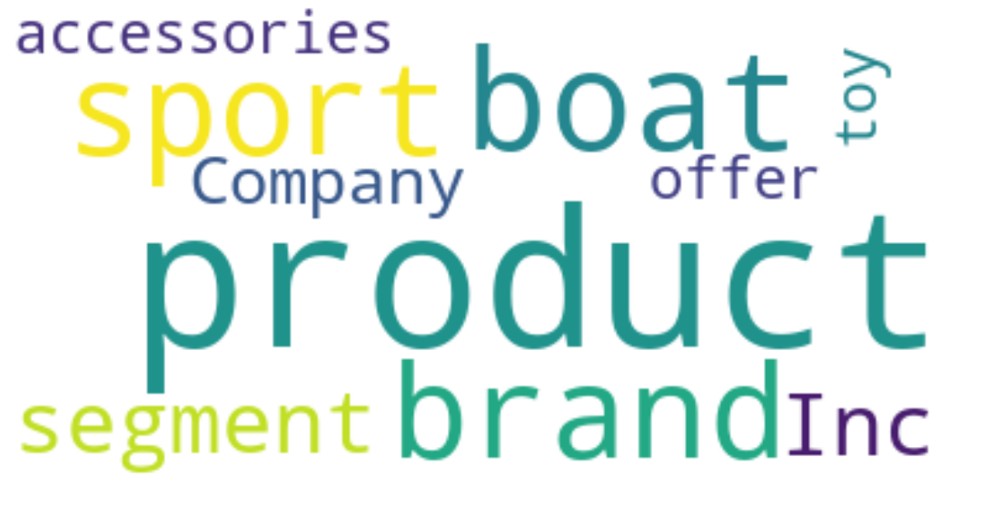

WORDCLOUD for Life Sciences Tools & Services


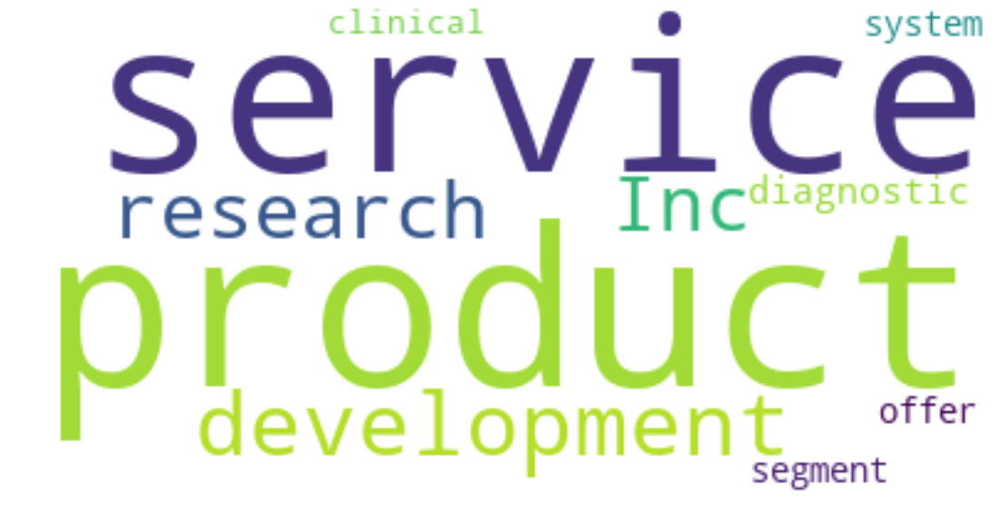

WORDCLOUD for Movies & Entertainment


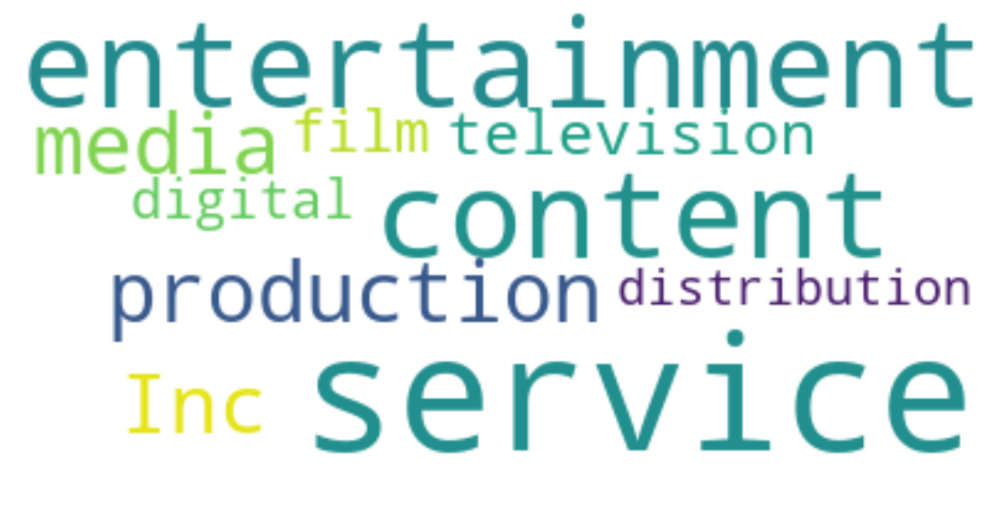

WORDCLOUD for Oil & Gas Equipment & Services


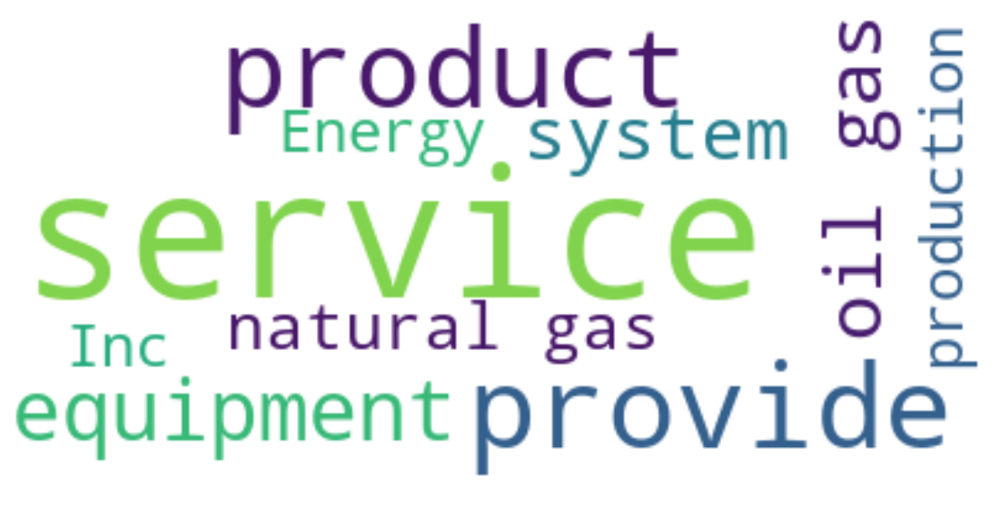

WORDCLOUD for Oil & Gas Exploration & Production


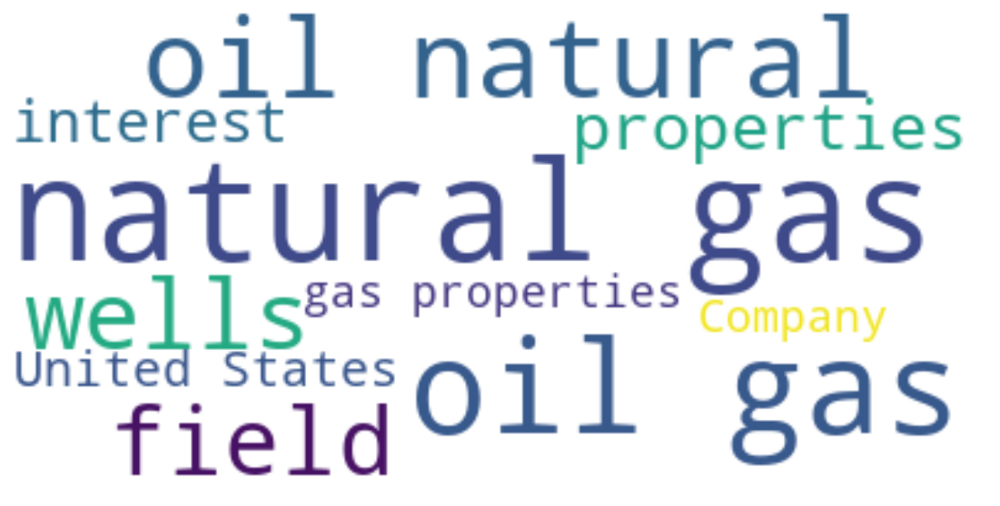

WORDCLOUD for Oil & Gas Refining & Marketing


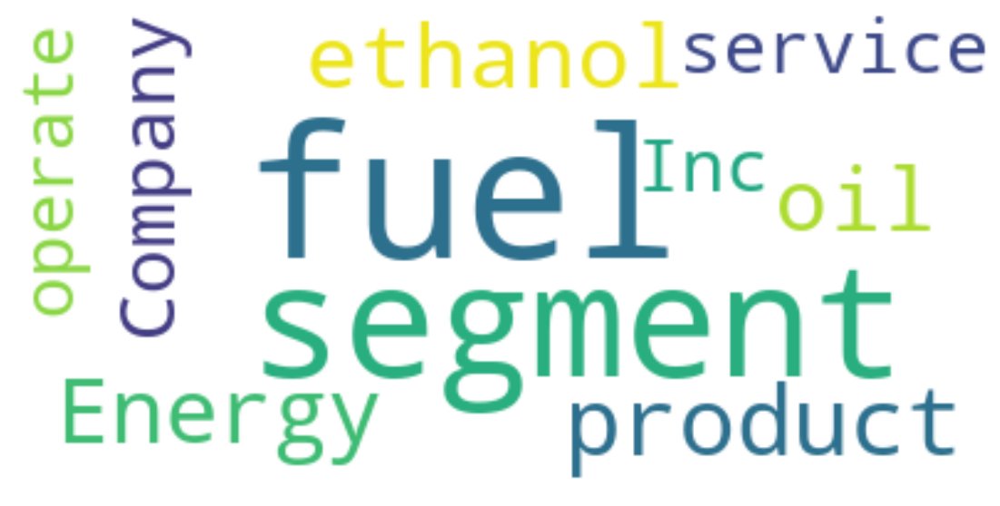

WORDCLOUD for Oil & Gas Storage & Transportation


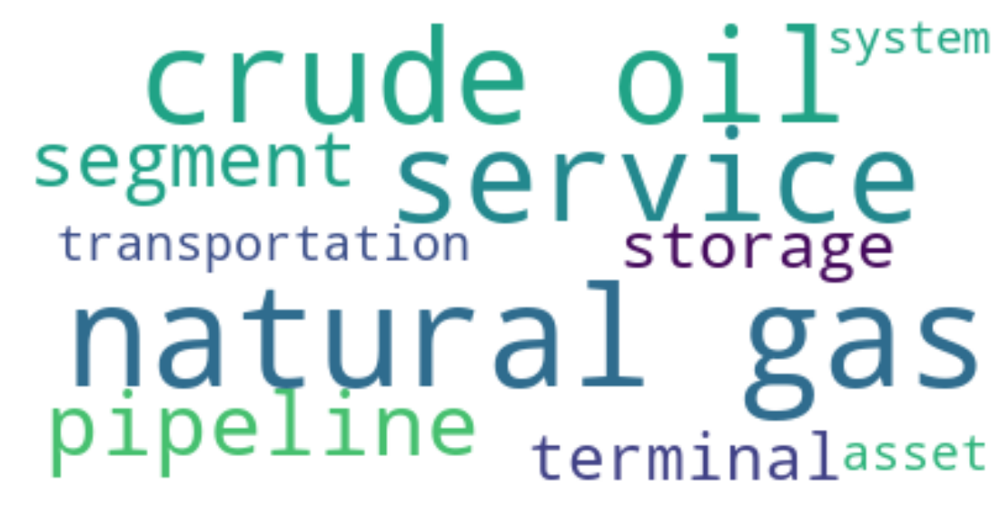

WORDCLOUD for Packaged Foods & Meats


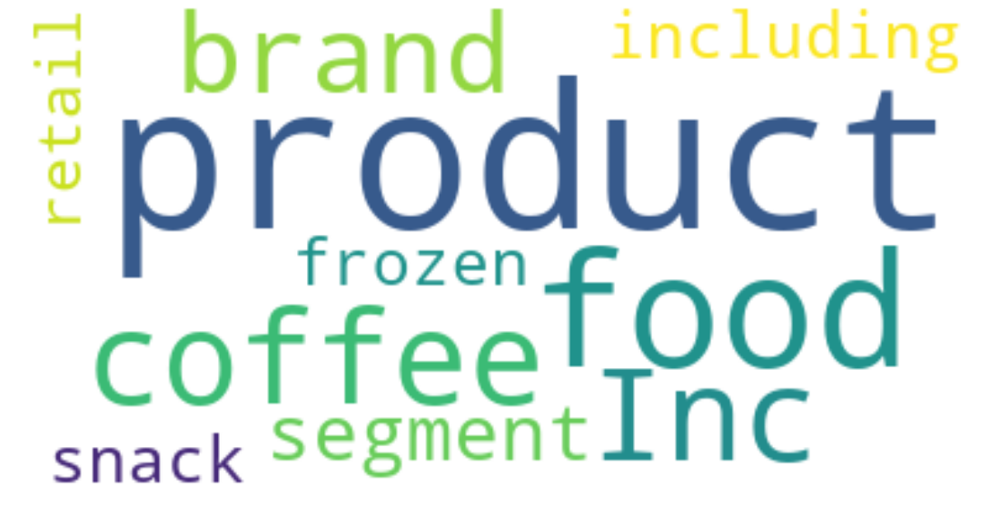

WORDCLOUD for Personal Products


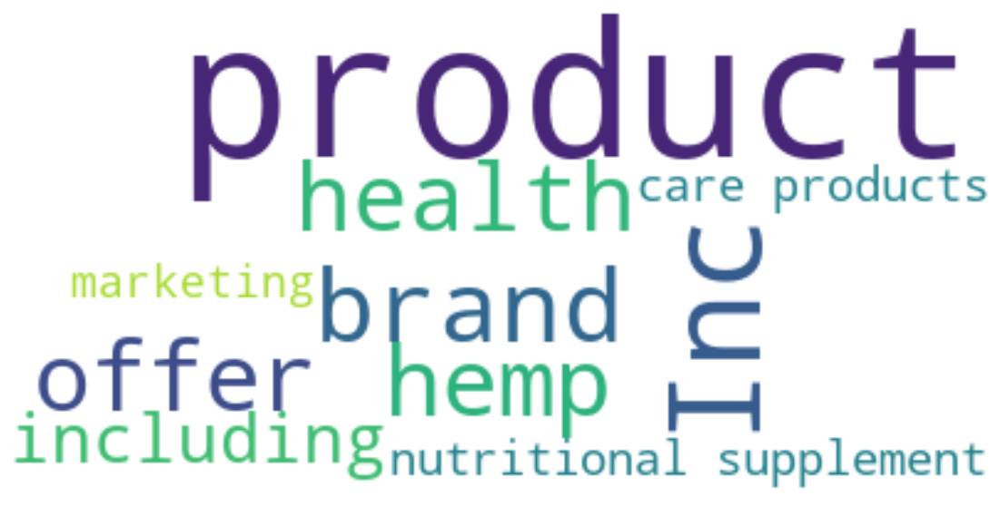

WORDCLOUD for Pharmaceuticals


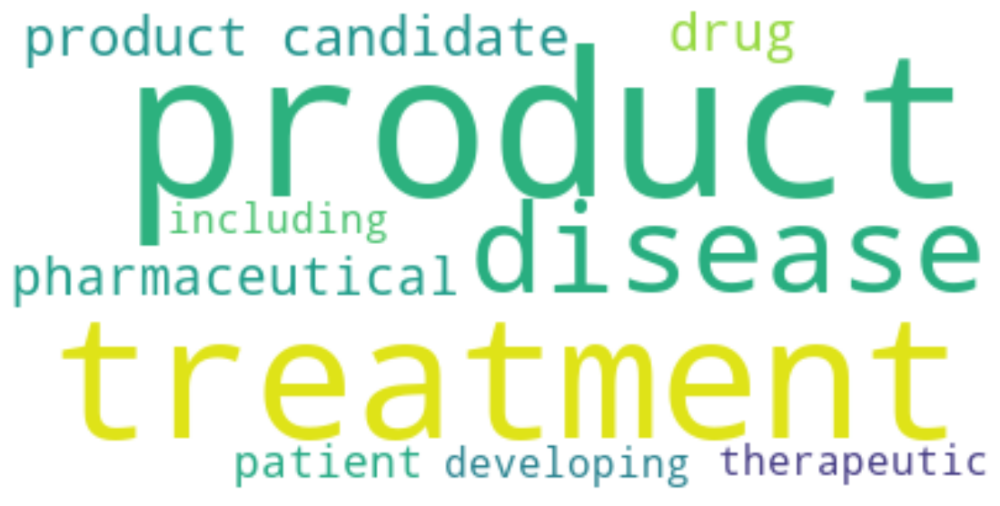

WORDCLOUD for Property & Casualty Insurance


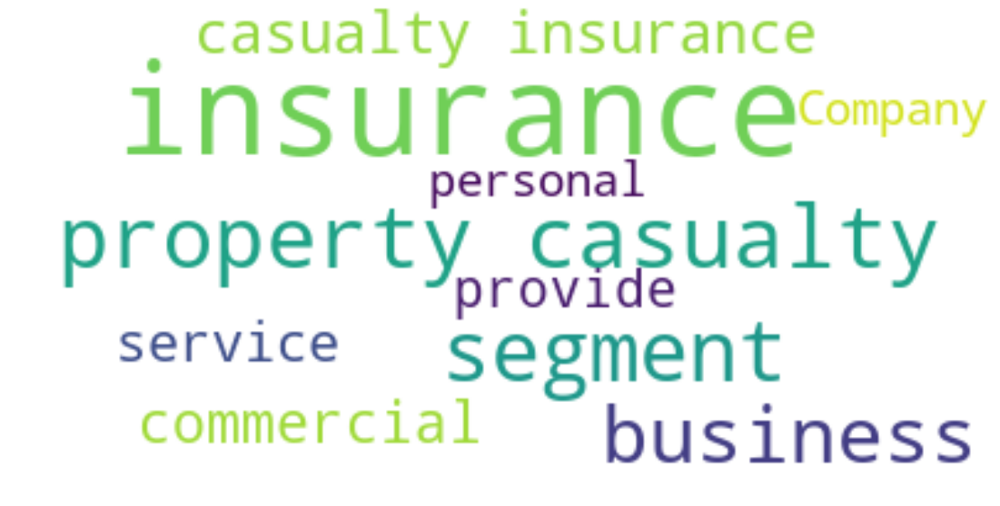

WORDCLOUD for Real Estate Operating Companies


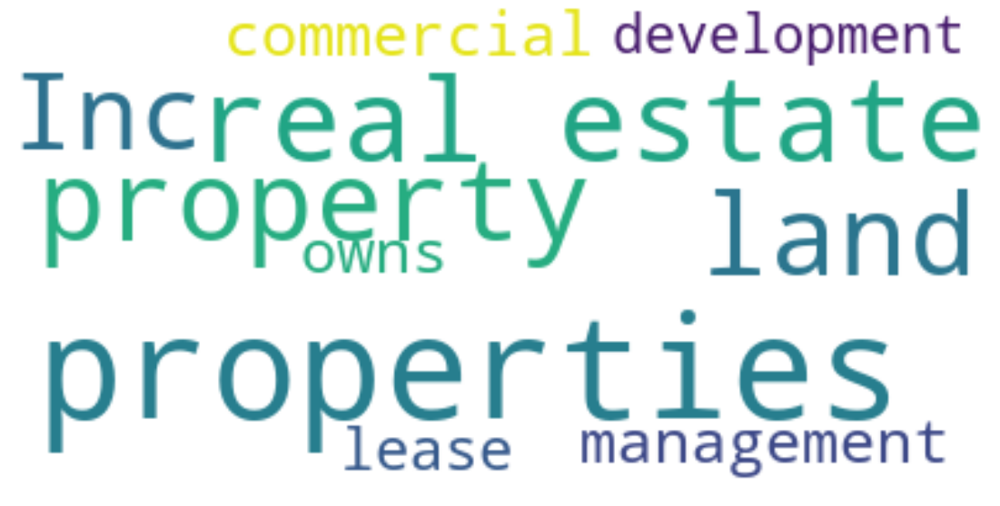

WORDCLOUD for Regional Banks


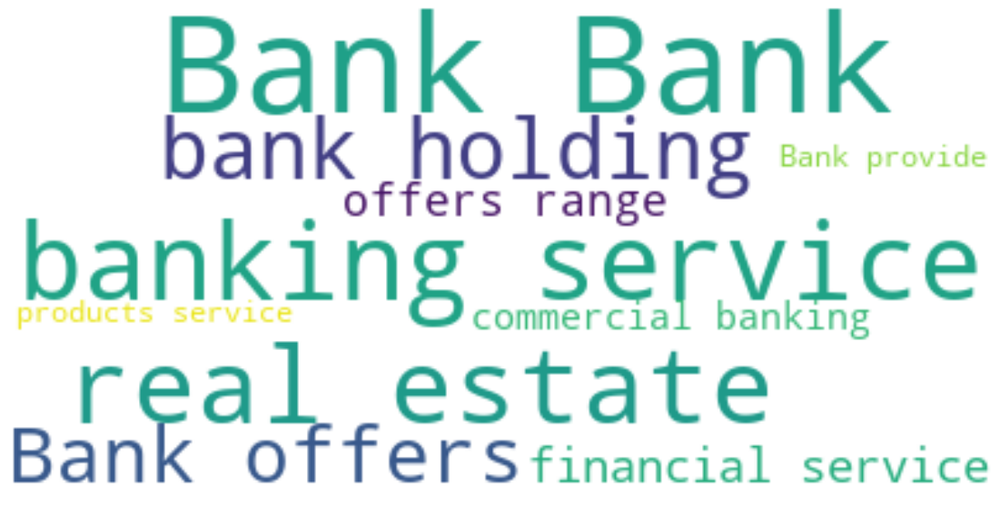

WORDCLOUD for Research & Consulting Services


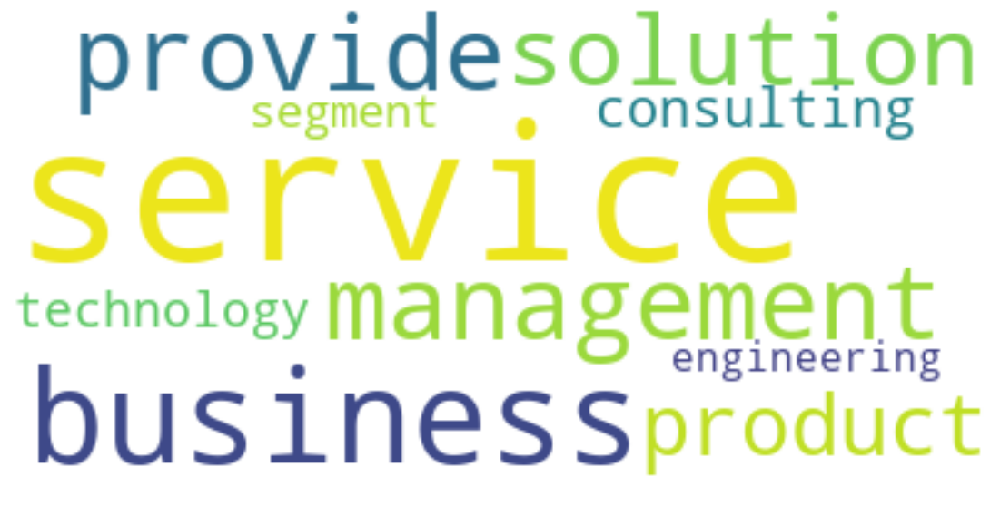

WORDCLOUD for Restaurants


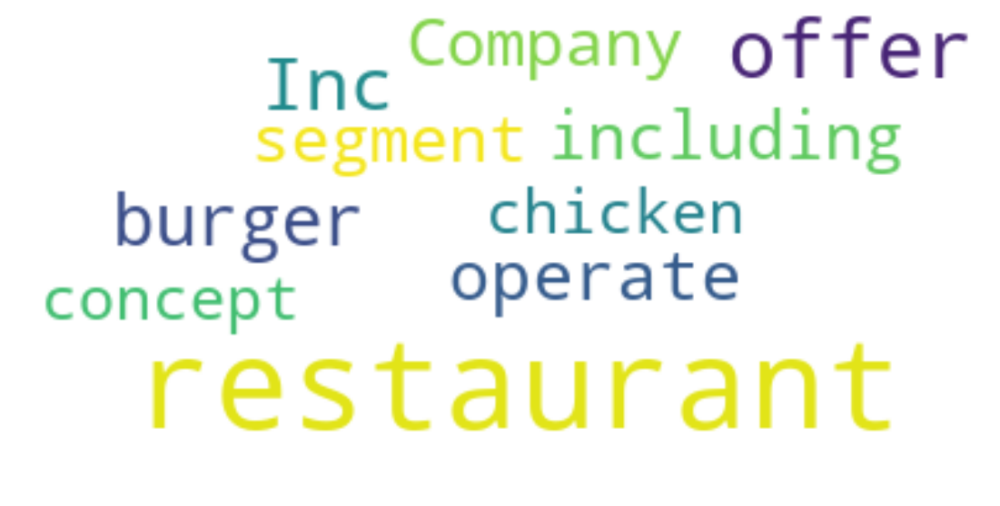

WORDCLOUD for Semiconductors


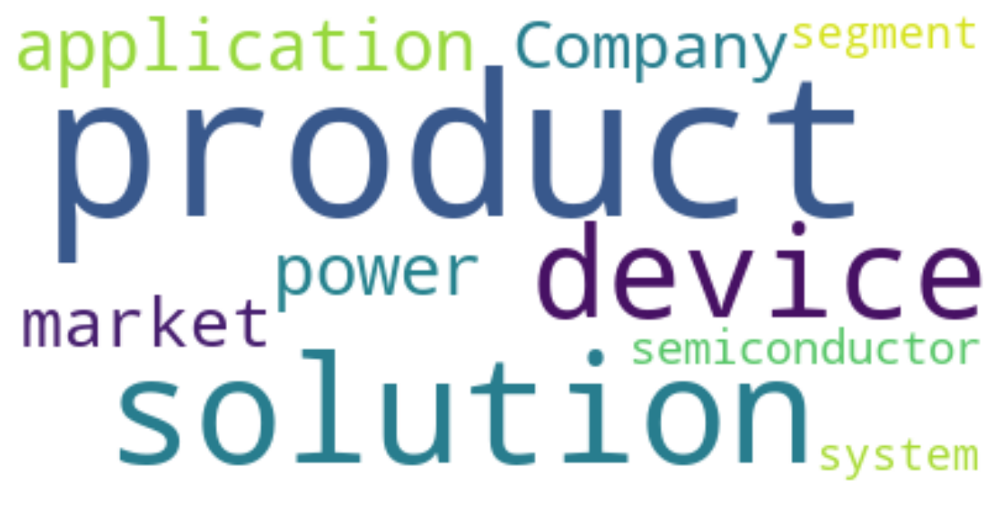

WORDCLOUD for Specialty Chemicals


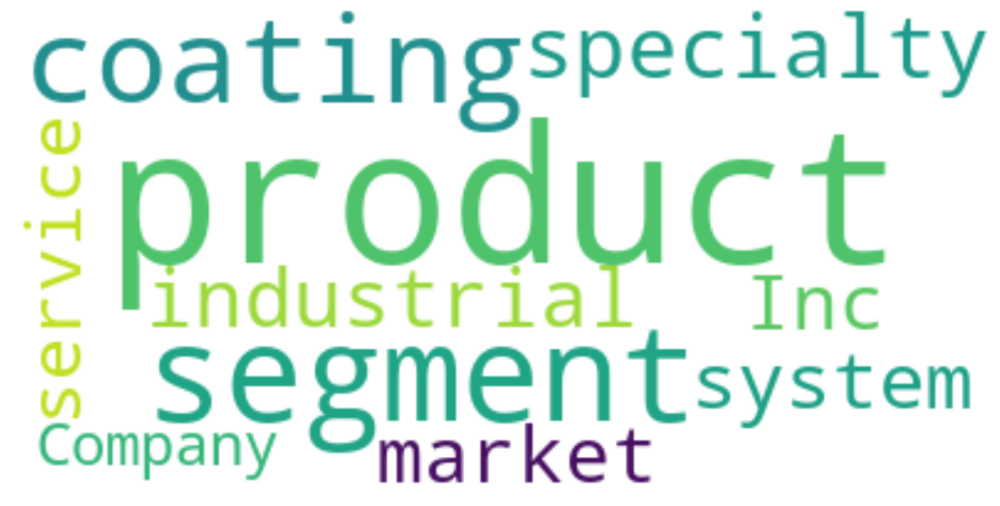

WORDCLOUD for Specialty Stores


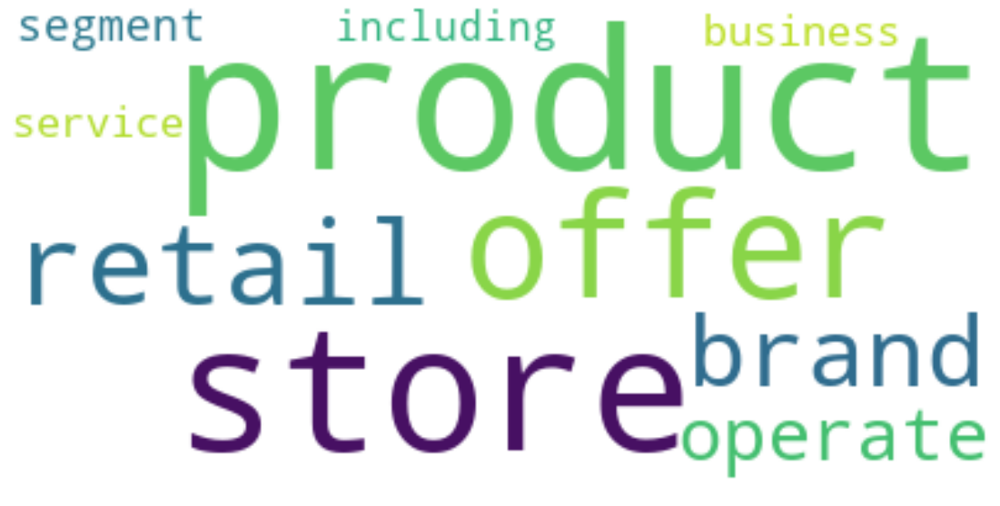

WORDCLOUD for Steel


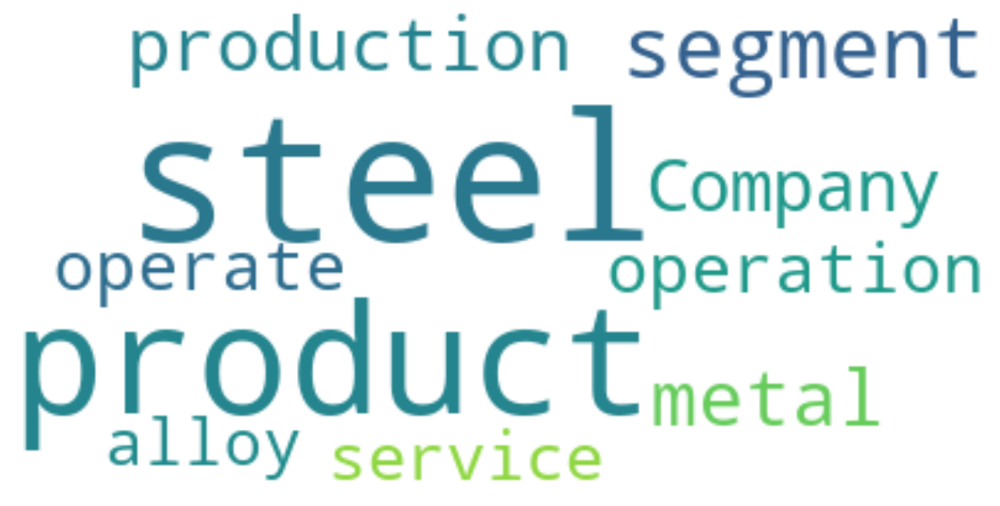

WORDCLOUD for Systems Software


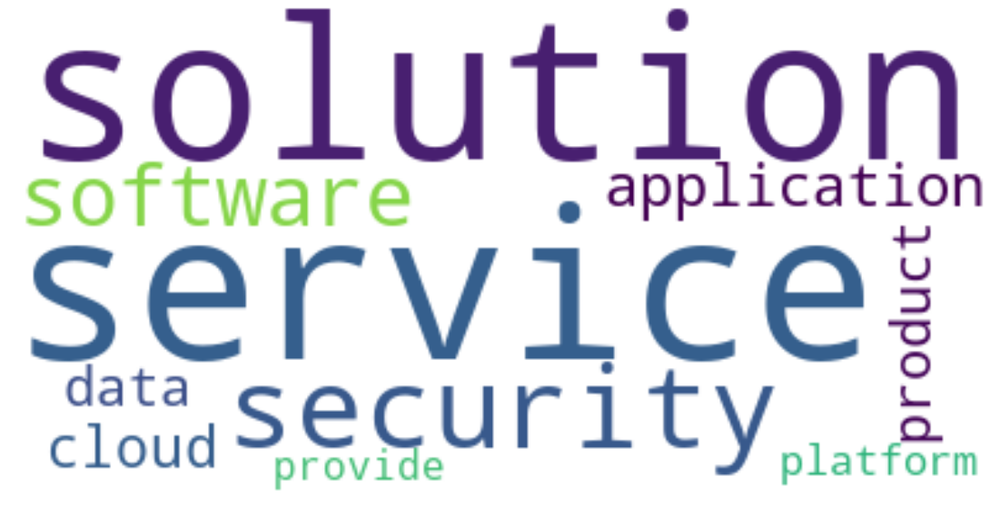

WORDCLOUD for Technology Distributors


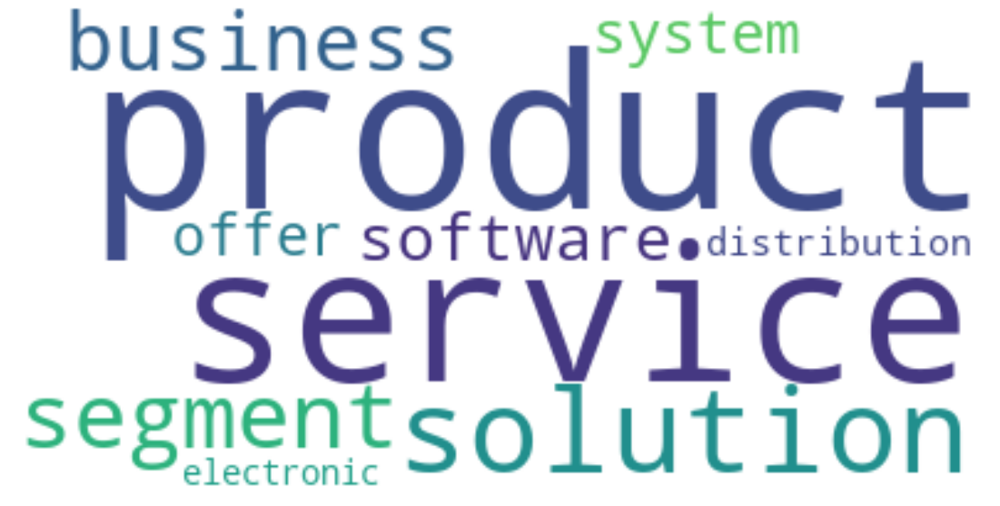

WORDCLOUD for Technology Hardware, Storage & Peripherals


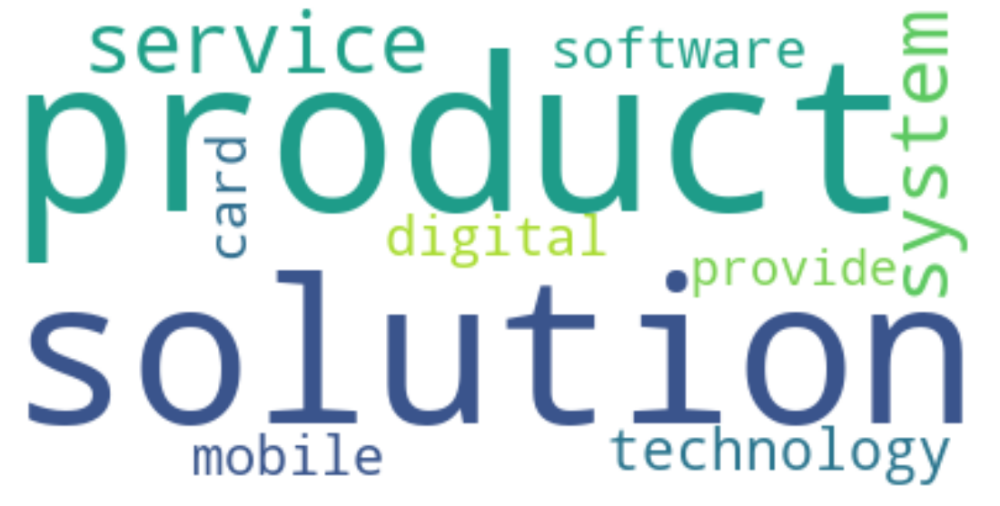

WORDCLOUD for Thrifts & Mortgage Finance


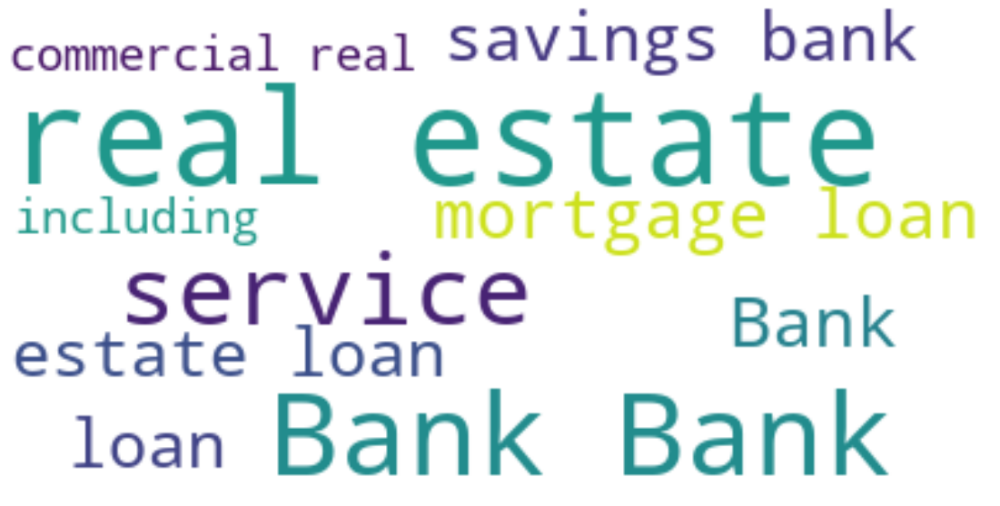

WORDCLOUD for Trading Companies & Distributors


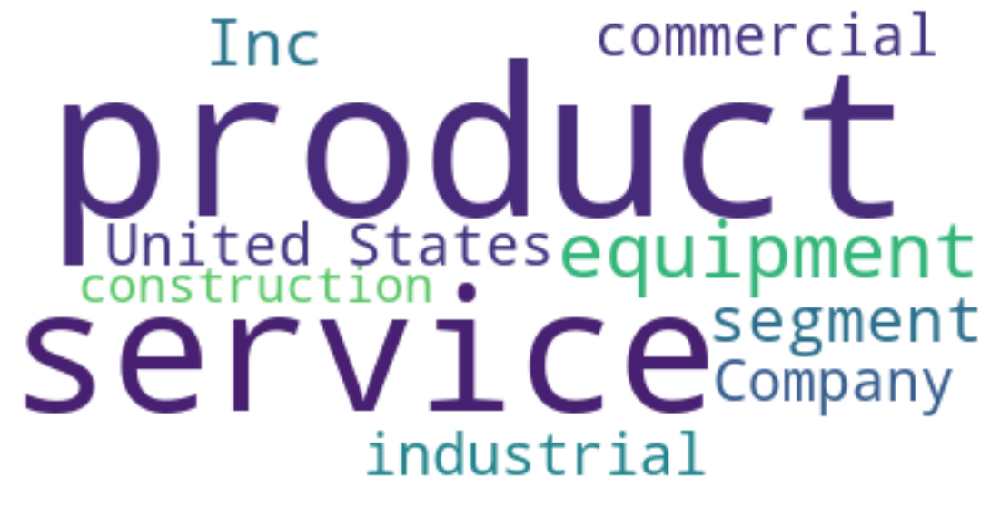

In [11]:
## Top-10 most frequent words amongst categories

for tag in tags:
    print("WORDCLOUD for", tag)
    mask_df = df[df["Industry Classification Tag"]==tag]["Business Description"].values
    text = " ".join(mask_df)
    # Generate a word cloud image
    wordcloud = WordCloud(stopwords=stopwords, max_words=10, background_color="white").generate(text)
    # Display the generated image
    plt.figure(figsize=(20,10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()
    print("="*100)

WORDCLOUD for Advertising


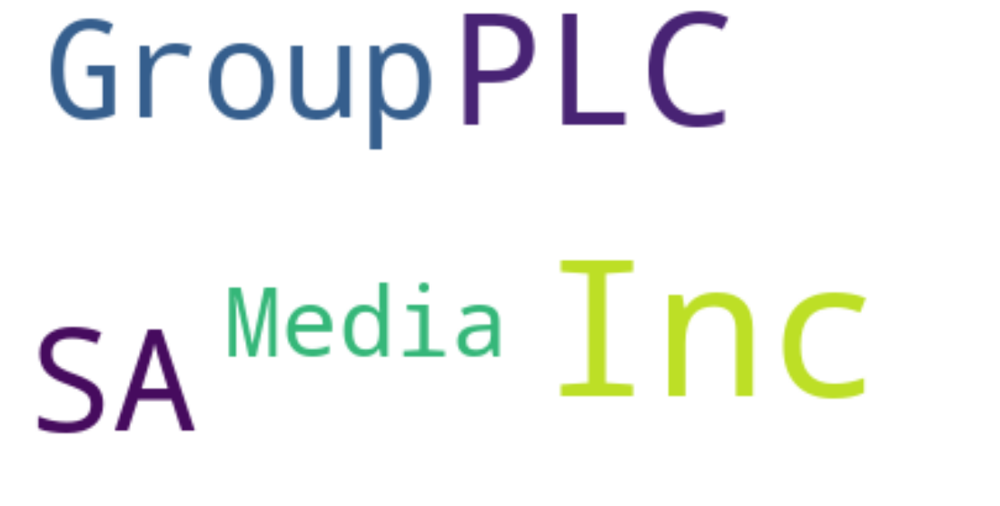

WORDCLOUD for Aerospace & Defense


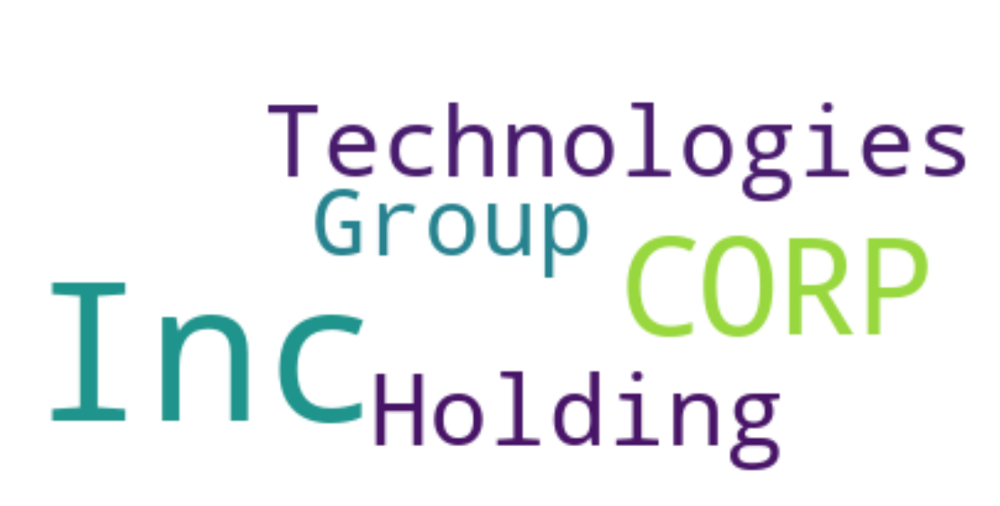

WORDCLOUD for Apparel Retail


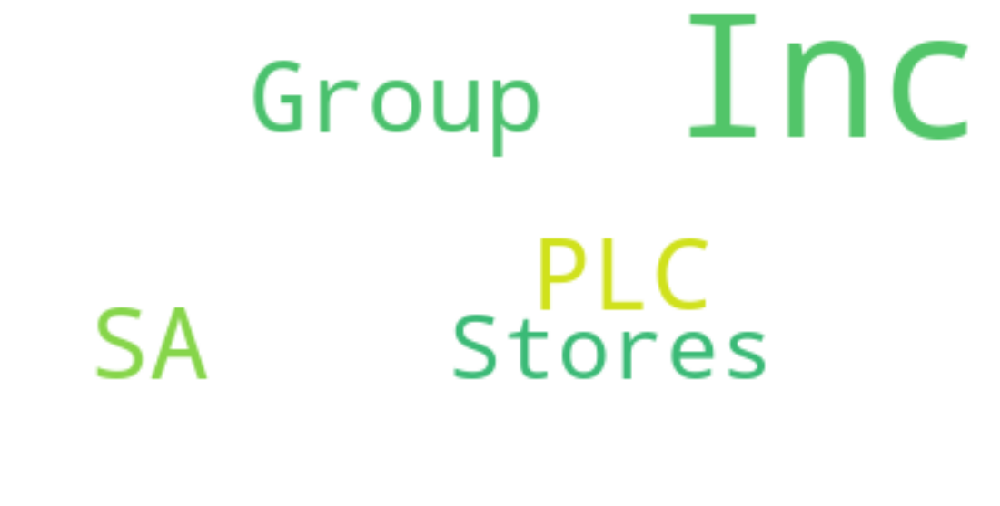

WORDCLOUD for Apparel, Accessories & Luxury Goods


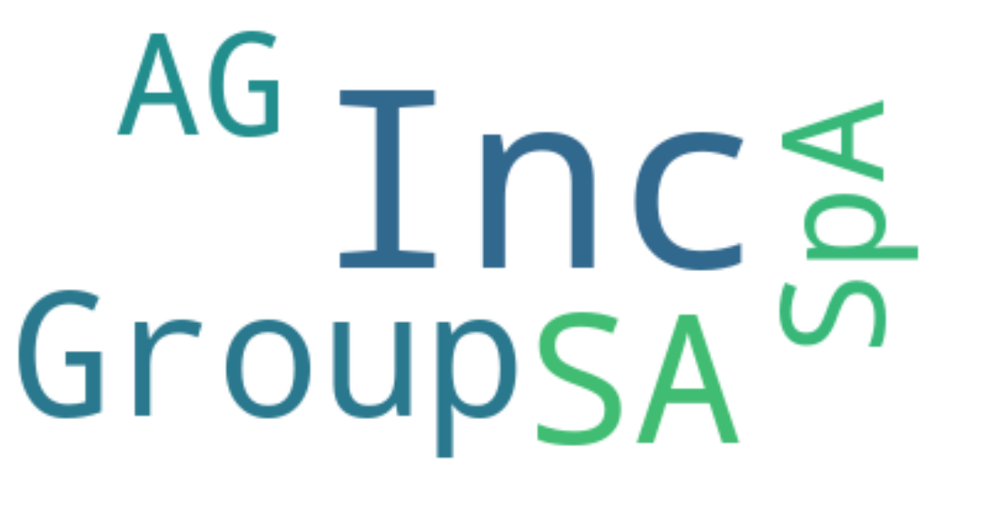

WORDCLOUD for Application Software


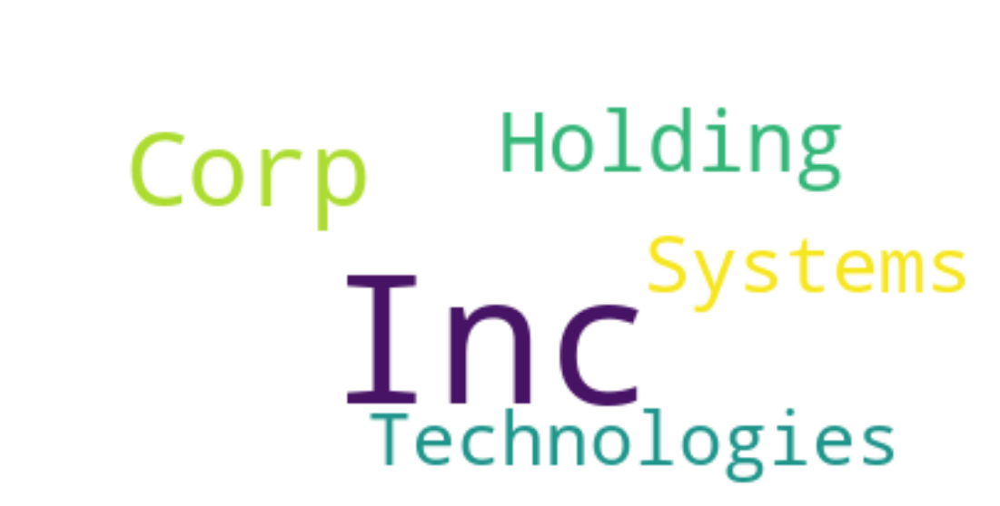

WORDCLOUD for Asset Management & Custody Banks


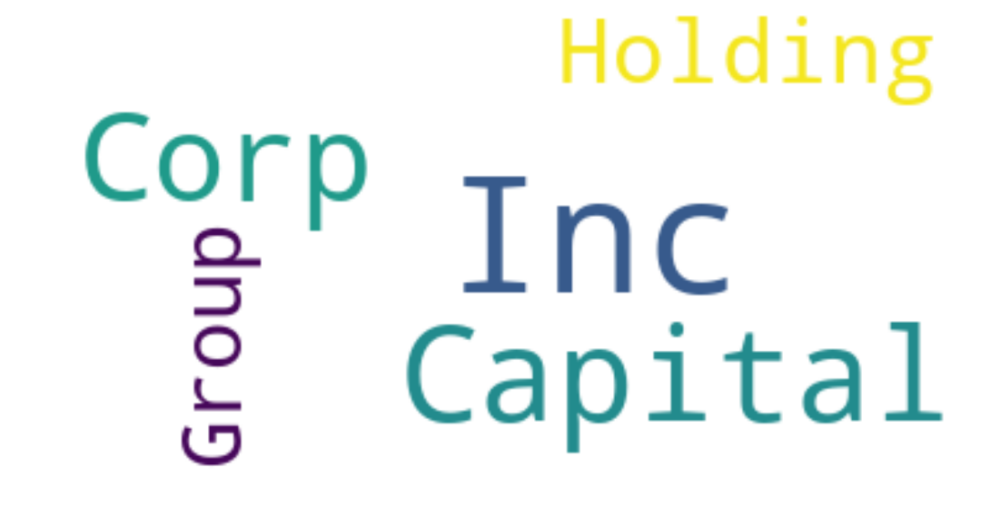

WORDCLOUD for Auto Parts & Equipment


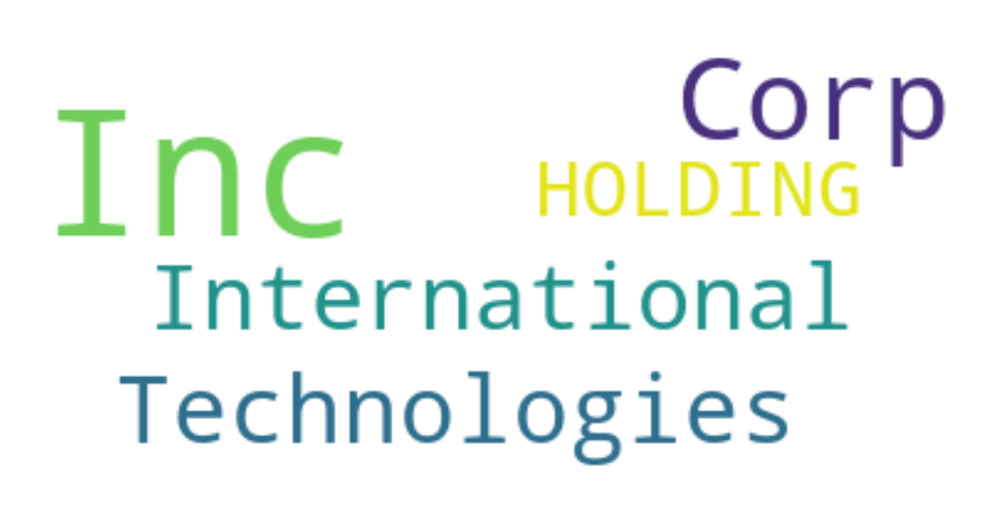

WORDCLOUD for Biotechnology


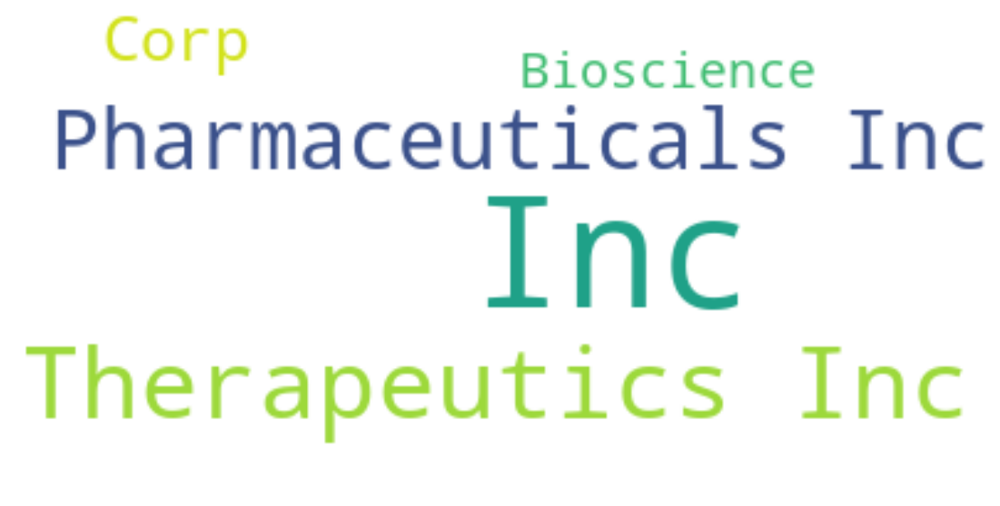

WORDCLOUD for Building Products


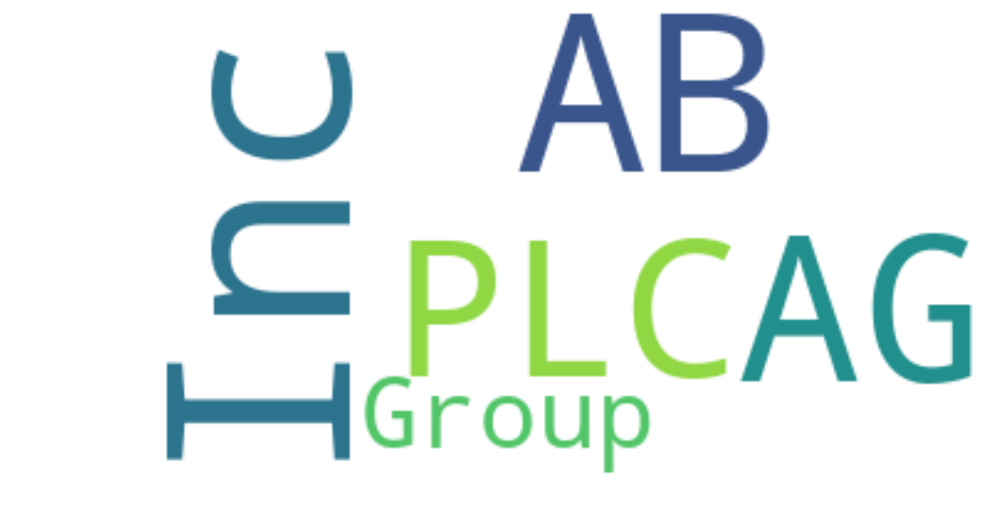

WORDCLOUD for Casinos & Gaming


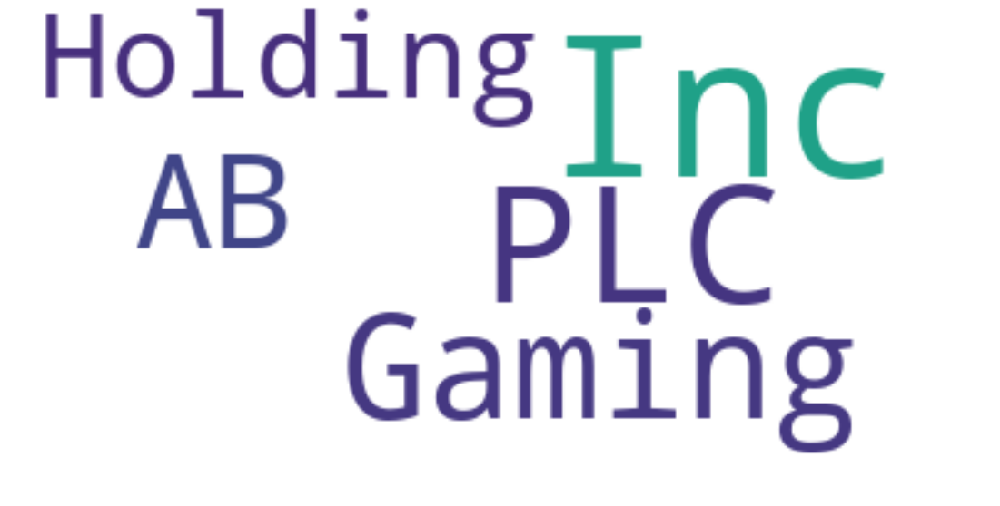

WORDCLOUD for Commodity Chemicals


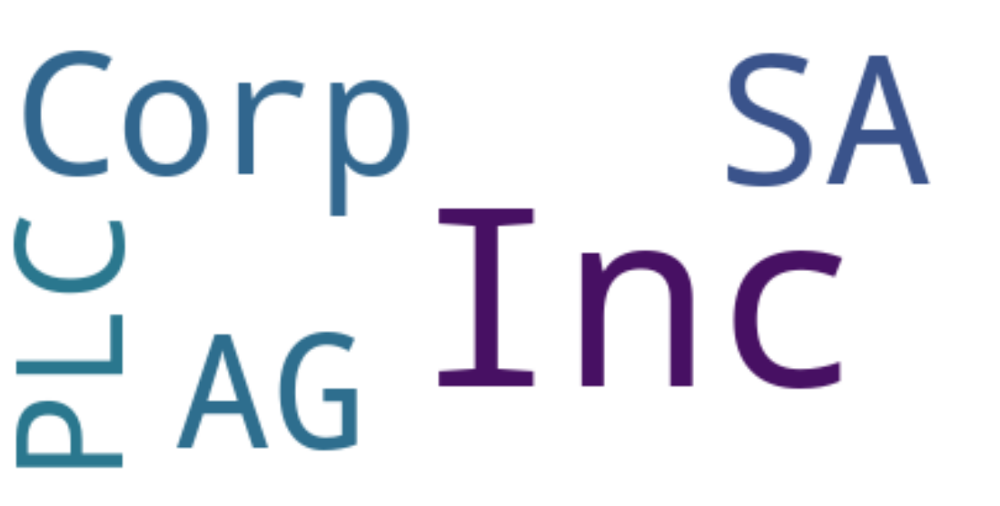

WORDCLOUD for Communications Equipment


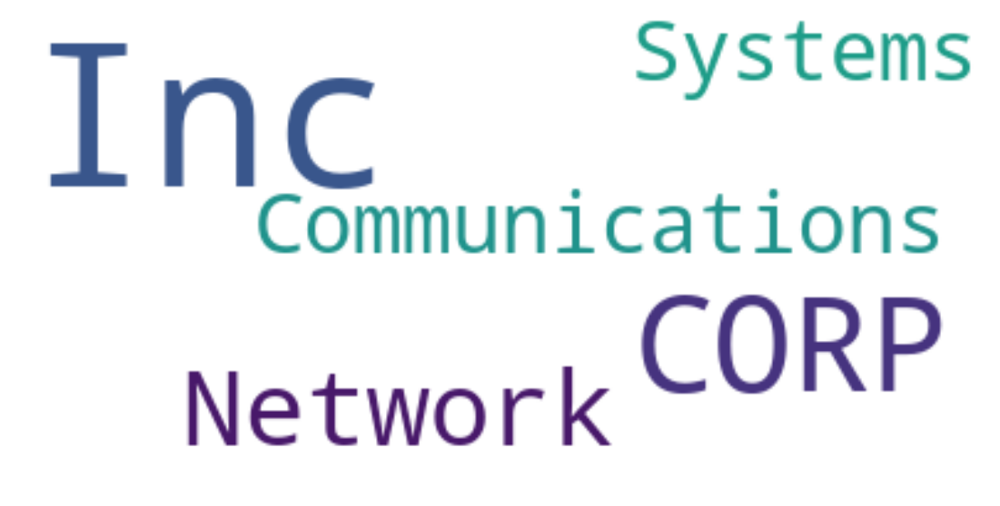

WORDCLOUD for Construction & Engineering


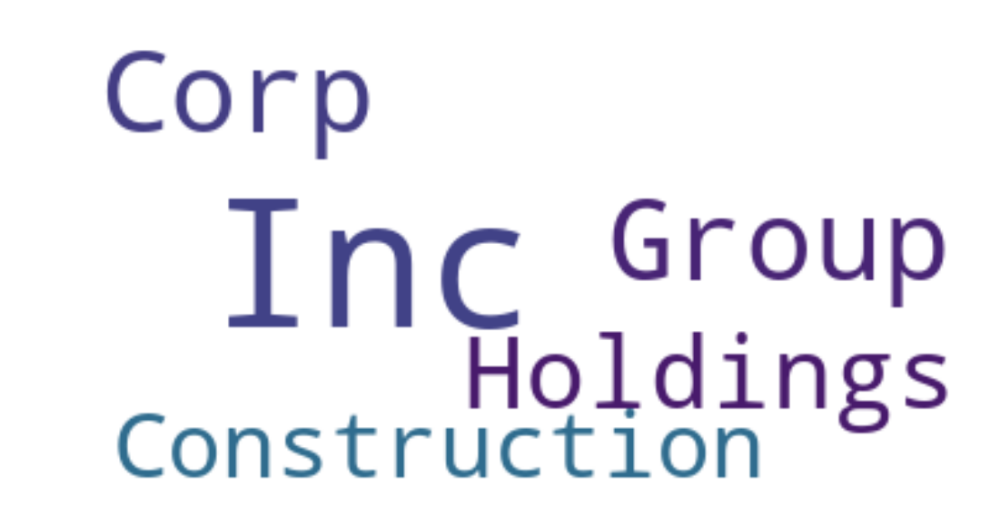

WORDCLOUD for Construction Machinery & Heavy Trucks


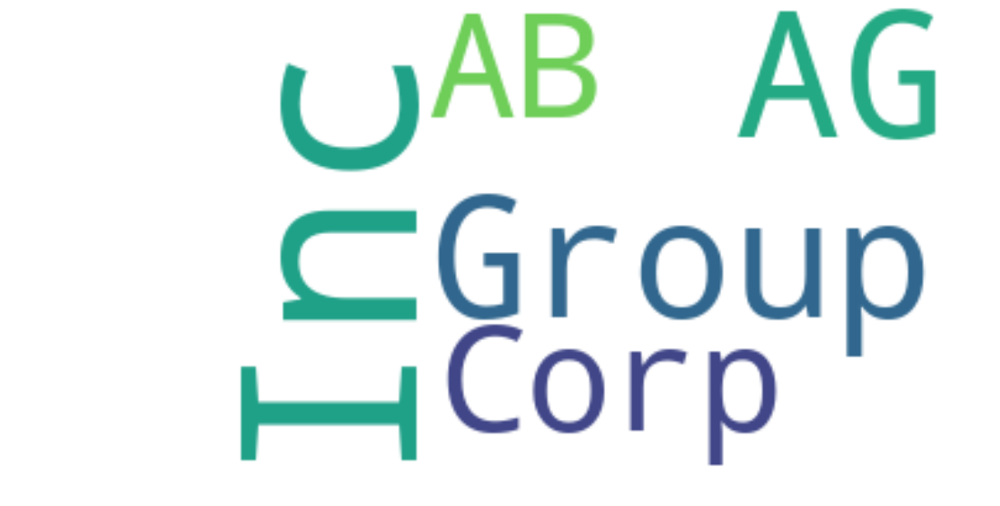

WORDCLOUD for Consumer Finance


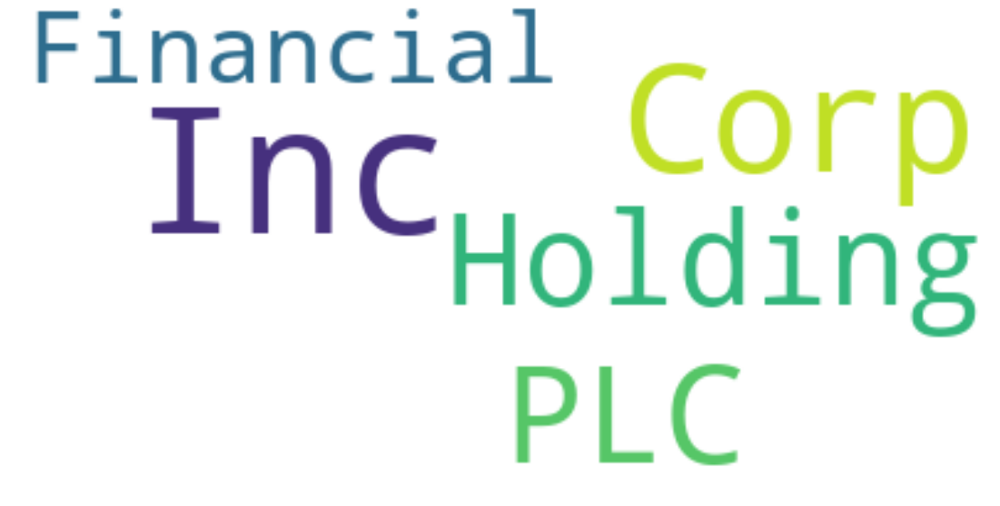

WORDCLOUD for Data Processing & Outsourced Services


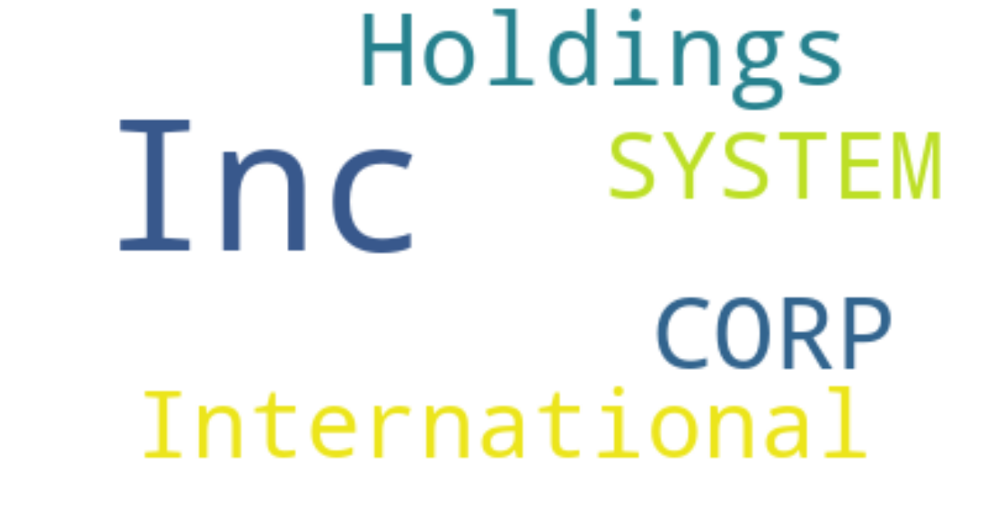

WORDCLOUD for Diversified Metals & Mining


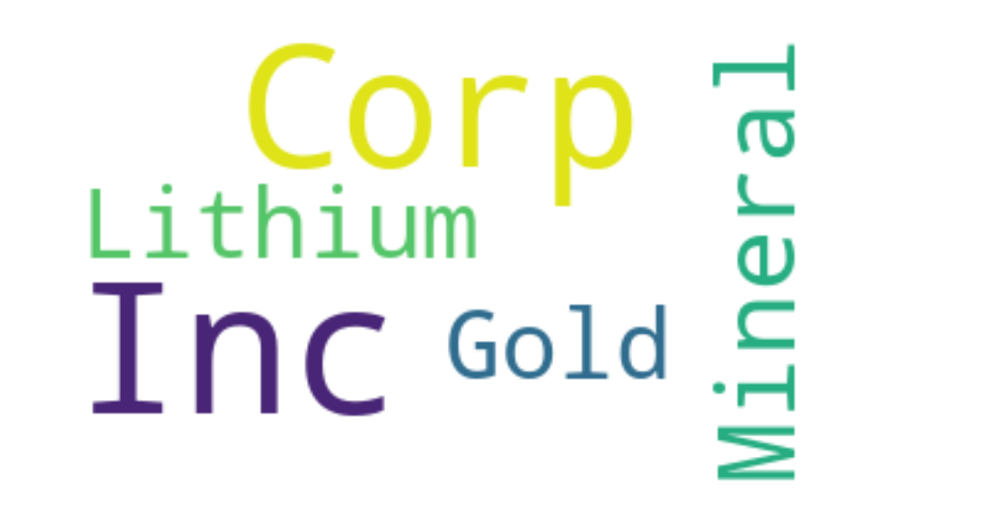

WORDCLOUD for Diversified Support Services


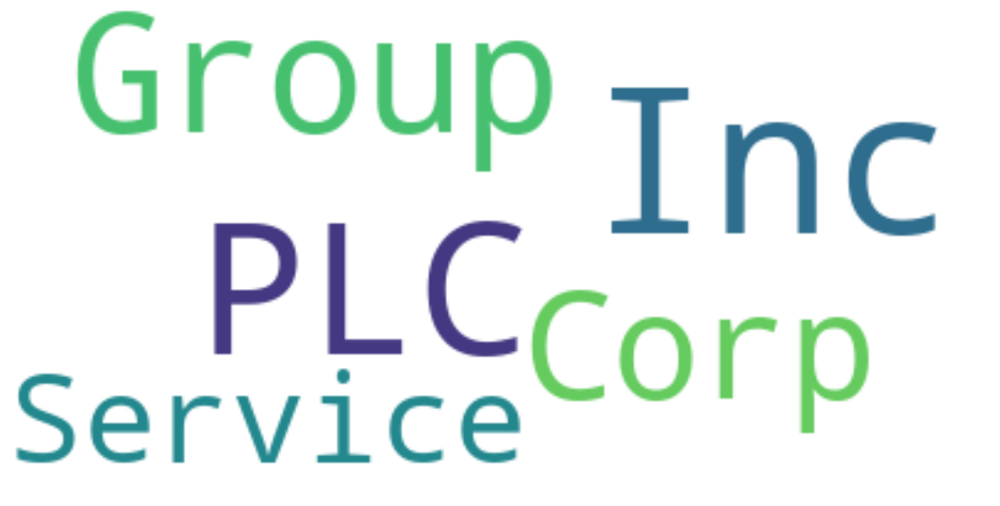

WORDCLOUD for Electric Utilities


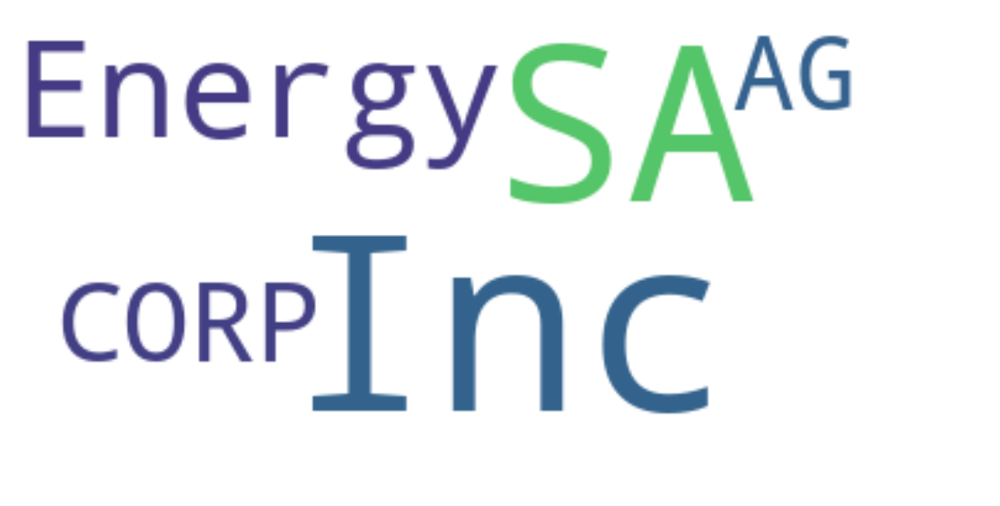

WORDCLOUD for Electrical Components & Equipment


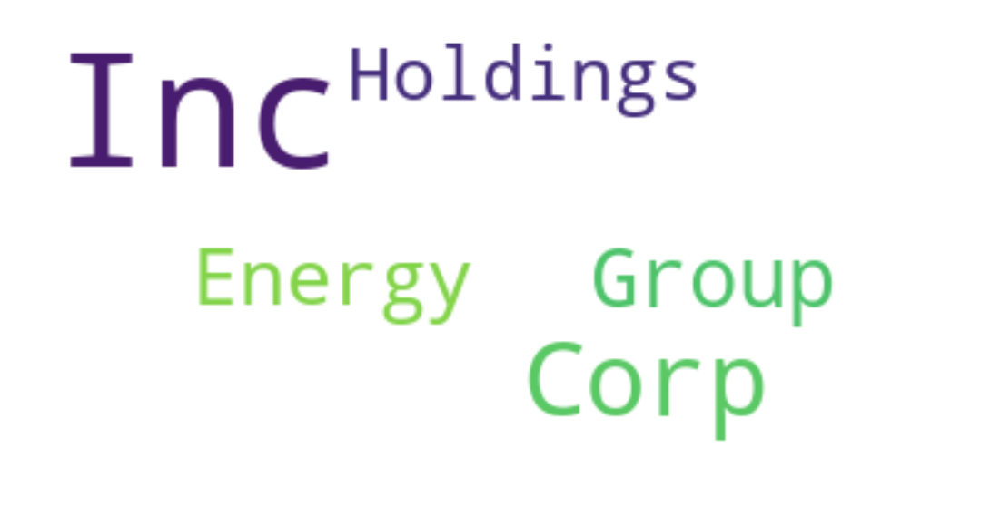

WORDCLOUD for Electronic Equipment & Instruments


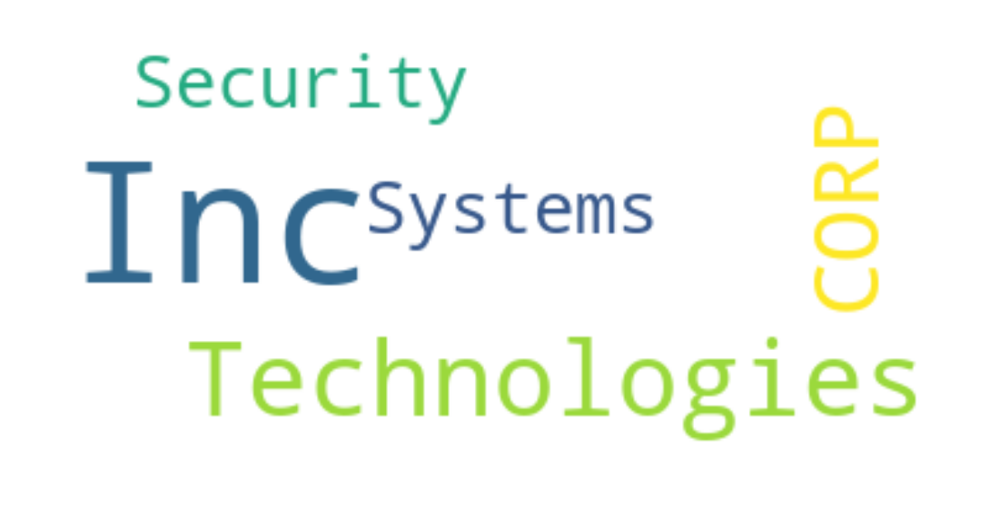

WORDCLOUD for Environmental & Facilities Services


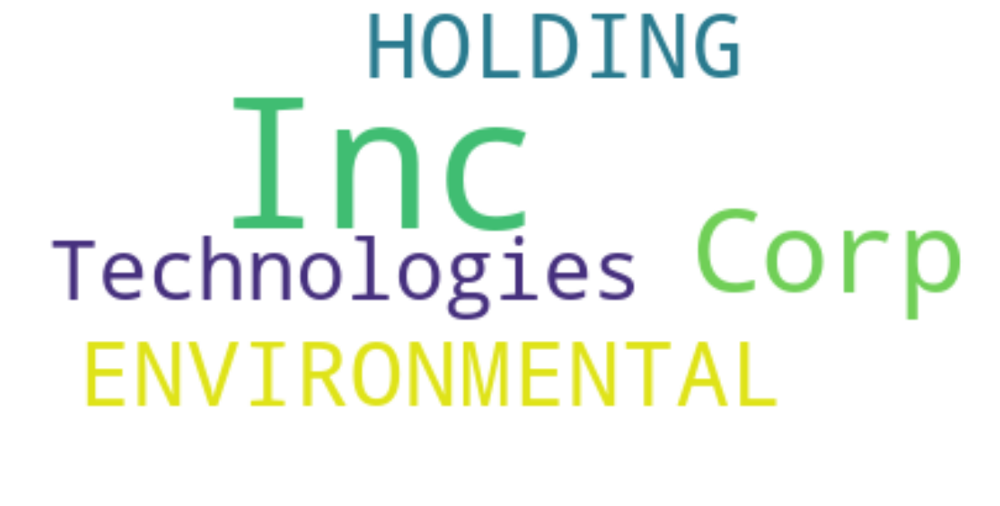

WORDCLOUD for Gold


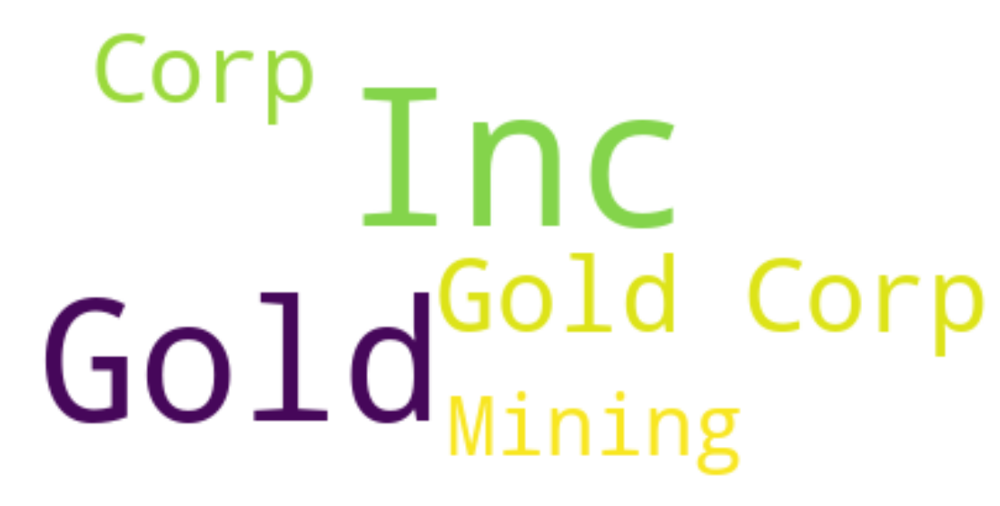

WORDCLOUD for Health Care Equipment


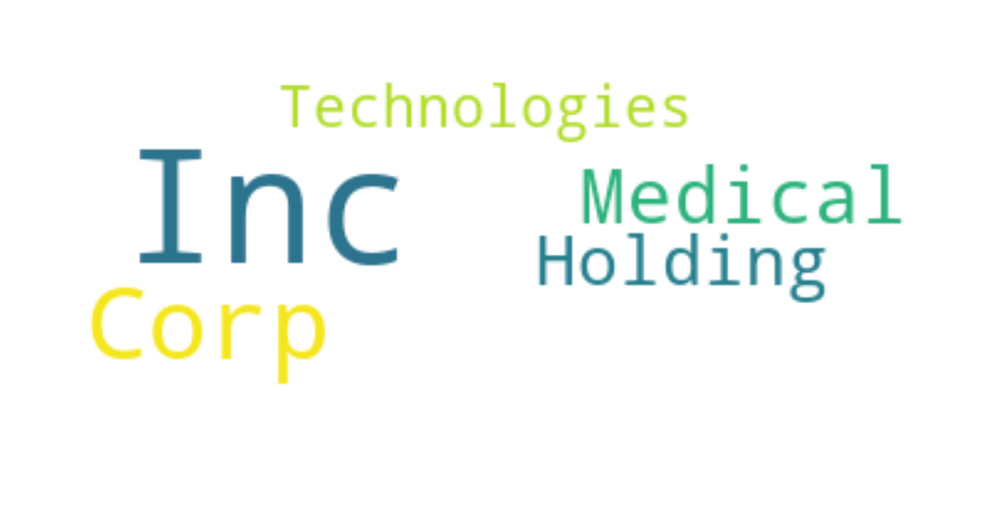

WORDCLOUD for Health Care Facilities


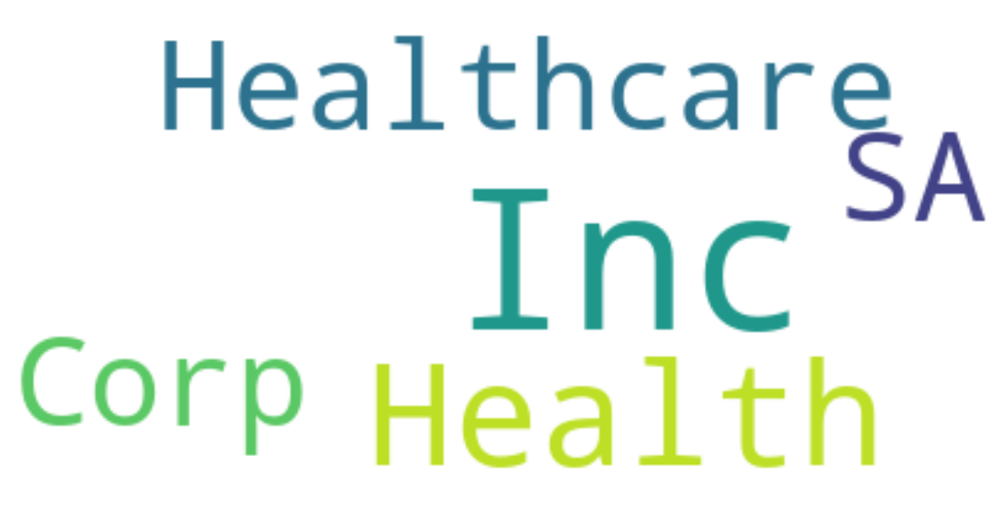

WORDCLOUD for Health Care Services


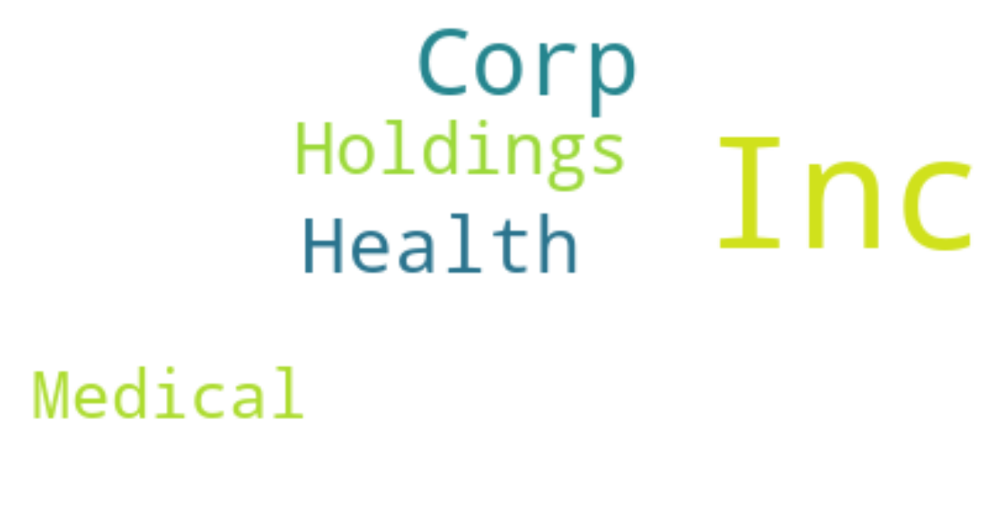

WORDCLOUD for Health Care Supplies


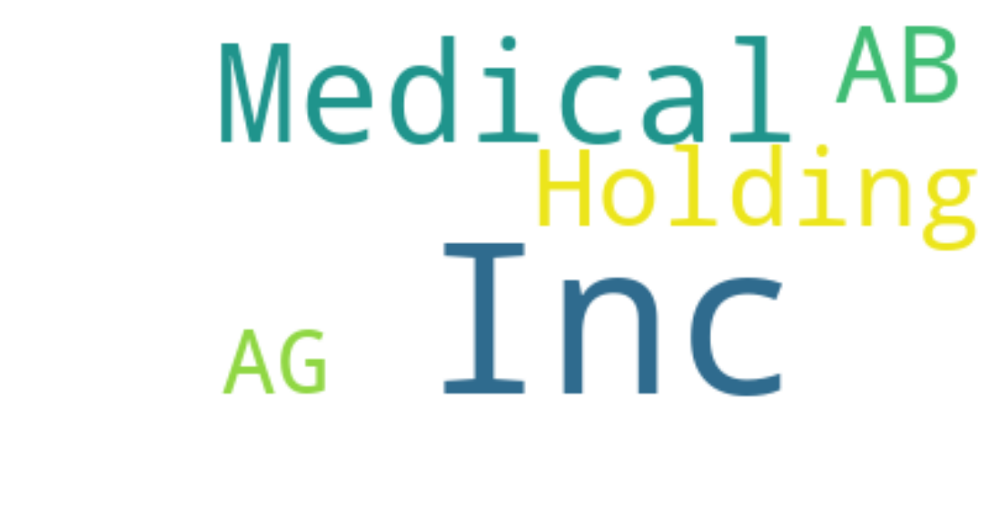

WORDCLOUD for Health Care Technology


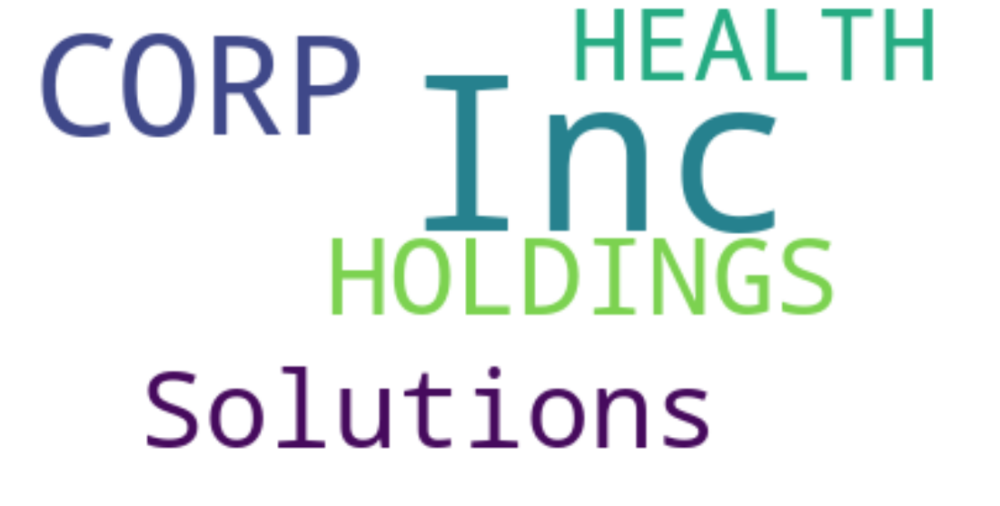

WORDCLOUD for Homebuilding


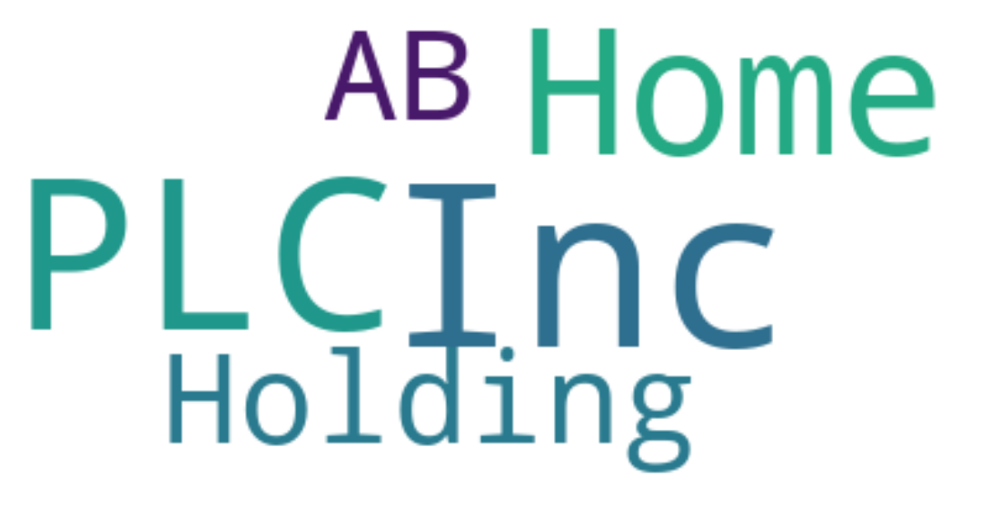

WORDCLOUD for Hotels, Resorts & Cruise Lines


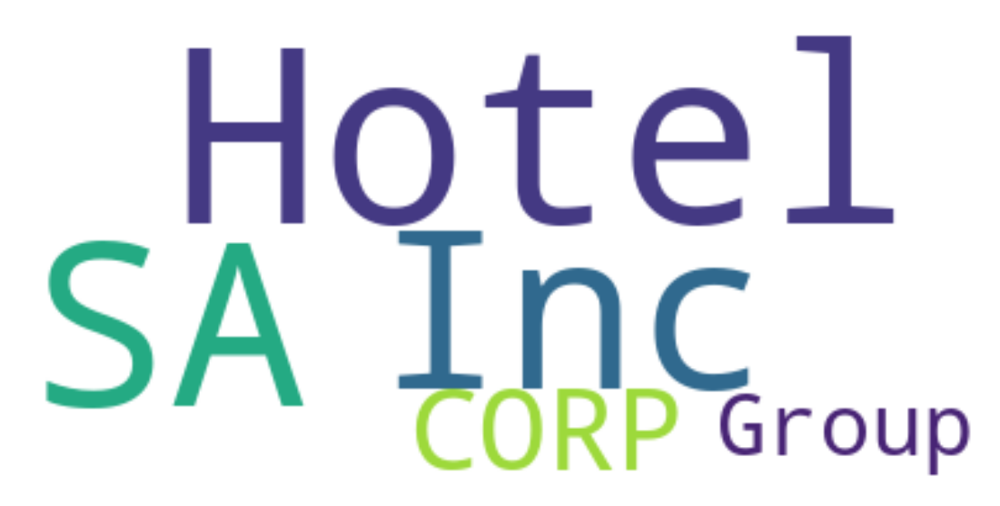

WORDCLOUD for Human Resource & Employment Services


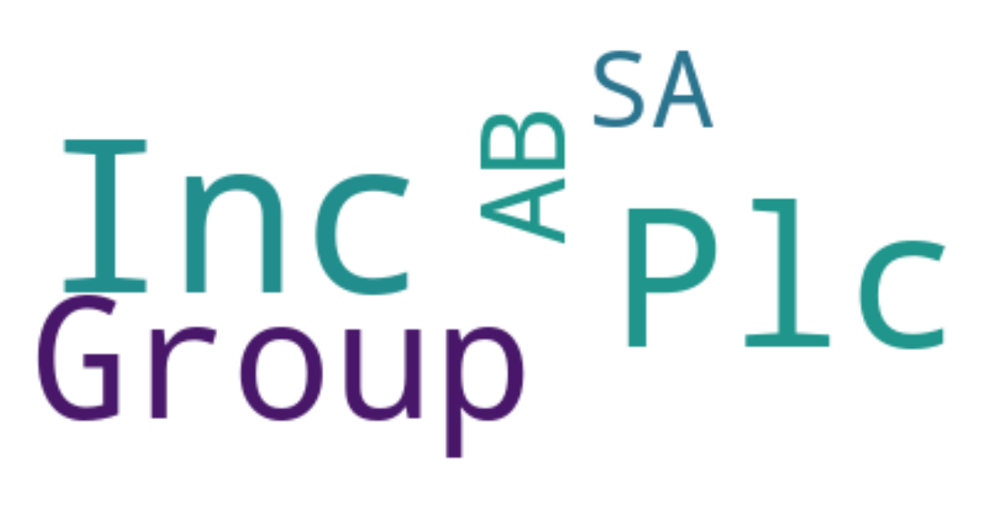

WORDCLOUD for Industrial Machinery


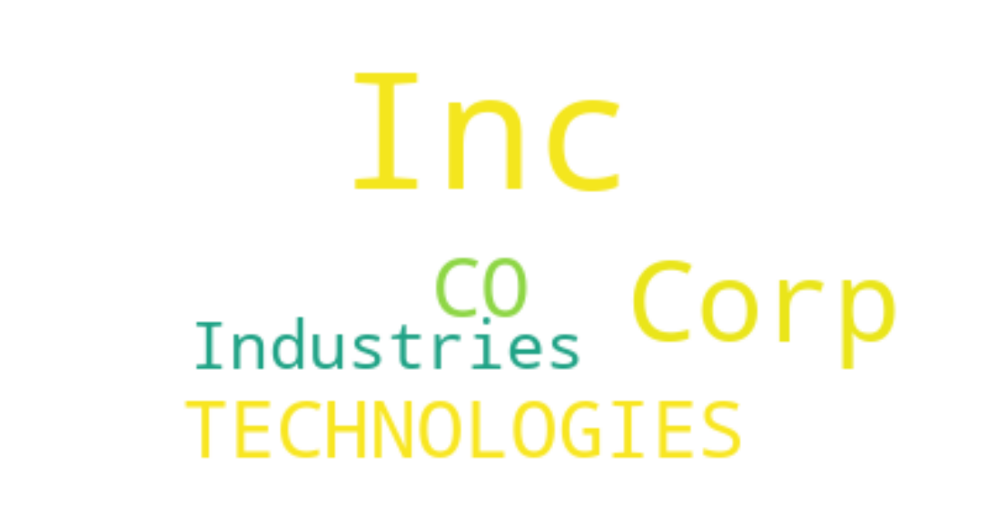

WORDCLOUD for Integrated Telecommunication Services


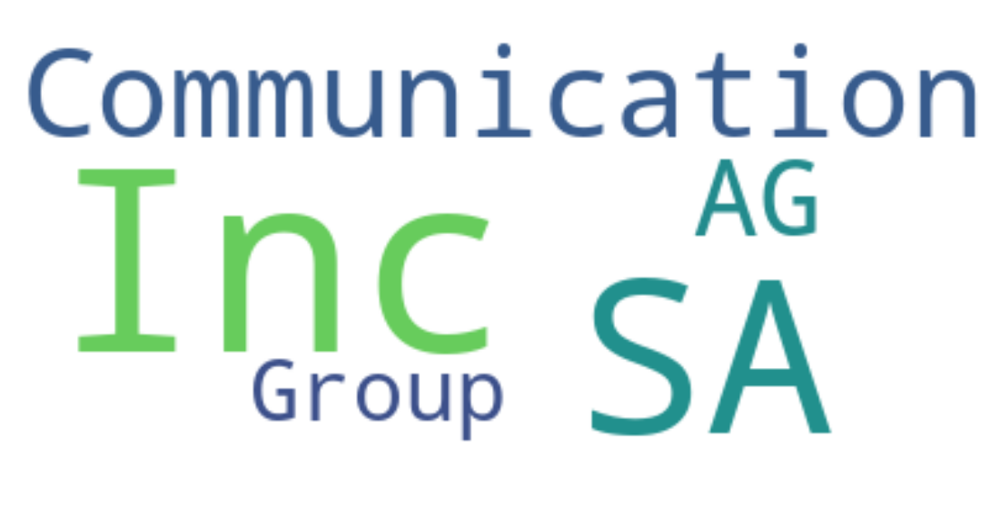

WORDCLOUD for Interactive Media & Services


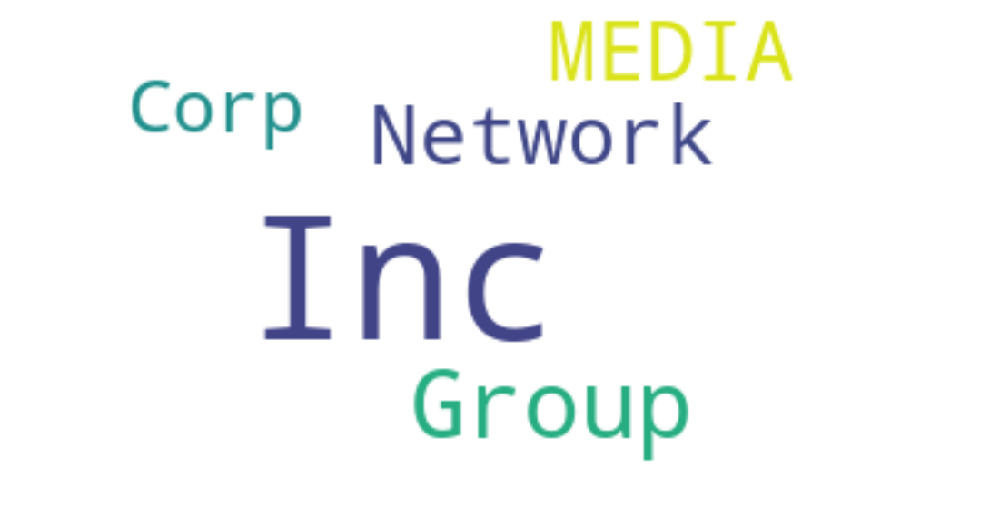

WORDCLOUD for Internet & Direct Marketing Retail


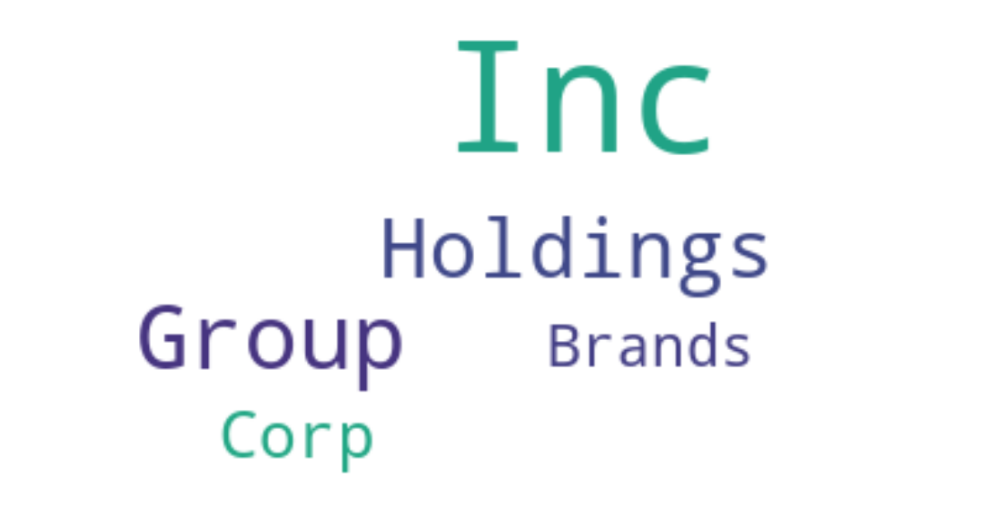

WORDCLOUD for Internet Services & Infrastructure


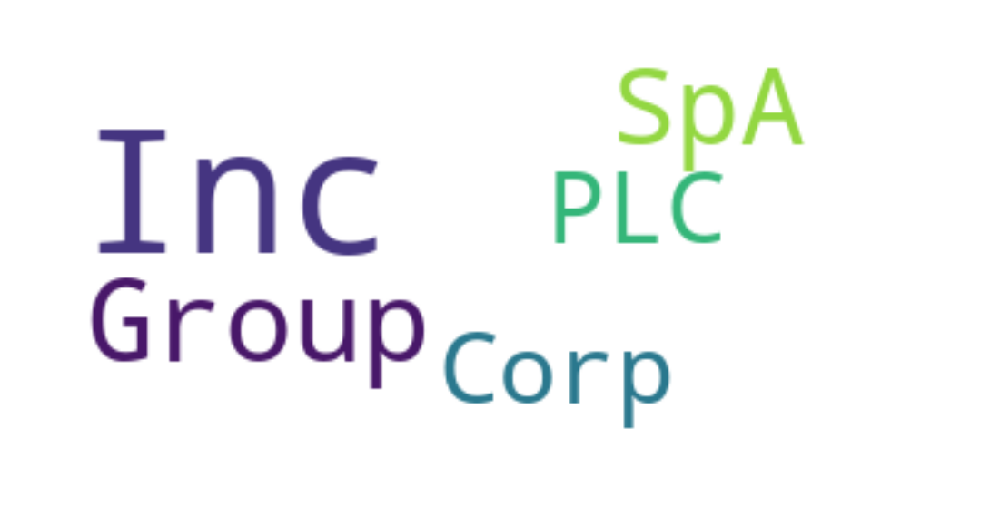

WORDCLOUD for Investment Banking & Brokerage


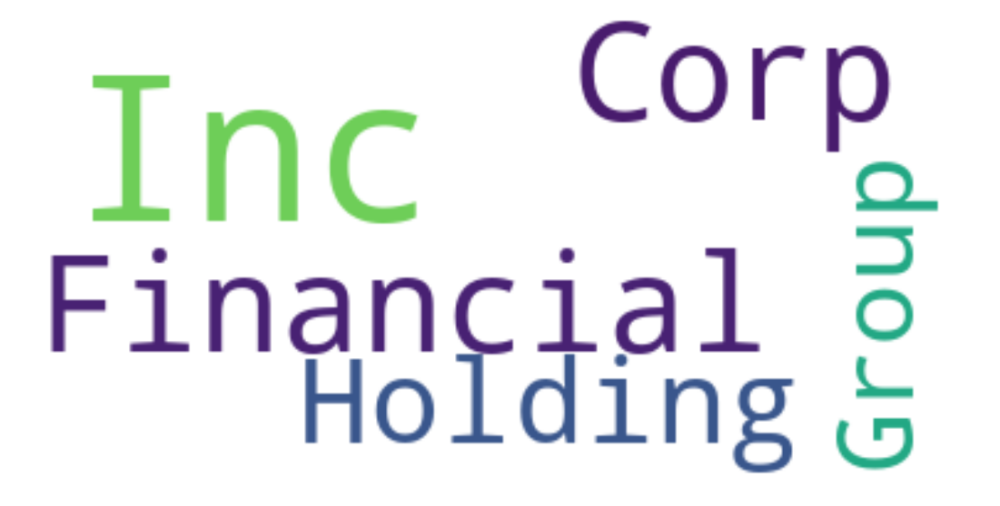

WORDCLOUD for IT Consulting & Other Services


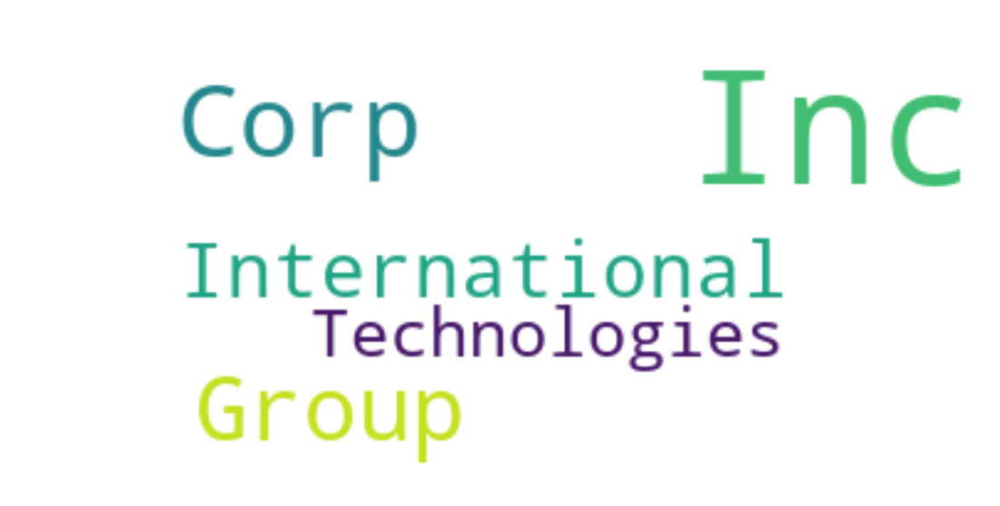

WORDCLOUD for Leisure Products


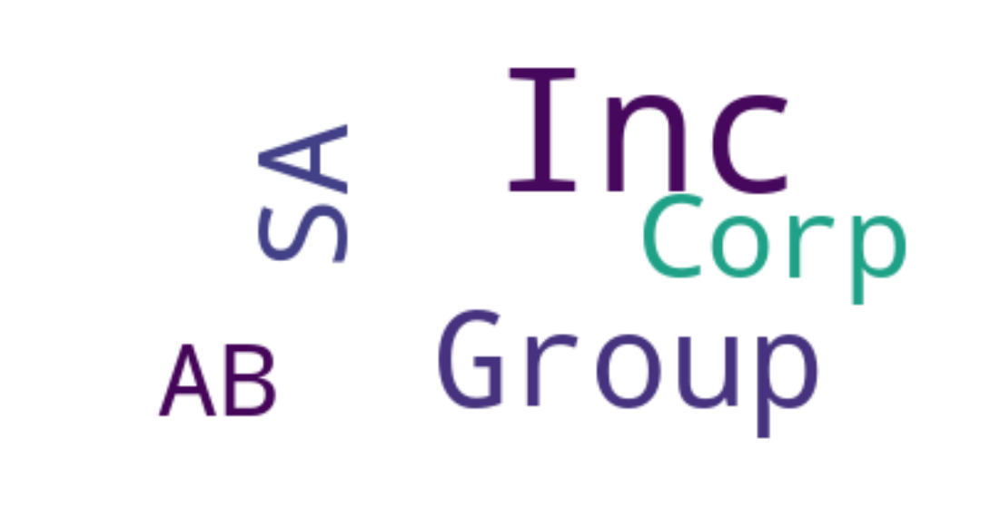

WORDCLOUD for Life Sciences Tools & Services


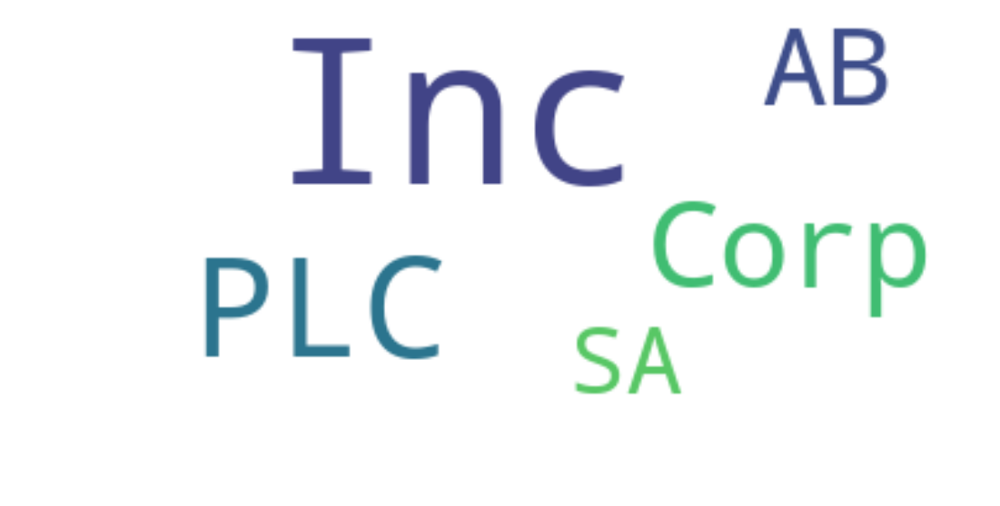

WORDCLOUD for Movies & Entertainment


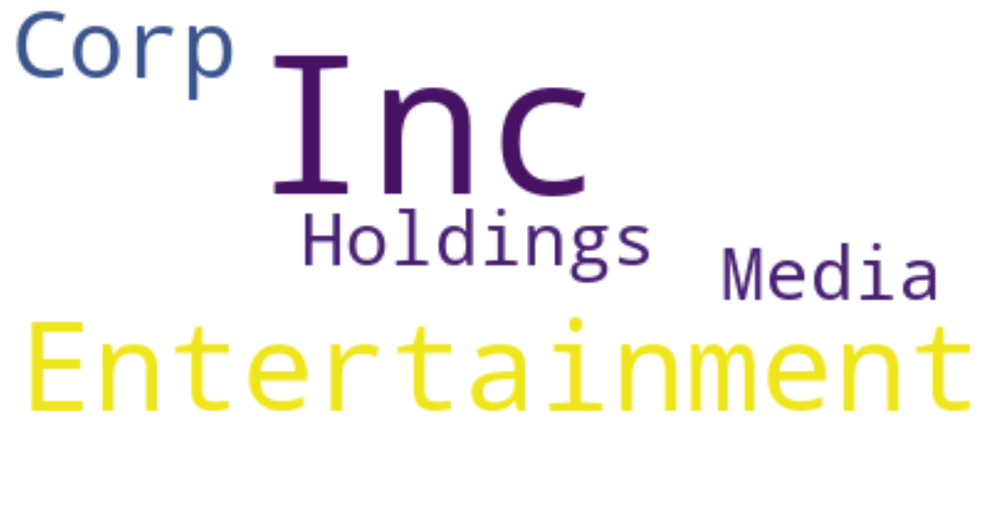

WORDCLOUD for Oil & Gas Equipment & Services


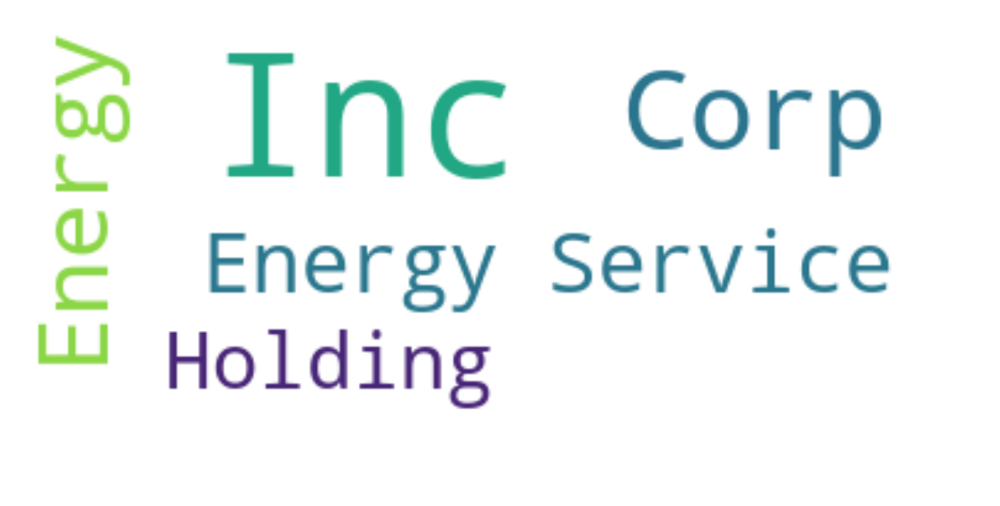

WORDCLOUD for Oil & Gas Exploration & Production


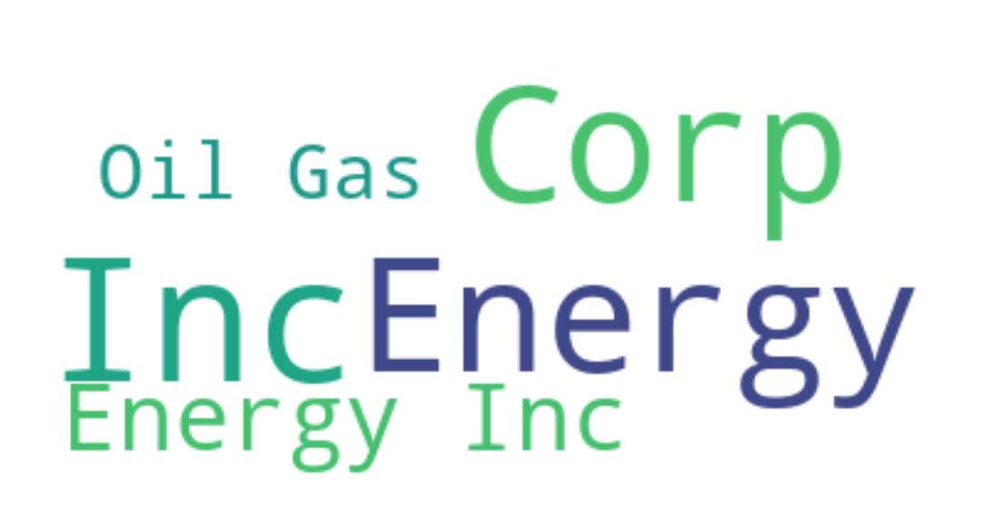

WORDCLOUD for Oil & Gas Refining & Marketing


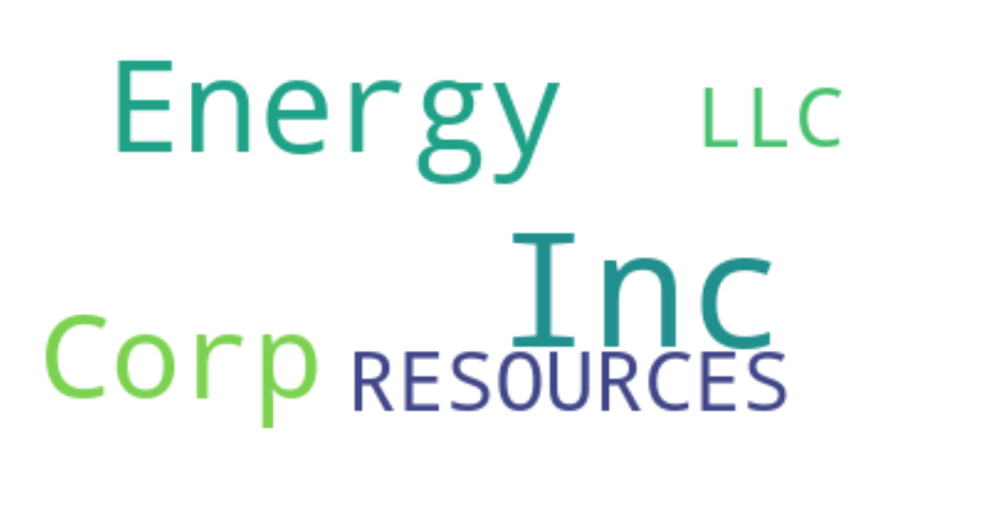

WORDCLOUD for Oil & Gas Storage & Transportation


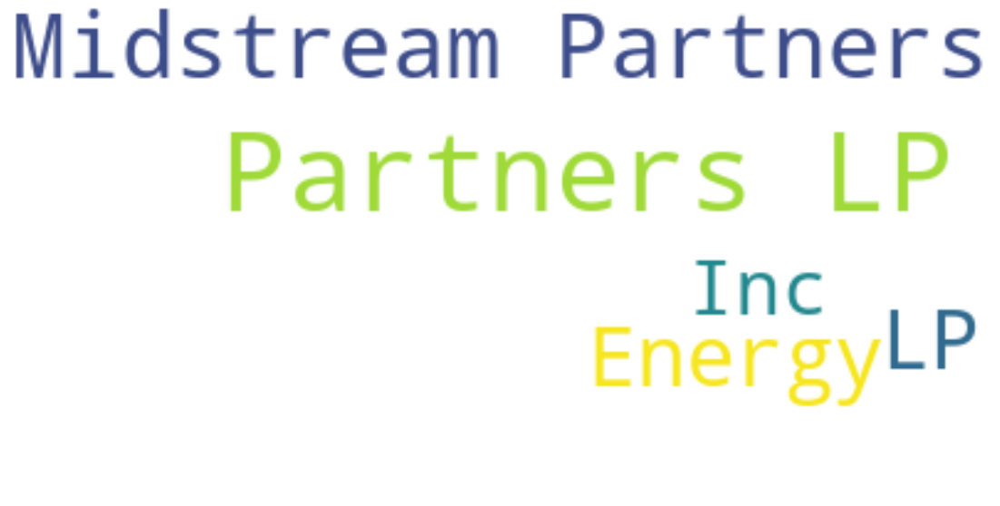

WORDCLOUD for Packaged Foods & Meats


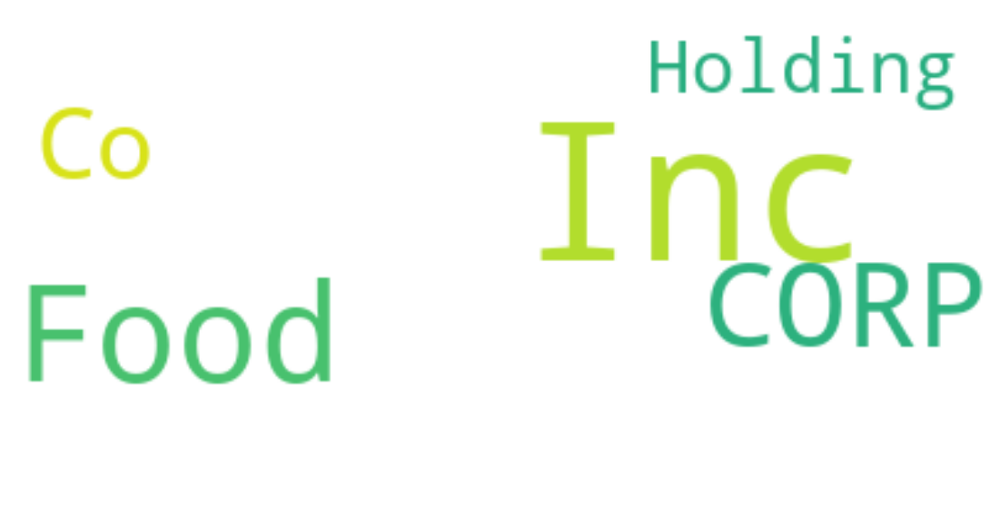

WORDCLOUD for Personal Products


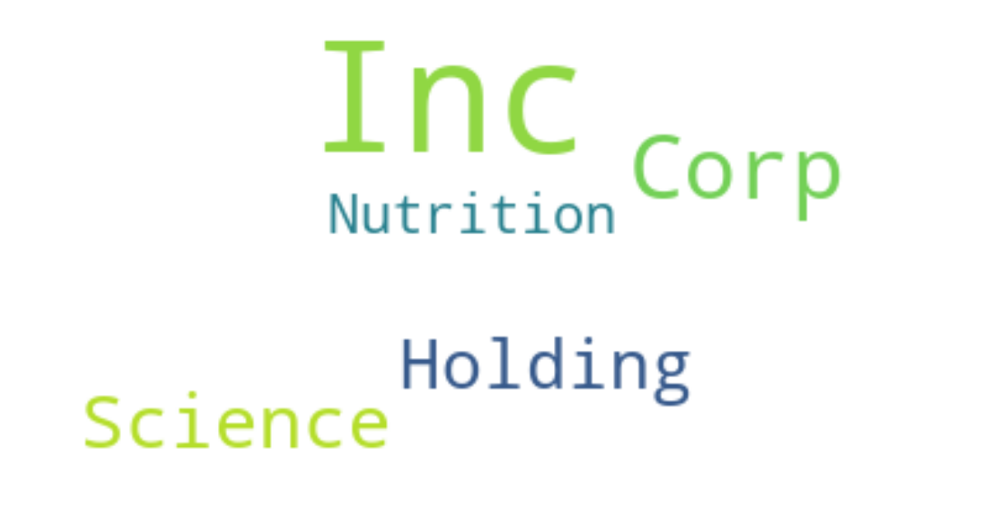

WORDCLOUD for Pharmaceuticals


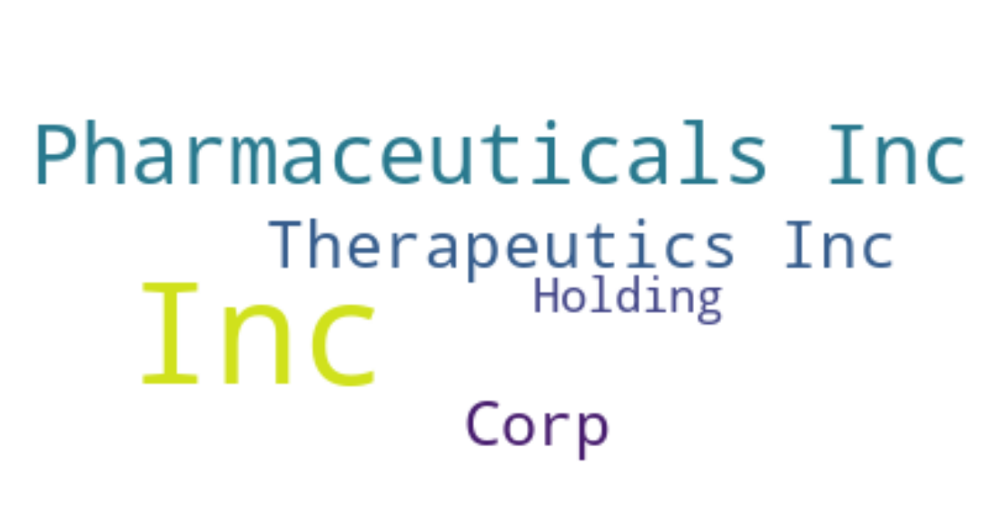

WORDCLOUD for Property & Casualty Insurance


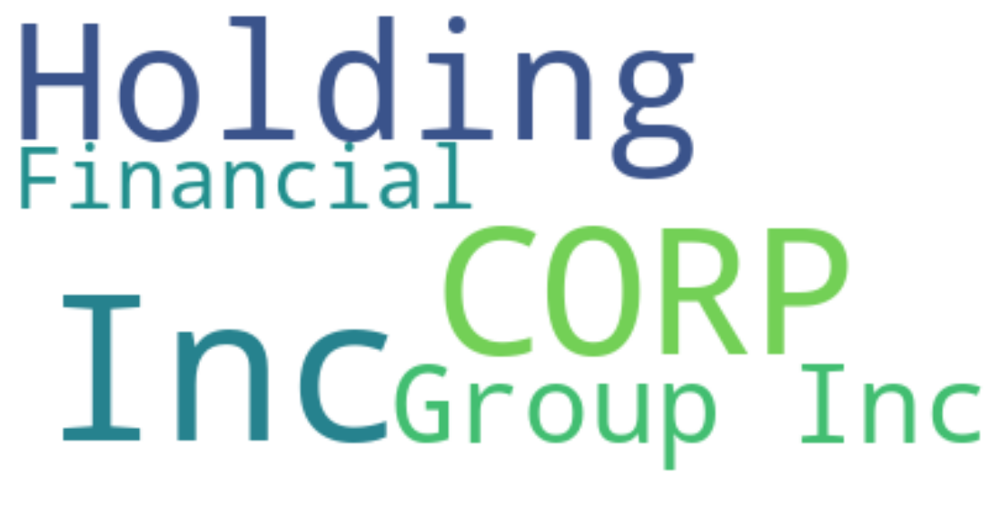

WORDCLOUD for Real Estate Operating Companies


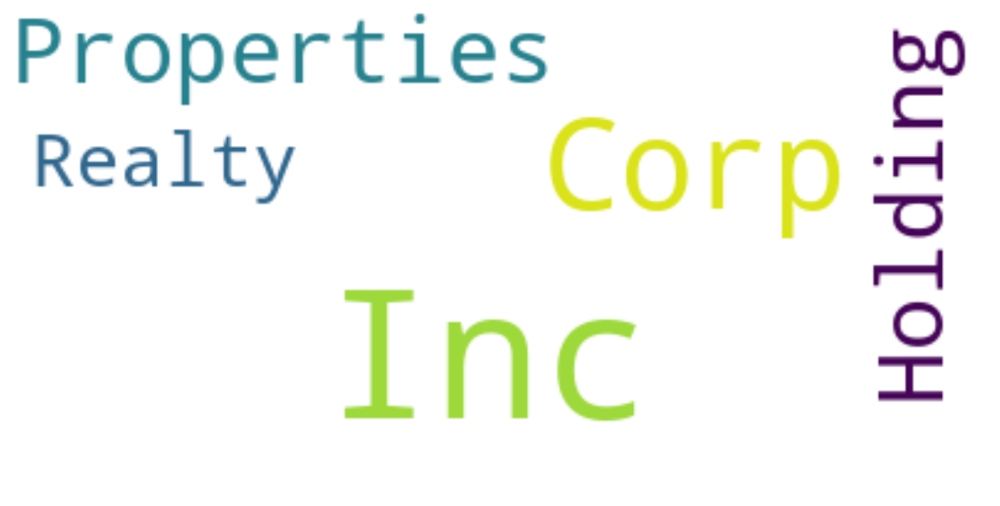

WORDCLOUD for Regional Banks


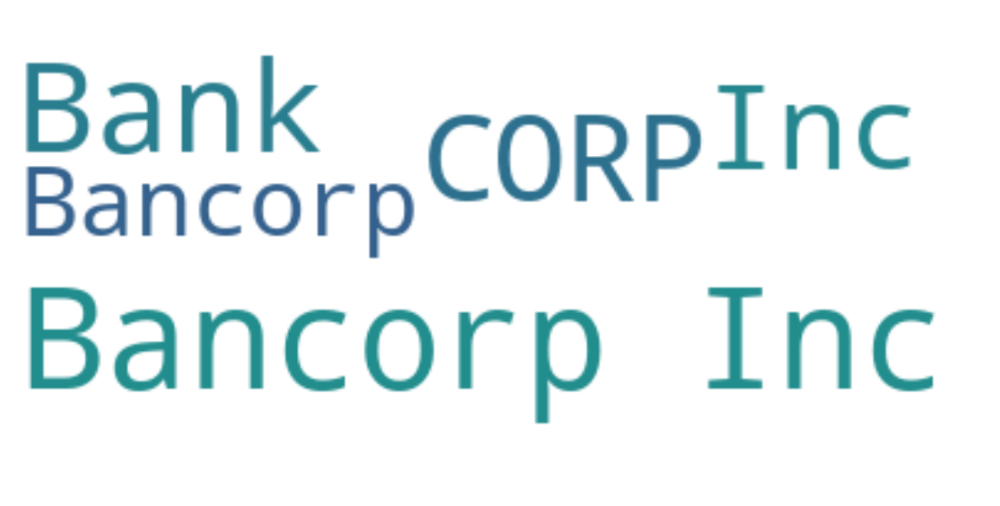

WORDCLOUD for Research & Consulting Services


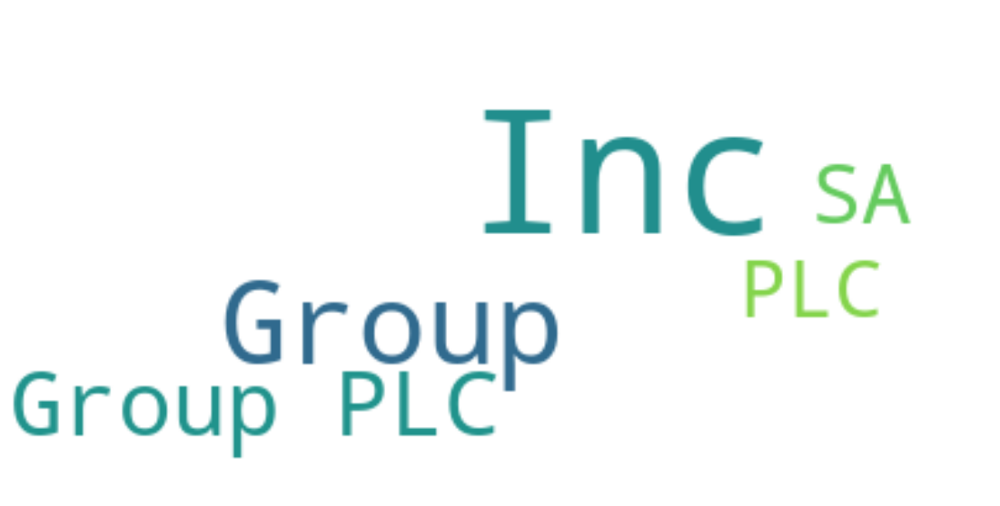

WORDCLOUD for Restaurants


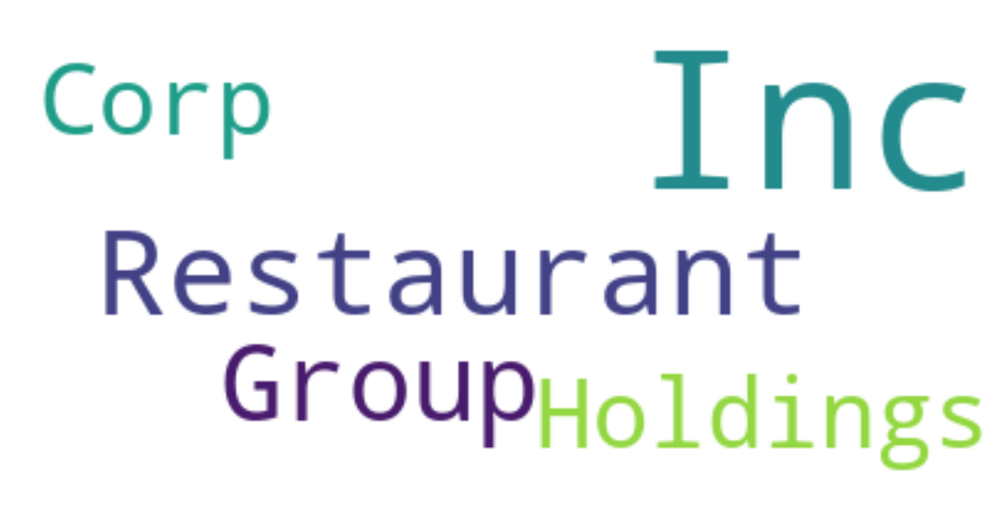

WORDCLOUD for Semiconductors


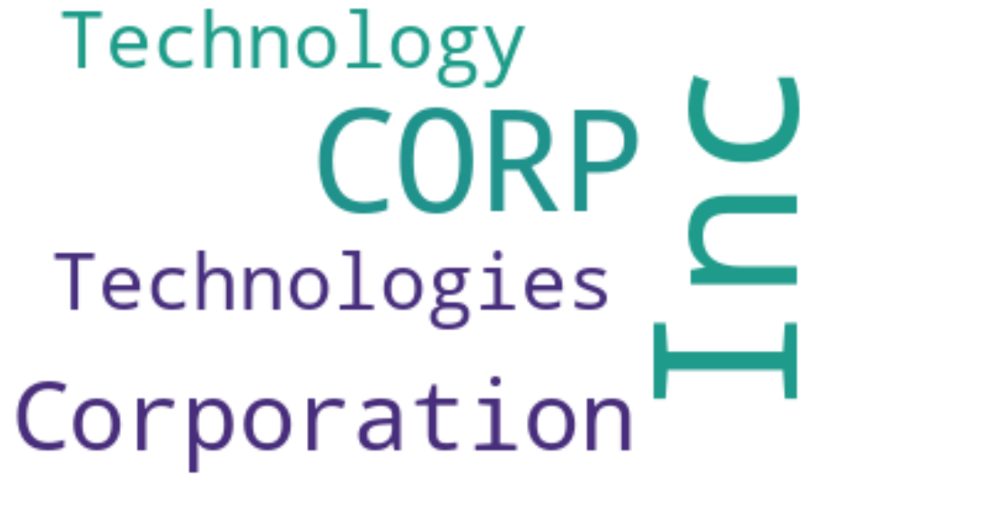

WORDCLOUD for Specialty Chemicals


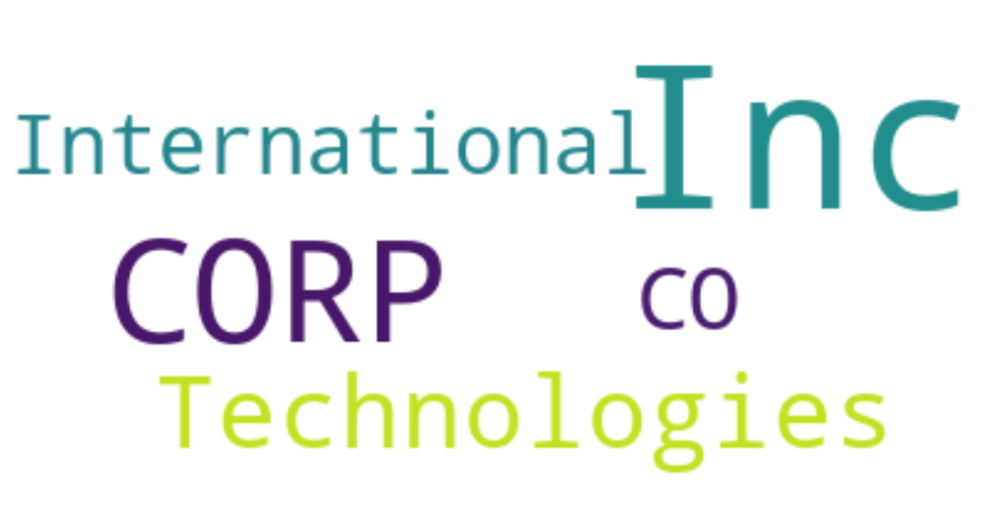

WORDCLOUD for Specialty Stores


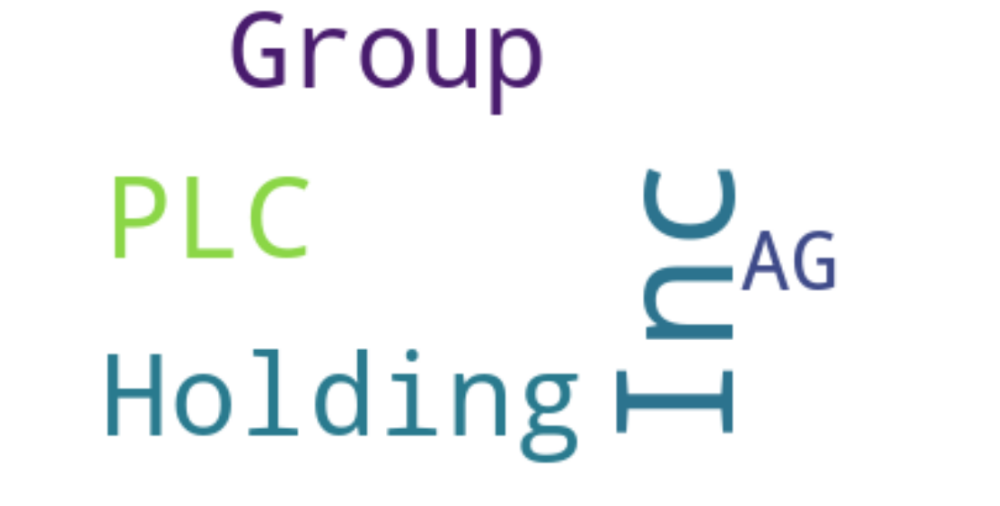

WORDCLOUD for Steel


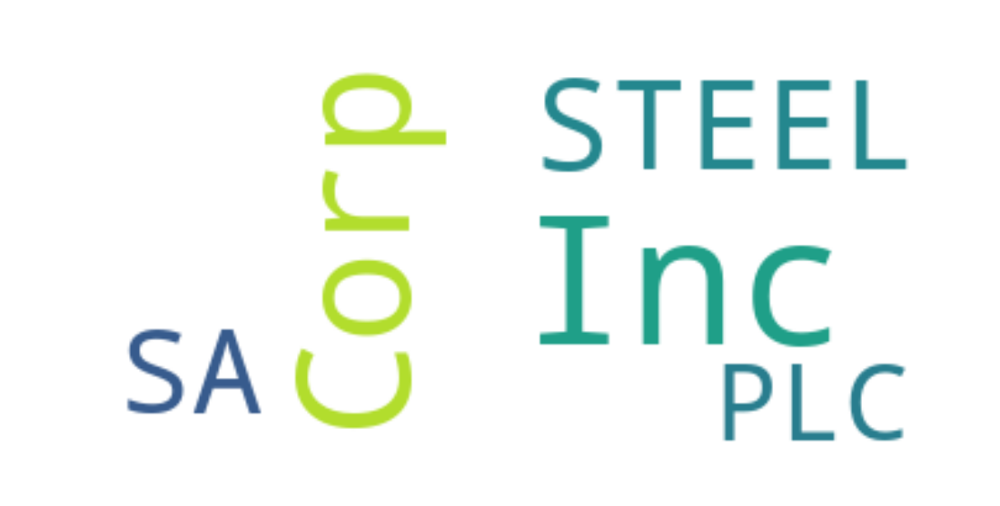

WORDCLOUD for Systems Software


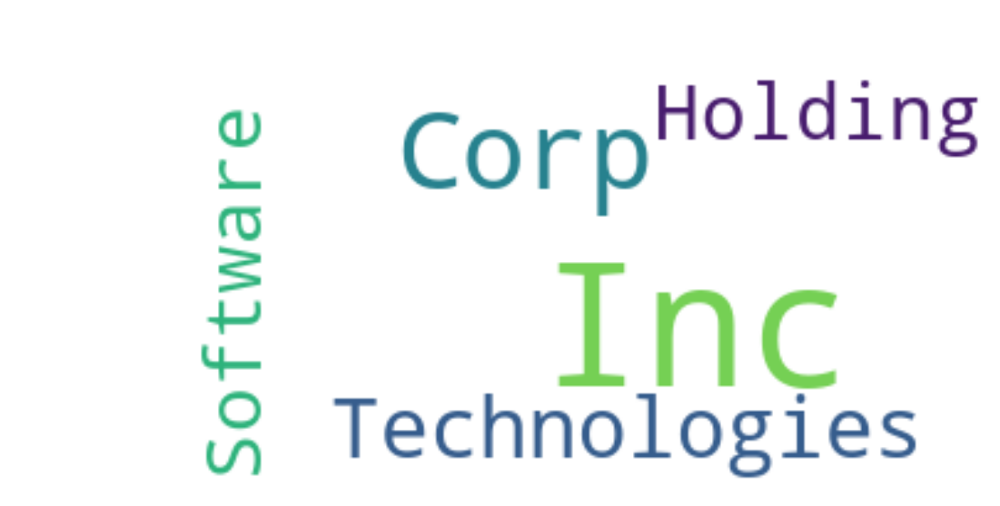

WORDCLOUD for Technology Distributors


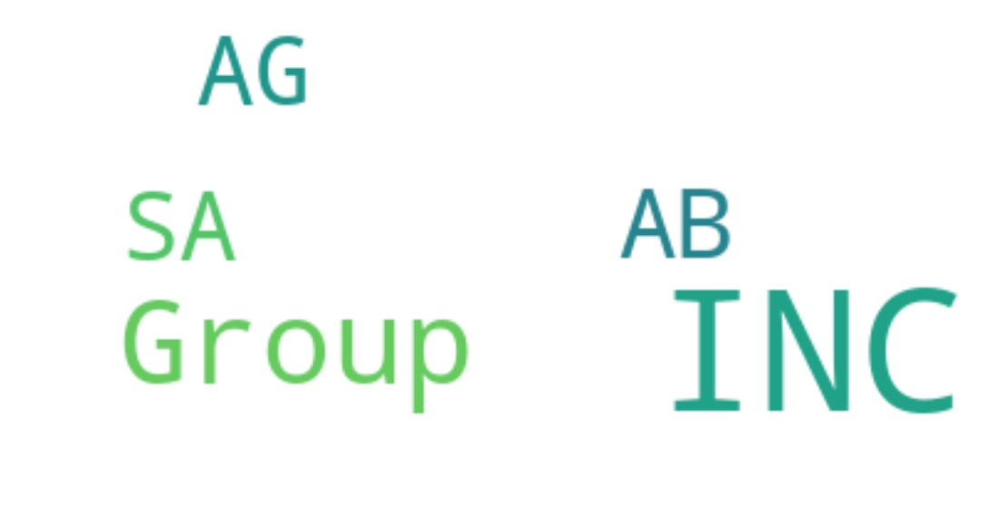

WORDCLOUD for Technology Hardware, Storage & Peripherals


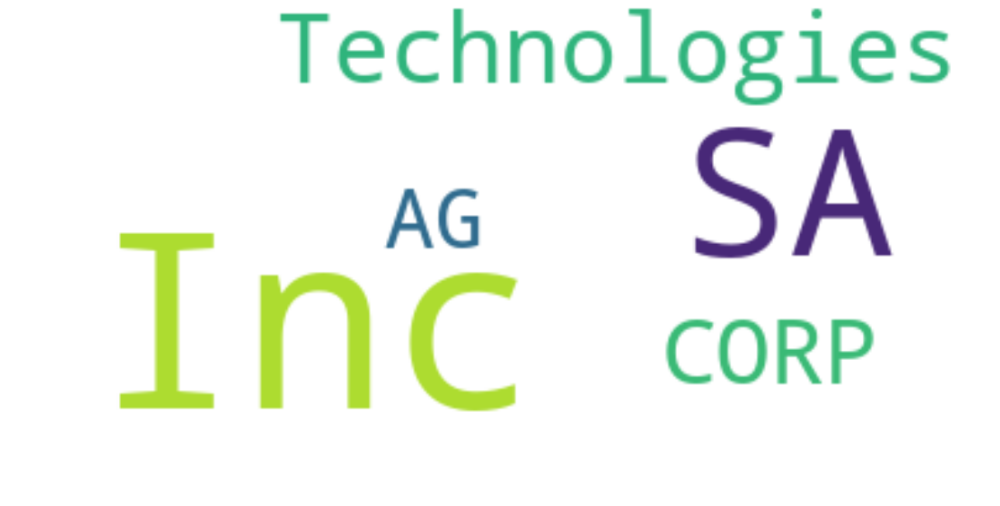

WORDCLOUD for Thrifts & Mortgage Finance


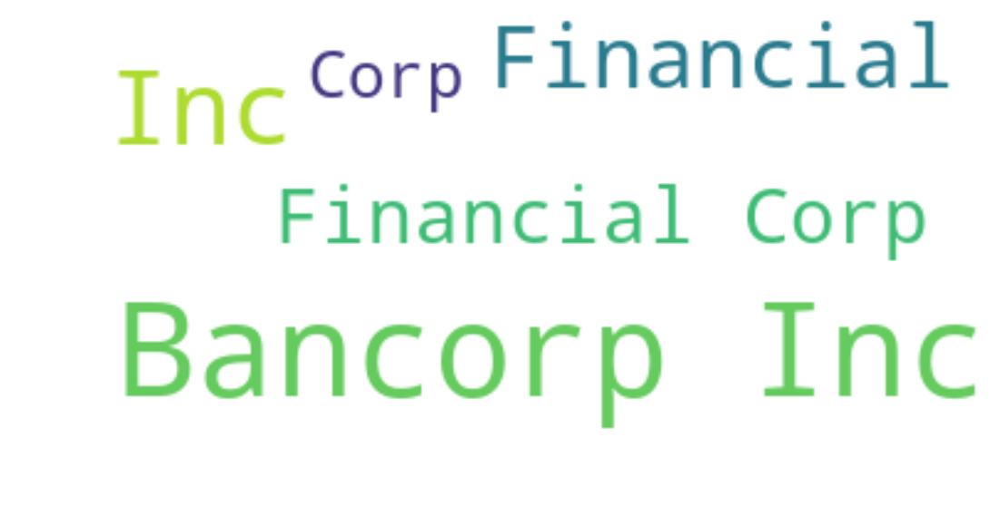

WORDCLOUD for Trading Companies & Distributors


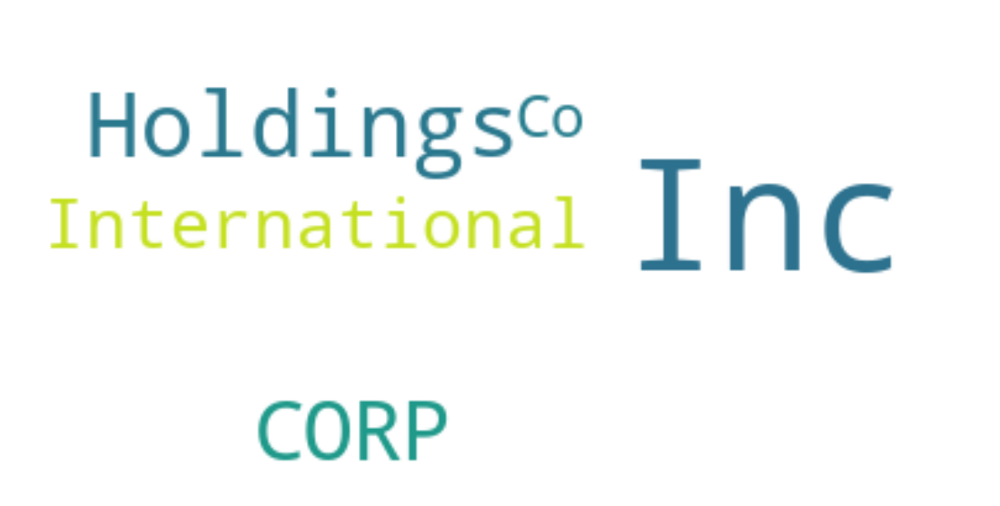

In [12]:
## WordCloud with "Company Name"

for tag in tags:
    print("WORDCLOUD for", tag)
    mask_df = df[df["Industry Classification Tag"]==tag]["Company Name"].values
    text = " ".join(mask_df)
    # Generate a word cloud image
    wordcloud = WordCloud(stopwords=stopwords, max_words=5, background_color="white").generate(text)
    # Display the generated image
    plt.figure(figsize=(20,10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()
    print("="*100)

## Baseline Model with Bag of Words (BOW) with Weighted F-1 score and Mean AUC Score as evaluaton metrics  

In [13]:
## split into features and labels
X, y = df[["Business Description"]], df["Industry Classification Tag"]
# y = pd.get_dummies(y)

## split into train & validation
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y) 

In [14]:
# both unigram & bigram with stopwords
vectorizer = CountVectorizer(stop_words=stopwords, ngram_range=(1,2))

# vectorize data
X_train_vec = vectorizer.fit_transform(X_train["Business Description"])
X_test_vec = vectorizer.transform(X_test["Business Description"])

# MNB CLASSIFICATION
mnb = MultinomialNB()
mnb.fit(X_train_vec,y_train)
mnb_prediction = mnb.predict(X_test_vec)

Confusion Matrix


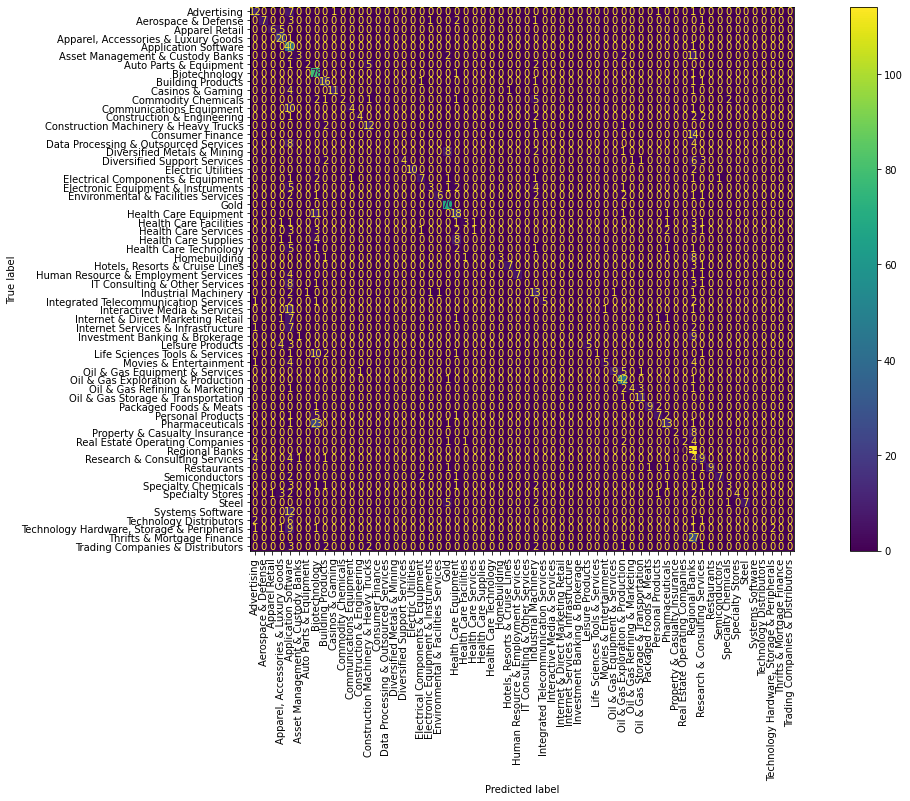

In [15]:
print("Confusion Matrix")
print("="*100)
fig = plt.figure(figsize=(20,10))
ax = fig.add_subplot(1,1,1)
plot_confusion_matrix(mnb, X_test_vec, y_test.values, xticks_rotation="vertical", ax=ax)
plt.show()

In [16]:
## Class-wise F-1 score
print("Class-wise F-1 score is", f1_score(mnb_prediction, y_test.values, average=None))

## Weighted F-1 score
print("Weighted F-1 score is", f1_score(mnb_prediction, y_test.values, average="weighted"))

Class-wise F-1 score is [0.54545455 0.63636364 0.66666667 0.70175439 0.34934498 0.24
 0.30769231 0.69333333 0.66666667 0.75862069 0.25       0.4
 0.5        0.66666667 0.         0.         0.         0.38095238
 0.90909091 0.53846154 0.28571429 0.54545455 0.86956522 0.49315068
 0.35294118 0.11111111 0.         0.         0.375      0.73684211
 0.7        0.         0.42622951 0.625      0.         0.
 0.         0.         0.58823529 0.11764706 0.5        0.69230769
 0.8        0.5        0.78571429 0.81818182 0.5        0.41935484
 0.33333333 0.33333333 0.62125341 0.36       0.81818182 0.66666667
 0.31578947 0.47058824 0.63636364 0.         0.         0.23529412
 0.         0.        ]
Weighted F-1 score is 0.5918539065075717


In [60]:
# creating instance of one-hot-encoder
enc = OneHotEncoder(handle_unknown='ignore')
y_test_ohe = enc.fit_transform(y_test.values.reshape(-1,1)).toarray()
y_pred_ohe = enc.transform(mnb_prediction.reshape(-1,1)).toarray()

# calculating ROC-AUC
print("AUC score is", np.mean(roc_auc_score(y_test_ohe, y_pred_ohe, multi_class="ovr", average=None)))

AUC score is 0.6865459598411916


## Classification with RoBERTa model

In [18]:
# !pip install simpletransformers

train_df = pd.concat([X_train, y_train], axis=1)
eval_df = pd.concat([X_test, y_test], axis=1)

encoder = LabelEncoder()
train_df["Industry Classification Tag"] = encoder.fit_transform(train_df[["Industry Classification Tag"]])
eval_df["Industry Classification Tag"] = encoder.transform(eval_df[["Industry Classification Tag"]])

     |████████████████████████████████| 194kB 9.4MB/s 
     |████████████████████████████████| 757kB 28.8MB/s 
     |████████████████████████████████| 204kB 40.7MB/s 
     |████████████████████████████████| 3.0MB 50.8MB/s 
     |████████████████████████████████| 1.1MB 59.0MB/s 
     |████████████████████████████████| 890kB 53.8MB/s 
  Created wheel for seqeval: filename=seqeval-0.0.12-cp36-none-any.whl size=7424 sha256=17764a114e10e19611c6c082d0a576c243098f8d7d44cee98987250f7695727d
  Stored in directory: /root/.cache/pip/wheels/4f/32/0a/df3b340a82583566975377d65e724895b3fad101a3fb729f68
  Created wheel for sacremoses: filename=sacremoses-0.0.43-cp36-none-any.whl size=893260 sha256=4ec345df6342c41ea7a9f7a61b41393e5e0c7de8fbada9ea45d49172d6c2e789
  Stored in directory: /root/.cache/pip/wheels/29/3c/fd/7ce5c3f0666dab31a50123635e6fb5e19ceb42ce38d4e58f45
Successfully built seqeval sacremoses
ERROR: transformers 3.0.0 has requirement tokenizers==0.8.0-rc4, but you'll have tokenizers 0.8.0 w

In [63]:
# Create a ClassificationModel
model = ClassificationModel('roberta', 'roberta-base', num_labels=62, 
                            args={'learning_rate':2e-5, 'num_train_epochs': 20, 'reprocess_input_data': True, 'overwrite_output_dir': True})

Some weights of the model checkpoint at roberta-base were not used when initializing RobertaForSequenceClassification: ['lm_head.bias', 'lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.layer_norm.weight', 'lm_head.layer_norm.bias', 'lm_head.decoder.weight']
- This IS expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPretraining model).
- This IS NOT expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out

In [22]:
!git clone https://github.com/NVIDIA/apex

Cloning into 'apex'...
remote: Enumerating objects: 38, done.
remote: Counting objects: 100% (38/38), done.
remote: Compressing objects: 100% (32/32), done.
remote: Total 7293 (delta 20), reused 19 (delta 6), pack-reused 7255
Receiving objects: 100% (7293/7293), 13.87 MiB | 11.38 MiB/s, done.
Resolving deltas: 100% (4919/4919), done.


In [23]:
%cd apex

/content/apex


In [24]:
!pip install -v --no-cache-dir --global-option="--cpp_ext" --global-option="--cuda_ext" ./

/usr/local/lib/python3.6/dist-packages/pip/_internal/commands/install.py:283: UserWarning: Disabling all use of wheels due to the use of --build-options / --global-options / --install-options.
  cmdoptions.check_install_build_global(options)
Created temporary directory: /tmp/pip-ephem-wheel-cache-w5mfol1l
Created temporary directory: /tmp/pip-req-tracker-lb6eshkp
Created requirements tracker '/tmp/pip-req-tracker-lb6eshkp'
Created temporary directory: /tmp/pip-install-ht0aymrw
Processing /content/apex
  Created temporary directory: /tmp/pip-req-build-3vt724c7
  Added file:///content/apex to build tracker '/tmp/pip-req-tracker-lb6eshkp'
    Running setup.py (path:/tmp/pip-req-build-3vt724c7/setup.py) egg_info for package from file:///content/apex
    Running command python setup.py egg_info


    torch.__version__  = 1.5.1+cu101


    running egg_info
    creating /tmp/pip-req-build-3vt724c7/pip-egg-info/apex.egg-info
    writing /tmp/pip-req-build-3vt724c7/pip-egg-info/apex.egg-info/PK

In [26]:
%cd ..

apex/       sample_data/
cache_dir/  Testing_Data_for_Data_Science_Case_Stduy.xlsx
outputs/    Training_Data_Set_for_Data_Science_Case_Study.xlsx
runs/


In [64]:
# Train the model
model.train_model(train_df)


Selected optimization level O1:  Insert automatic casts around Pytorch functions and Tensor methods.

Defaults for this optimization level are:
enabled                : True
opt_level              : O1
cast_model_type        : None
patch_torch_functions  : True
keep_batchnorm_fp32    : None
master_weights         : None
loss_scale             : dynamic
Processing user overrides (additional kwargs that are not None)...
After processing overrides, optimization options are:
enabled                : True
opt_level              : O1
cast_model_type        : None
patch_torch_functions  : True
keep_batchnorm_fp32    : None
master_weights         : None
loss_scale             : dynamic


Running loss: 4.000631Gradient overflow.  Skipping step, loss scaler 0 reducing loss scale to 32768.0
Running loss: 4.196646Gradient overflow.  Skipping step, loss scaler 0 reducing loss scale to 16384.0
Running loss: 2.021736


Running loss: 2.567857Gradient overflow.  Skipping step, loss scaler 0 reducing loss scale to 8192.0
Running loss: 4.109975Gradient overflow.  Skipping step, loss scaler 0 reducing loss scale to 4096.0



Running loss: 0.222700


Running loss: 0.457236


Running loss: 0.044391


Running loss: 0.013006


Running loss: 0.574964Gradient overflow.  Skipping step, loss scaler 0 reducing loss scale to 4096.0
Running loss: 4.870854


Running loss: 0.004045


Running loss: 0.008855


Running loss: 0.202128Gradient overflow.  Skipping step, loss scaler 0 reducing loss scale to 4096.0
Running loss: 0.002520


Running loss: 0.002063


Running loss: 0.002192


Running loss: 0.512439Gradient overflow.  Skipping step, loss scaler 0 reducing loss scale to 2048.0
Running loss: 0.001678


Running loss: 0.001101


Running loss: 0.001331


Running loss: 0.000653


Running loss: 0.001157


Running loss: 0.000145


Running loss: 0.000068


Running loss: 0.159654Gradient overflow.  Skipping step, loss scaler 0 reducing loss scale to 4096.0
Running loss: 0.000186



In [65]:
def f1_multiclass(labels, preds):
    return f1_score(labels, preds, average='weighted')
    
result, model_outputs, wrong_predictions = model.eval_model(eval_df, f1=f1_multiclass, acc=accuracy_score)

In [70]:
print("Validation Weighted F-1 score:", result["f1"])

Validation Weighted F-1 score: 0.7434071280520761


In [71]:
eval_classes_ohe = pd.get_dummies(np.argmax(model_outputs, axis=1))
test_classes_ohe = pd.get_dummies(eval_df["Industry Classification Tag"])
## Mean AUC score
print("AUC score is", np.mean(roc_auc_score(test_classes_ohe, eval_classes_ohe, multi_class="ovr", average=None)))

AUC score is 0.8466568827037043


In [74]:
## Predict on test data


test_df = pd.read_excel("Testing_Data_for_Data_Science_Case_Stduy.xlsx")
predictions, raw_outputs = model.predict(test_df["Business Description"])

# inverse transform
test_predictions = pd.Series(encoder.inverse_transform(predictions))
# save as CSV file
test_predictions.to_csv("Test Predictions.csv", index=False)